In [1]:
#importing libraries

import nibabel as nib
from glob import glob
import matplotlib.pylab as plt
import numpy as np
import os
from tqdm import tqdm
import torch
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
from sklearn.model_selection import train_test_split


In [2]:
!pip install pydicom -q
import pydicom as dicom


In [3]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [4]:
#loading one example

path = "/content/drive/MyDrive/lungs/imagesTr/1.3.6.1.4.1.14519.5.2.1.6279.6001.105756658031515062000744821260_0000.nii.gz"

In [5]:
lung_image = nib.load(path).get_fdata() #load data from the path
lung_image.shape

(512, 512, 121)

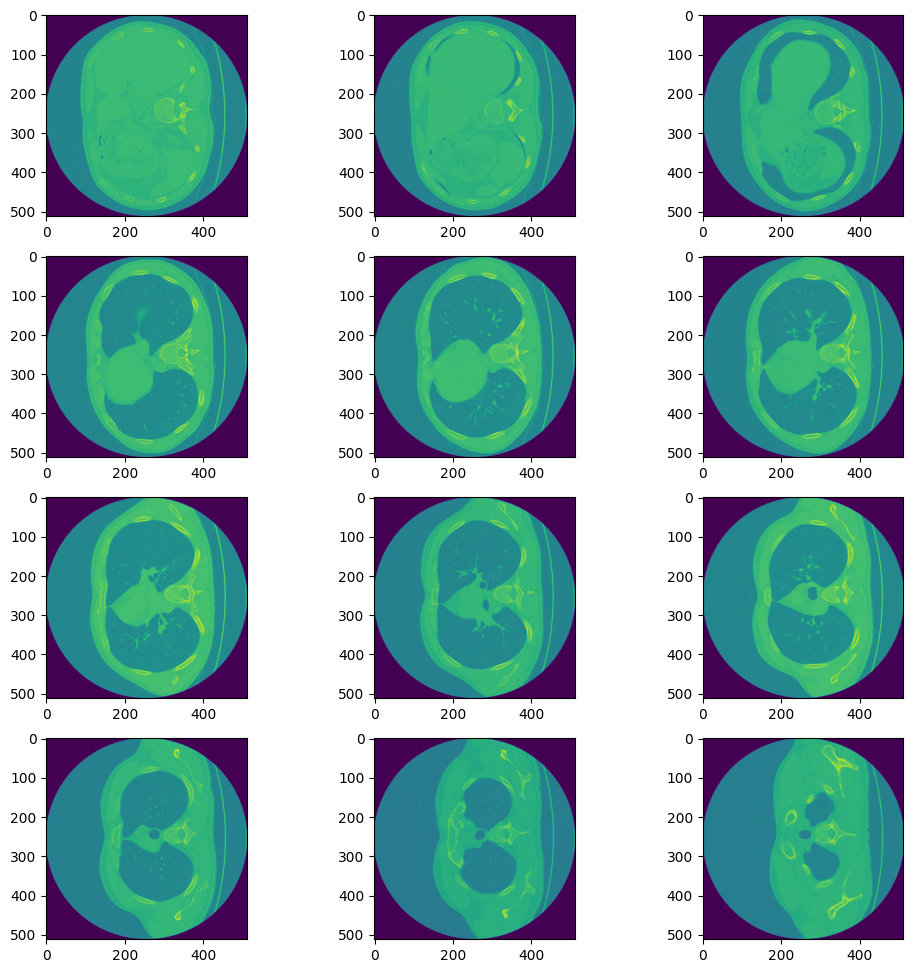

In [6]:
#plotting images at a distance of indexes of 10 to get a clear perspective
plt.style.use('default')
fig, axes = plt.subplots(4, 3, figsize=(12,12))
for i, ax in enumerate(axes.reshape(-1)):
    ax.imshow(lung_image[:, :, i*10])
plt.show()

In [7]:
path_label = "/content/drive/MyDrive/lungs/labelsTr/1.3.6.1.4.1.14519.5.2.1.6279.6001.105756658031515062000744821260.nii.gz"

In [8]:
img_label = nib.load(path_label).get_fdata() #loading labels
img_label.shape

(512, 512, 121)

In [9]:
folder_path = "/content/drive/MyDrive/lungs/labelsTr/"

files = [f for f in os.listdir(folder_path) if f.endswith('.nii.gz')] # get all the file names in the dataset
print(files)


['1.3.6.1.4.1.14519.5.2.1.6279.6001.188376349804761988217597754952.nii.gz', '1.3.6.1.4.1.14519.5.2.1.6279.6001.249530219848512542668813996730.nii.gz', '1.3.6.1.4.1.14519.5.2.1.6279.6001.111172165674661221381920536987.nii.gz', '1.3.6.1.4.1.14519.5.2.1.6279.6001.293757615532132808762625441831.nii.gz', '1.3.6.1.4.1.14519.5.2.1.6279.6001.137763212752154081977261297097.nii.gz', '1.3.6.1.4.1.14519.5.2.1.6279.6001.141069661700670042960678408762.nii.gz', '1.3.6.1.4.1.14519.5.2.1.6279.6001.303421828981831854739626597495.nii.gz', '1.3.6.1.4.1.14519.5.2.1.6279.6001.134996872583497382954024478441.nii.gz', '1.3.6.1.4.1.14519.5.2.1.6279.6001.219909753224298157409438012179.nii.gz', '1.3.6.1.4.1.14519.5.2.1.6279.6001.227962600322799211676960828223.nii.gz', '1.3.6.1.4.1.14519.5.2.1.6279.6001.109002525524522225658609808059.nii.gz', '1.3.6.1.4.1.14519.5.2.1.6279.6001.216882370221919561230873289517.nii.gz', '1.3.6.1.4.1.14519.5.2.1.6279.6001.139258777898746693365877042411.nii.gz', '1.3.6.1.4.1.14519.5.2.1

In [10]:
#creating a dataset form 0th to 1st file.

for file in tqdm(files[:1]):
    file_path = os.path.join(folder_path, file)
    a, b = path_label.split('.nii.gz')[0], path_label.split('.nii.gz')[1]
    path_label_new = a + "_0000.nii.gz"
    print(path_label, path_label_new)
    img_label = np.concatenate((img_label, nib.load(path_label).get_fdata()), axis=2)
    lung_image = np.concatenate((lung_image, nib.load(path_label).get_fdata()), axis=2)


  0%|          | 0/1 [00:00<?, ?it/s]

/content/drive/MyDrive/lungs/labelsTr/1.3.6.1.4.1.14519.5.2.1.6279.6001.105756658031515062000744821260.nii.gz /content/drive/MyDrive/lungs/labelsTr/1.3.6.1.4.1.14519.5.2.1.6279.6001.105756658031515062000744821260_0000.nii.gz


100%|██████████| 1/1 [00:01<00:00,  1.07s/it]


In [11]:
img_label.shape, lung_image.shape

((512, 512, 242), (512, 512, 242))

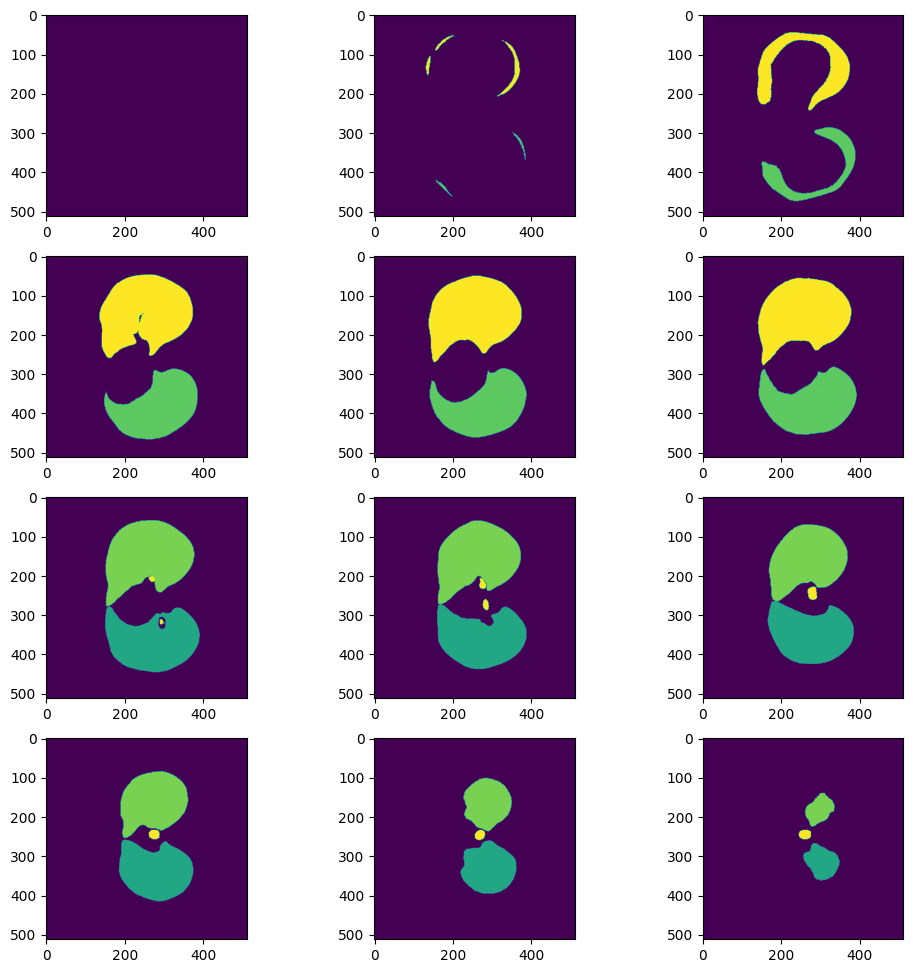

In [12]:
# plotting masks at a distance of indexes of 10
plt.style.use('default')
fig, axes = plt.subplots(4, 3, figsize=(12,12))
for i, ax in enumerate(axes.reshape(-1)):
    ax.imshow(img_label[:,:,i*10])
plt.show()


In [13]:
img_label[:,:,10]

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [14]:
np.unique(img_label[:,:,50]), np.unique(img_label[:,:,60]) # no of unique labels in label image eg  left lung (labelled 3), right lung (labelled 4), and trachea (labelled 5).

(array([0., 3., 4.]), array([0., 3., 4., 5.]))

In [15]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset

# Step 1: Eliminate the trachea label (label 5)
img_label[img_label == 5] = 0  # Set trachea label to 0

# Step 2: merge left and right lung masks into a single label
lung_mask = np.logical_or(img_label == 3, img_label == 4)

print("lung_mask : ", lung_mask.shape)
print("lung_image : ", lung_image.shape)

# Step 3: Prepare data for training
X_train_temp = torch.from_numpy(lung_image).float()  # Original MRI lung images
y_train_temp = torch.from_numpy(lung_mask).float()  # Lung masks


lung_mask :  (512, 512, 242)
lung_image :  (512, 512, 242)


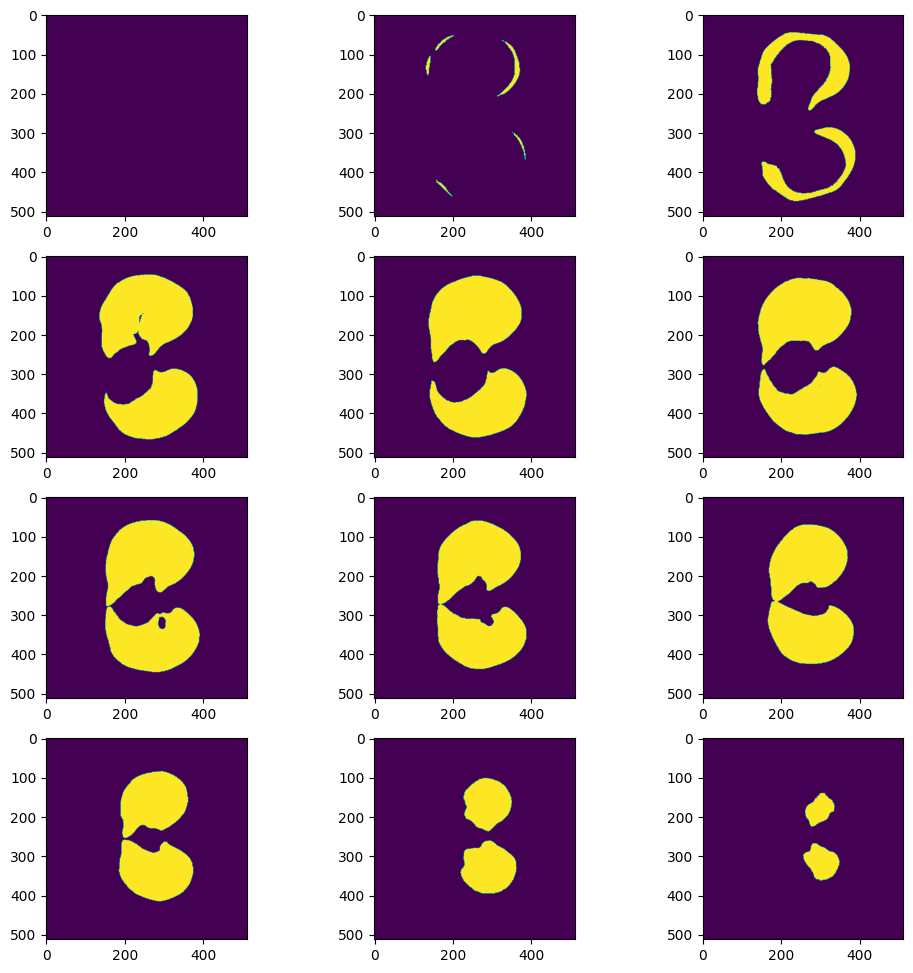

In [16]:
# merged mask
plt.style.use('default')
fig, axes = plt.subplots(4, 3, figsize=(12,12))
for i, ax in enumerate(axes.reshape(-1)):
    ax.imshow(y_train_temp[:,:,i*10])
plt.show()


In [17]:
# permuting to make the shape from (height, width, no_of_images) to (no_of_images, height, width)

X_train = X_train_temp.permute(2, 0, 1)
y_train = y_train_temp.permute(2, 0, 1)


In [18]:
y_train_temp[70].unique() # now no of unique labels are 2

# 0 - no lung
# 1 - lung mask

tensor([0., 1.])

In [19]:
import torch
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
from torchvision import transforms


transform = transforms.Compose([
        transforms.Resize((256, 256)),
        transforms.Normalize((0.5,), (0.5,))])
# creating dataloader

class LungDataset(Dataset):
    def __init__(self, X, y):
        super(LungDataset, self).__init__()
        self.X = X
        self.y = y

    def __len__(self):
        return len(self.X)

    def __getitem__(self, idx):
        input_data = self.X[idx].unsqueeze(0)
        target = self.y[idx].unsqueeze(0)
        # image = self.transform(input_data)
        # mask = self.transform(target)
        return input_data, target

lung_dataset = LungDataset(X_train, y_train)
batch_size = 4


In [20]:
folder_path_labelsTr = "/content/drive/MyDrive/lungs/labelsTr/"
folder_path_imagesTr = "/content/drive/MyDrive/lungs/imagesTr/"

# dice loss measures the similarity between two sets, typically the predicted segmentation mask and the ground truth mask.
# The Dice loss is particularly useful when dealing with imbalanced datasets, which is common in medical image segmentation.

class DiceLoss(torch.nn.Module):
    def __init__(self, smooth=1):
        super(DiceLoss, self).__init__()
        self.smooth = smooth

    def forward(self, pred, target):
        # Flatten the predicted and ground truth masks
        pred = pred.view(-1)
        target = target.view(-1)

        # Calculate intersection and union
        intersection = (pred * target).sum()
        union = pred.sum() + target.sum()

        # Calculate DICE loss
        dice = (2 * intersection + self.smooth) / (union + self.smooth)
        loss = 1 - dice

        return loss

loss_dice = DiceLoss() # creating object

In [21]:
import torch
import torch.nn as nn

# creating a model called small model which is basically an encode and decoder model
# encoder is used just to memorizing the useful imformation
# and then at the decoder is used retrieve back tghe encoded information

class Small_model(nn.Module):
    def __init__(self):
        super(Small_model, self).__init__()

        # Encoder
        self.encoder = nn.Sequential(
            nn.Conv2d(1, 64, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(2)
        )

        # Decoder
        self.decoder = nn.Sequential(
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.ConvTranspose2d(64, 1, kernel_size=2, stride=2)
        )

    def forward(self, x):
        x = self.encoder(x)
        x = self.decoder(x)
        return x

model_small = Small_model()
model_small = model_small.to(device)
# Define loss function and optimizer
criterion = nn.BCEWithLogitsLoss() # combines a sigmoid activation function and binary cross-entropy loss
optimizer = torch.optim.Adam(model_small.parameters(), lr=0.001) # Adam is a popular optimization algorithm that adapts the learning rates for each parameter during training.


In [ ]:
# NOTE :due to limited resources i am traiing the model one by one then randomizing the dataset

model_small = model_small.to(device)
num_epochs = 2
files = [f for f in os.listdir(folder_path_labelsTr) if f.endswith('.nii.gz')] # get all the files name
prev_loss = 100 # max initialization
no_of_sets = 1 # it tells how many datasets out of 45 needs to be taken at one in one training loop
loss_lst = []
loss_lst_val = []

train_files = files[:-3] # taking first 45-3 files as training data
test_files = files[-3:] # last 3 files as testign data

for i in range(0, len(train_files), no_of_sets):
    # now run the loop once

    temp_file = train_files[i]
    label_path = os.path.join(folder_path_labelsTr, temp_file)
    a = temp_file.split('.nii.gz')
    image_path = folder_path_imagesTr + a[0] + "_0000.nii.gz"
    lung_image = nib.load(image_path).get_fdata()
    img_label = nib.load(label_path).get_fdata()

    # now run the loop once again if no_of_sets are greater than 1
    for temp_file in train_files[i+1: i+no_of_sets]:
        label_path = os.path.join(folder_path_labelsTr, temp_file)
        a = temp_file.split('.nii.gz')
        image_path = folder_path_imagesTr + a[0] + "_0000.nii.gz"
        img_label = np.concatenate((img_label, nib.load(label_path).get_fdata()), axis=2)
        lung_image = np.concatenate((lung_image, nib.load(image_path).get_fdata()), axis=2)


    img_label[img_label == 5] = 0 # removing trachea
    lung_mask = np.logical_or(img_label == 3, img_label == 4) # assigning same label to left, right lung


    lung_image_train_temp = torch.from_numpy(lung_image).float()
    lung_label_train_temp = torch.from_numpy(lung_mask).float()

    # permuting to make the shape from (height, width, no_of_images) to (no_of_images, height, width)
    lung_image_train_temp = lung_image_train_temp.permute(2, 0, 1)
    lung_label_train_temp = lung_label_train_temp.permute(2, 0, 1)

    # splitting dataset
    lung_image_train, lung_image_val, lung_label_train, lung_label_val = train_test_split(
        lung_image_train_temp, lung_label_train_temp, test_size=0.2, random_state=42)

    # creating dataset
    lung_dataset_train = LungDataset(lung_image_train, lung_label_train)
    lung_dataset_val = LungDataset(lung_image_val, lung_label_val)

    # creating dataloader
    batch_size = 4
    train_loader = DataLoader(dataset=lung_dataset_train, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(dataset=lung_dataset_val, batch_size=batch_size, shuffle=False)



    # lung_dataset = LungDataset(lung_image_train, lung_label_train)
    # batch_size = 8
    # train_loader = DataLoader(dataset=lung_dataset, batch_size=batch_size, shuffle=True)


    for epoch in tqdm(range(num_epochs)):
        total_loss = 0.0
        num_batches = 0

        for inputs, labels in (train_loader):
            optimizer.zero_grad()
            inputs = inputs.to(device)
            labels = labels.to(device)
            outputs = model_small(inputs)
            loss = criterion(outputs, labels)
            # print("outputs :", outputs.shape)
            # print("labels :", labels.shape)
            loss.backward()
            optimizer.step()
            total_loss += loss.item()
            num_batches += 1

        average_loss = total_loss / num_batches

        # Validation
        model_small.eval()  # Set the model_small to evaluation mode
        total_loss_val = 0.0
        num_batches_val = 0

        with torch.no_grad():
            for inputs_val, labels_val in val_loader:
                inputs_val = inputs_val.to(device)
                labels_val = labels_val.to(device)
                outputs_val = model_small(inputs_val)
                loss_val = criterion(outputs_val, labels_val)
                total_loss_val += loss_val.item()
                num_batches_val += 1

        average_loss_val = total_loss_val / num_batches_val

        print(f'Epoch [{epoch + 1}/{num_epochs}], '
              f'Training Loss: {average_loss:.4f}, Validation Loss: {average_loss_val:.4f}')

    loss_lst_val.append(average_loss_val)
    loss_lst.append(average_loss)
    # Save the trained model_small
    if(prev_loss > average_loss_val):
        prev_loss = average_loss_val
        torch.save(model_small.state_dict(), '/content/drive/MyDrive/lungs/lung_segmentation_model_small_small.pth')

 50%|█████     | 1/2 [00:05<00:05,  5.70s/it]

Epoch [1/2], Training Loss: 0.3109, Validation Loss: 0.3021


100%|██████████| 2/2 [00:11<00:00,  5.68s/it]

Epoch [2/2], Training Loss: 0.2847, Validation Loss: 0.2749



 50%|█████     | 1/2 [00:10<00:10, 10.94s/it]

Epoch [1/2], Training Loss: 0.4105, Validation Loss: 0.3664


100%|██████████| 2/2 [00:21<00:00, 10.92s/it]

Epoch [2/2], Training Loss: 0.4112, Validation Loss: 0.3598



 50%|█████     | 1/2 [00:12<00:12, 12.65s/it]

Epoch [1/2], Training Loss: 0.3536, Validation Loss: 0.2563


100%|██████████| 2/2 [00:25<00:00, 12.54s/it]

Epoch [2/2], Training Loss: 0.2988, Validation Loss: 0.2613



 50%|█████     | 1/2 [00:11<00:11, 11.20s/it]

Epoch [1/2], Training Loss: 0.2547, Validation Loss: 0.2315


100%|██████████| 2/2 [00:22<00:00, 11.20s/it]

Epoch [2/2], Training Loss: 0.2431, Validation Loss: 0.2234



 50%|█████     | 1/2 [00:05<00:05,  5.89s/it]

Epoch [1/2], Training Loss: 0.2740, Validation Loss: 0.2324


100%|██████████| 2/2 [00:11<00:00,  5.86s/it]

Epoch [2/2], Training Loss: 0.2630, Validation Loss: 0.2251



 50%|█████     | 1/2 [00:06<00:06,  6.74s/it]

Epoch [1/2], Training Loss: 0.3606, Validation Loss: 0.3514


100%|██████████| 2/2 [00:13<00:00,  6.67s/it]

Epoch [2/2], Training Loss: 0.3543, Validation Loss: 0.3453



 50%|█████     | 1/2 [00:07<00:07,  7.13s/it]

Epoch [1/2], Training Loss: 0.2989, Validation Loss: 0.2872


100%|██████████| 2/2 [00:14<00:00,  7.06s/it]

Epoch [2/2], Training Loss: 0.2874, Validation Loss: 0.2781



 50%|█████     | 1/2 [00:04<00:04,  4.81s/it]

Epoch [1/2], Training Loss: 0.2201, Validation Loss: 0.2100


100%|██████████| 2/2 [00:09<00:00,  4.71s/it]

Epoch [2/2], Training Loss: 0.3193, Validation Loss: 0.2351



 50%|█████     | 1/2 [00:03<00:03,  3.44s/it]

Epoch [1/2], Training Loss: 0.3820, Validation Loss: 0.3865


100%|██████████| 2/2 [00:06<00:00,  3.38s/it]

Epoch [2/2], Training Loss: 0.3730, Validation Loss: 0.3779



 50%|█████     | 1/2 [00:04<00:04,  4.92s/it]

Epoch [1/2], Training Loss: 0.2907, Validation Loss: 0.2899


100%|██████████| 2/2 [00:09<00:00,  4.93s/it]

Epoch [2/2], Training Loss: 0.2936, Validation Loss: 0.2881



 50%|█████     | 1/2 [00:03<00:03,  3.82s/it]

Epoch [1/2], Training Loss: 0.2624, Validation Loss: 0.2593


100%|██████████| 2/2 [00:07<00:00,  3.80s/it]

Epoch [2/2], Training Loss: 0.2409, Validation Loss: 0.2477



 50%|█████     | 1/2 [00:05<00:05,  5.89s/it]

Epoch [1/2], Training Loss: 0.3432, Validation Loss: 0.3293


100%|██████████| 2/2 [00:11<00:00,  5.87s/it]

Epoch [2/2], Training Loss: 0.3205, Validation Loss: 0.3140



 50%|█████     | 1/2 [00:13<00:13, 13.97s/it]

Epoch [1/2], Training Loss: 0.3656, Validation Loss: 0.3261


100%|██████████| 2/2 [00:28<00:00, 14.04s/it]

Epoch [2/2], Training Loss: 0.3329, Validation Loss: 0.3194



 50%|█████     | 1/2 [00:11<00:11, 11.09s/it]

Epoch [1/2], Training Loss: 0.4212, Validation Loss: 0.3695


100%|██████████| 2/2 [00:22<00:00, 11.05s/it]

Epoch [2/2], Training Loss: 0.3917, Validation Loss: 0.3337



 50%|█████     | 1/2 [00:04<00:04,  4.73s/it]

Epoch [1/2], Training Loss: 0.2981, Validation Loss: 0.3131


100%|██████████| 2/2 [00:09<00:00,  4.67s/it]

Epoch [2/2], Training Loss: 0.2736, Validation Loss: 0.2949



 50%|█████     | 1/2 [00:03<00:03,  3.15s/it]

Epoch [1/2], Training Loss: 0.3558, Validation Loss: 0.3041


100%|██████████| 2/2 [00:06<00:00,  3.16s/it]

Epoch [2/2], Training Loss: 0.3462, Validation Loss: 0.3071



 50%|█████     | 1/2 [00:11<00:11, 11.34s/it]

Epoch [1/2], Training Loss: 0.3996, Validation Loss: 0.3263


100%|██████████| 2/2 [00:22<00:00, 11.42s/it]

Epoch [2/2], Training Loss: 0.3721, Validation Loss: 0.3242



 50%|█████     | 1/2 [00:03<00:03,  3.21s/it]

Epoch [1/2], Training Loss: 0.5636, Validation Loss: 0.3820


100%|██████████| 2/2 [00:06<00:00,  3.16s/it]

Epoch [2/2], Training Loss: 0.3691, Validation Loss: 0.3142



 50%|█████     | 1/2 [00:06<00:06,  6.06s/it]

Epoch [1/2], Training Loss: 0.3254, Validation Loss: 0.3093


100%|██████████| 2/2 [00:11<00:00,  5.99s/it]

Epoch [2/2], Training Loss: 0.2908, Validation Loss: 0.2918



 50%|█████     | 1/2 [00:04<00:04,  4.29s/it]

Epoch [1/2], Training Loss: 0.2681, Validation Loss: 0.2289


100%|██████████| 2/2 [00:08<00:00,  4.22s/it]

Epoch [2/2], Training Loss: 0.2547, Validation Loss: 0.2262



 50%|█████     | 1/2 [00:04<00:04,  4.66s/it]

Epoch [1/2], Training Loss: 0.3108, Validation Loss: 0.3472


100%|██████████| 2/2 [00:09<00:00,  4.62s/it]

Epoch [2/2], Training Loss: 0.3126, Validation Loss: 0.3464



 50%|█████     | 1/2 [00:03<00:03,  3.73s/it]

Epoch [1/2], Training Loss: 0.3166, Validation Loss: 0.3008


100%|██████████| 2/2 [00:07<00:00,  3.71s/it]

Epoch [2/2], Training Loss: 0.3404, Validation Loss: 0.2719



 50%|█████     | 1/2 [00:15<00:15, 15.90s/it]

Epoch [1/2], Training Loss: 0.3446, Validation Loss: 0.2856


 50%|█████     | 1/2 [00:31<00:31, 31.86s/it]


KeyboardInterrupt: ignored

In [ ]:
def predict(model, input_array):
    # Add batch dimension if needed
    if len(input_array.shape) == 2:
        input_array = input_array.unsqueeze(0)
    input_array = transform(input_array)
    # Move the input tensor to the appropriate device
    input_tensor = input_array.to(device)

    with torch.no_grad():
        model_output = model(input_tensor)

    predicted_probs = torch.sigmoid(model_output) # Converting the model output to probabilities (as BCEWithLogitsLoss was used)
    return predicted_probs.cpu().numpy()  # Moving the result to CPU and convert to NumPy array


def loss_dice(pred, target):
    smooth = 1e-5

    pred_flat = pred.flatten()
    target_flat = target.flatten()

    intersection = np.sum(pred_flat * target_flat)
    union = np.sum(pred_flat) + np.sum(target_flat)

    dice = (2.0 * intersection + smooth) / (union + smooth)
    return 1 - dice  # We often minimize the loss, so we return 1 - dice for training



In [ ]:
# # this is used to

# for i in range(0, len(test_files), no_of_sets):
#     temp_file = test_files[i]
#     label_path = os.path.join(folder_path_labelsTr, temp_file)
#     a = temp_file.split('.nii.gz')
#     image_path = folder_path_imagesTr + a[0] + "_0000.nii.gz"
#     lung_image = nib.load(image_path).get_fdata()
#     img_label = nib.load(label_path).get_fdata()

#     for temp_file in test_files[i+1: i+no_of_sets]:
#         label_path = os.path.join(folder_path_labelsTr, temp_file)
#         a = temp_file.split('.nii.gz')
#         image_path = folder_path_imagesTr + a[0] + "_0000.nii.gz"
#         img_label = np.concatenate((img_label, nib.load(label_path).get_fdata()), axis=2)
#         lung_image = np.concatenate((lung_image, nib.load(image_path).get_fdata()), axis=2)

#     img_label[img_label == 5] = 0
#     lung_mask = np.logical_or(img_label == 3, img_label == 4)

#     lung_image_test_temp = torch.from_numpy(lung_image).float()  # Input: Original MRI images
#     lung_label_test_temp = torch.from_numpy(lung_mask).float()

#     lung_image_test = lung_image_test_temp.permute(2, 0, 1)
#     lung_label_test = lung_label_test_temp.permute(2, 0, 1)



# for i in range(1, len(lung_image_test), 10):
#     input_array = lung_image_test[i]

#     print("lung_image_test[i].shape :", lung_image_test[i].shape)
#     print("lung_label_test[i].shape :", lung_label_test[i].shape)
#     ground_array = (lung_label_test[i])

#     # ground_array = transform(lung_label_test[i].unsqueeze(0).unsqueeze(0)).squeeze(0).squeeze(0)
#     prediction = predict(model_small, input_array)
#     input_array = np.expand_dims(input_array, axis=0)
#     print("prediction :", prediction.shape)
#     # print("lung_label_test[i].shape :", lung_label_test[i].shape)
#     binary_mask = (prediction > 0.2).astype(np.uint8)
#     # print("Dice :", loss_dice(binary_mask, ground_array))
#     print("Dice :", loss_dice(torch.from_numpy(binary_mask).float(), ground_array))
#     plt.figure(figsize=(12, 4))

#     # Original image
#     plt.subplot(1, 4, 1)
#     plt.imshow(input_array.squeeze(), cmap='gray')  # Use cmap='gray' for grayscale images
#     plt.title('Original Image')
#     plt.axis('off')

#     # Predicted image
#     plt.subplot(1, 4, 2)
#     plt.imshow(prediction.squeeze(), cmap='gray')  # Use cmap='gray' for grayscale images
#     plt.title('Predicted Image')
#     plt.axis('off')

#     # Ground image
#     plt.subplot(1, 4, 3)
#     plt.imshow(ground_array.squeeze(), cmap='gray')  # Use cmap='gray' for grayscale images
#     plt.title('Ground Image')
#     plt.axis('off')

#     # Binary image
#     plt.subplot(1, 4, 4)
#     plt.imshow(binary_mask.squeeze(), cmap='gray')
#     plt.title('Binary Mask')
#     plt.axis('off')

#     plt.show()



In [91]:
import matplotlib.pyplot as plt

def plot_list(data, titles):
    plt.plot(data)

    # Adding labels and title
    plt.xlabel('Time')
    plt.ylabel('Loss')
    plt.title(titles)

    # Display the plot
    plt.show()

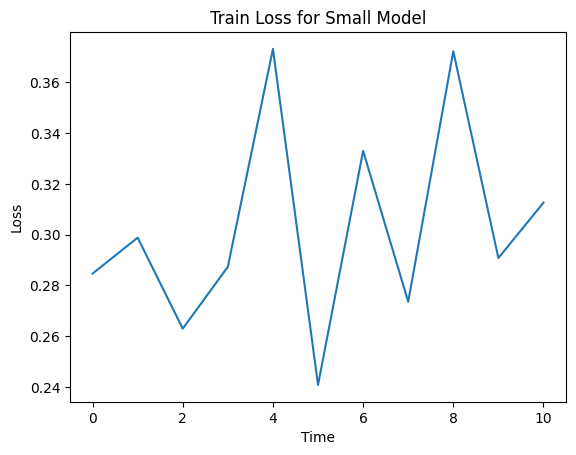

In [ ]:
plot_list(loss_lst[::2], "Train Loss for Small Model")

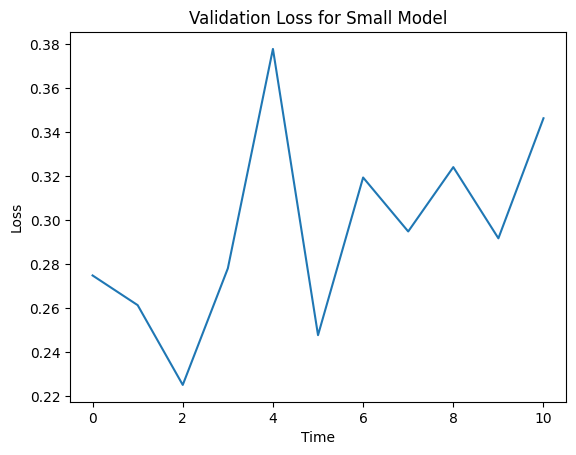

In [ ]:
plot_list(loss_lst_val[::2], "Validation Loss for Small Model")

In [ ]:
torch.save(model_small.state_dict(), '/content/drive/MyDrive/lungs/lung_segmentation_model_small_small_1.pth')

In [ ]:

model_small_path = '/content/drive/MyDrive/lungs/lung_segmentation_model_small_small.pth'
model_small.load_state_dict(torch.load(model_small_path))

# Ensure the model_small is in evaluation mode (if applicable)
model_small.eval()

Small_model(
  (encoder): Sequential(
    (0): Conv2d(1, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU()
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU()
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (decoder): Sequential(
    (0): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU()
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU()
    (4): ConvTranspose2d(64, 1, kernel_size=(2, 2), stride=(2, 2))
  )
)

In [ ]:

def predict(model, input_array):
    # Add batch dimension if needed
    if len(input_array.shape) == 2:
        input_array = input_array.unsqueeze(0)
    input_array = transform(input_array)
    # Move the input tensor to the appropriate device
    input_tensor = input_array.to(device)

    with torch.no_grad():
        model_output = model(input_tensor)

    predicted_probs = torch.sigmoid(model_output) # Converting the model output to probabilities (as BCEWithLogitsLoss was used)
    return predicted_probs.cpu().numpy()  # Moving the result to CPU and convert to NumPy array


def loss_dice(pred, target):
    pred_flat = pred.flatten()
    target_flat = target.flatten()

    intersection = torch.sum(pred_flat * target_flat)
    union = torch.sum(pred_flat) + torch.sum(target_flat)

    dice_coefficient = (2.0 * intersection) / (union + 1e-8)  # Adding a small constant to avoid division by zero

    return 1.0 - dice_coefficient  # Dice loss is 1 - Dice coefficient




Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.19580519199371338


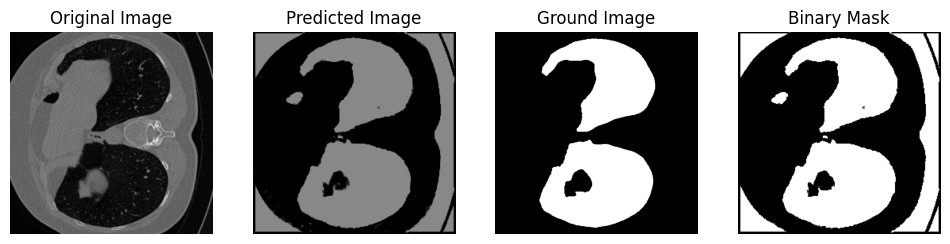

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.2514824867248535


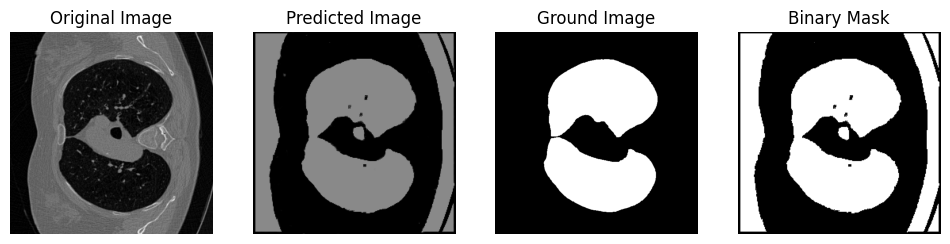

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.9992935657501221


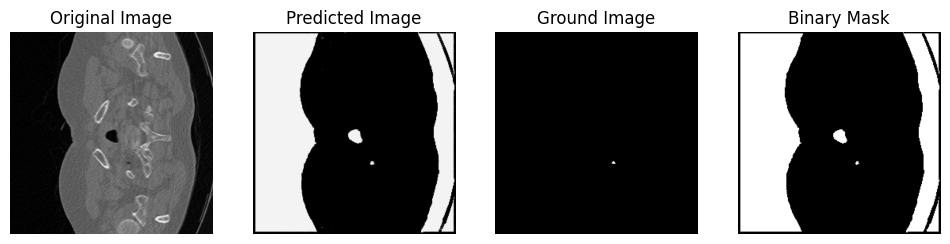

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.23535794019699097


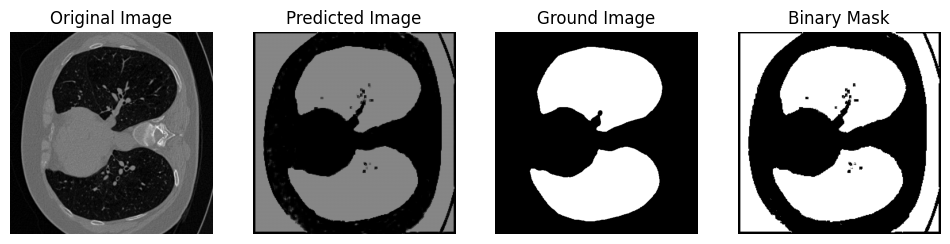

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.20201176404953003


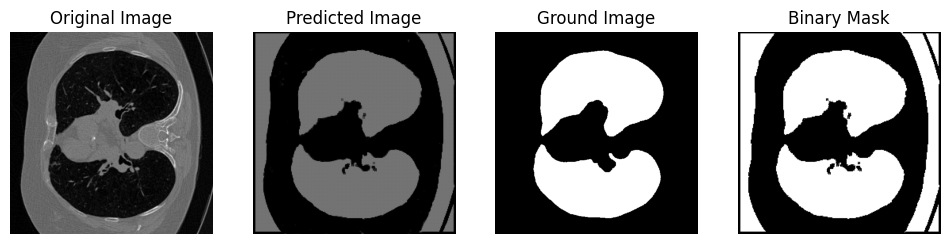

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.23155492544174194


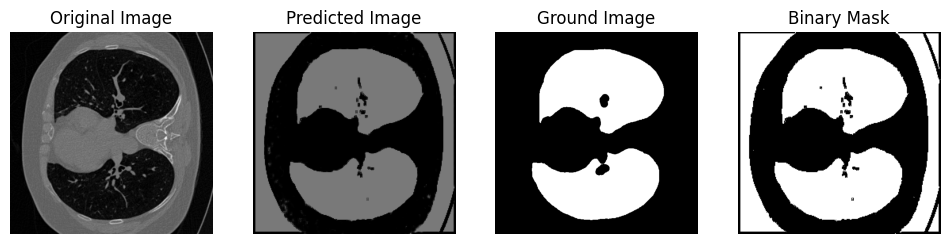

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.16847652196884155


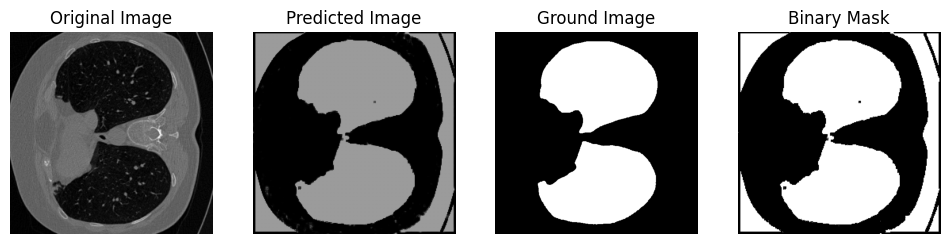

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.3717328906059265


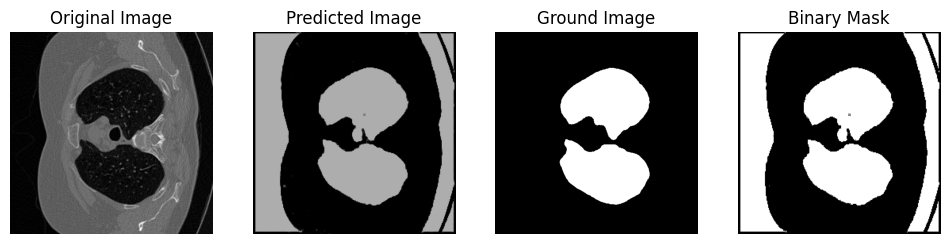

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.7291505336761475


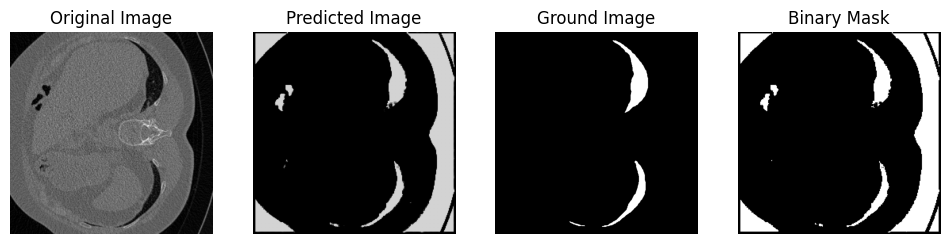

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.8229515552520752


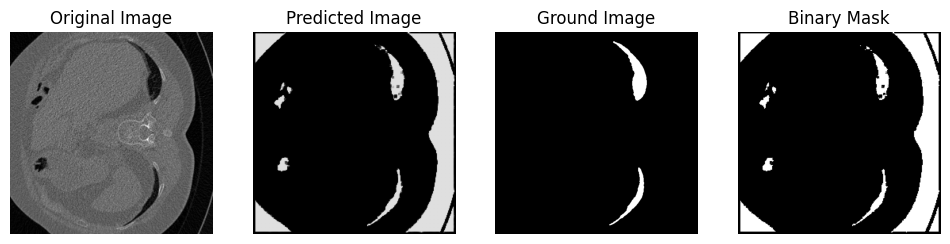

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.2297549843788147


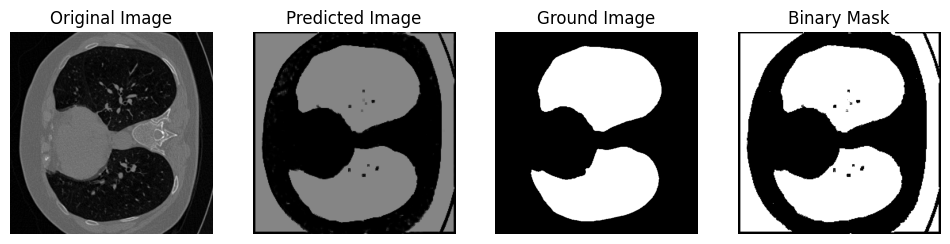

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.20387858152389526


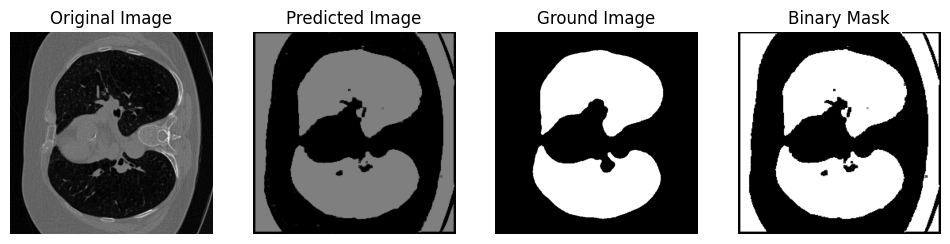

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.18052184581756592


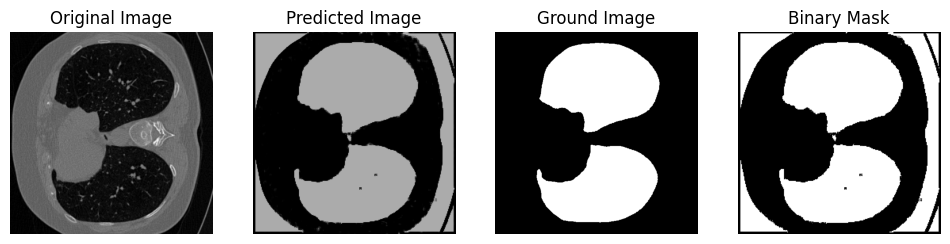

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.17531108856201172


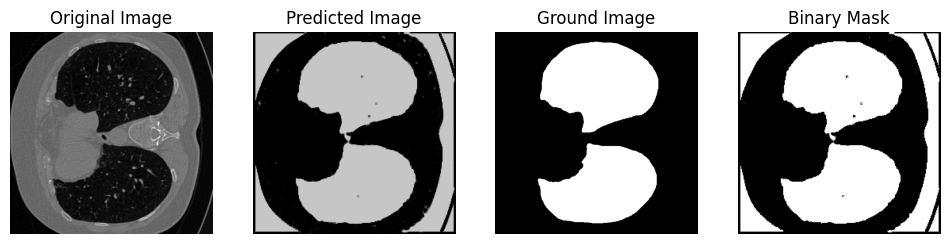

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.9263967275619507


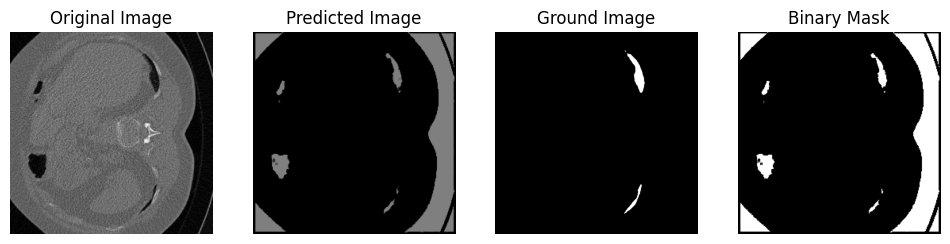

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.9761441349983215


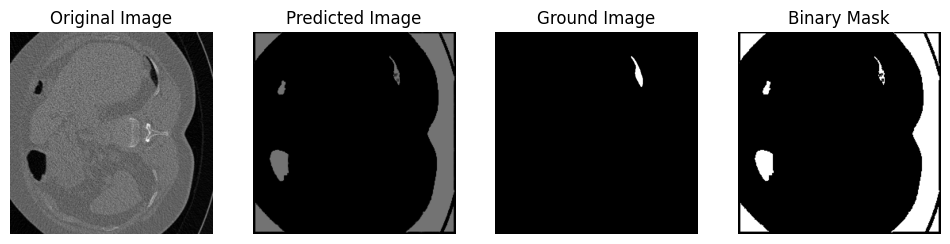

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.7174935340881348


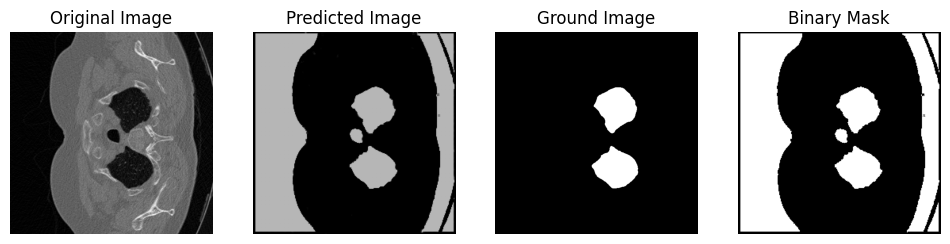

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.23384326696395874


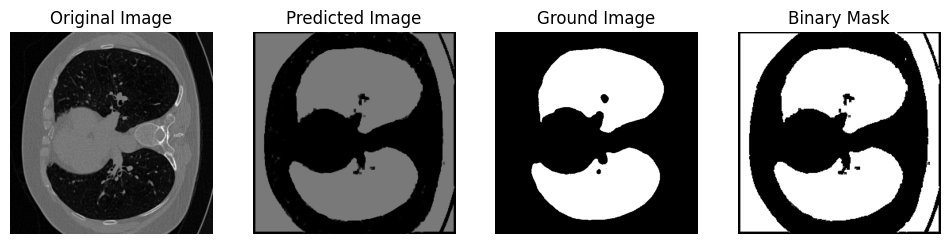

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.20990192890167236


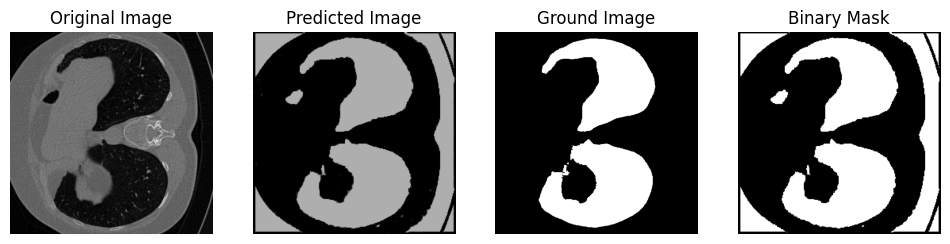

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.5506516098976135


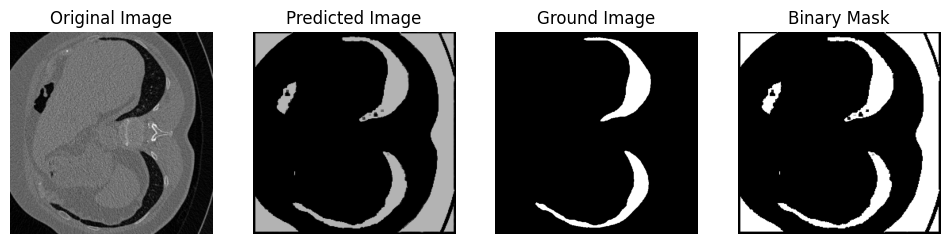

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.780534029006958


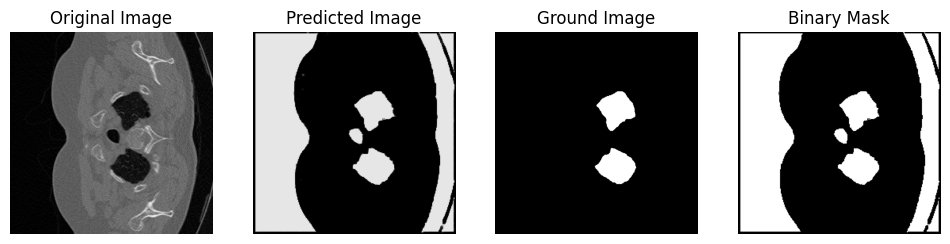

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.20248687267303467


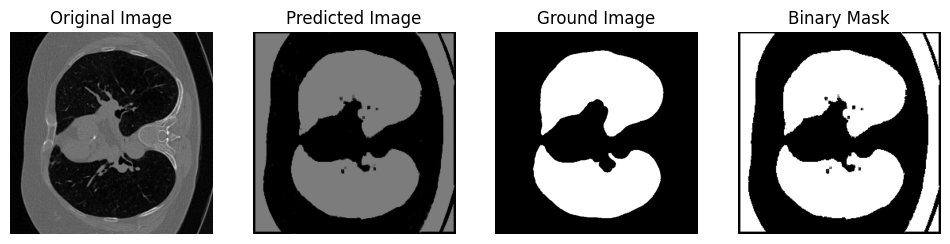

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.21599668264389038


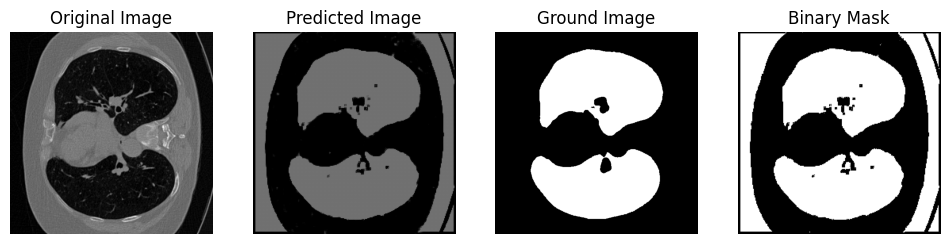

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.9728110432624817


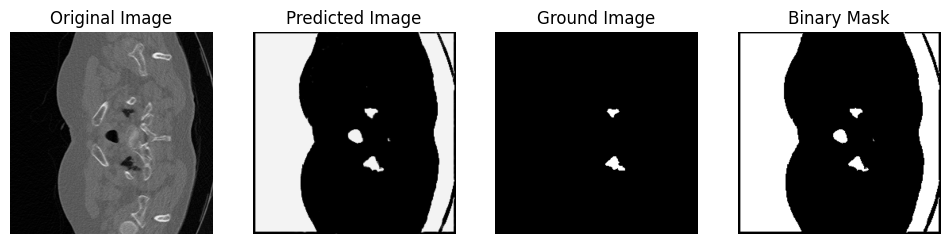

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.2504549026489258


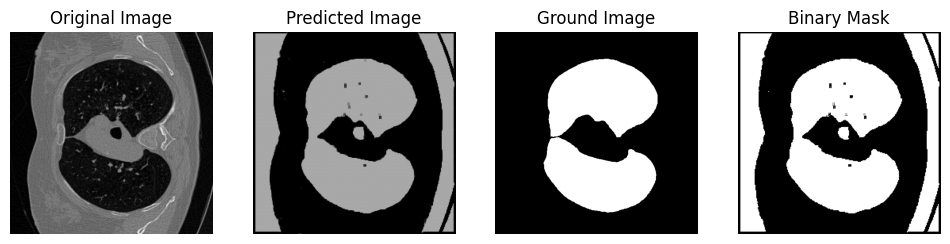

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.22537708282470703


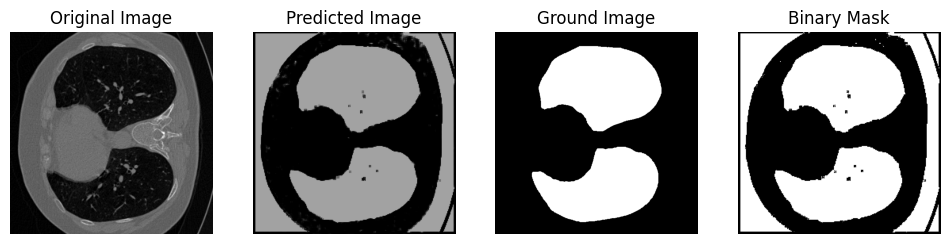

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 1.0


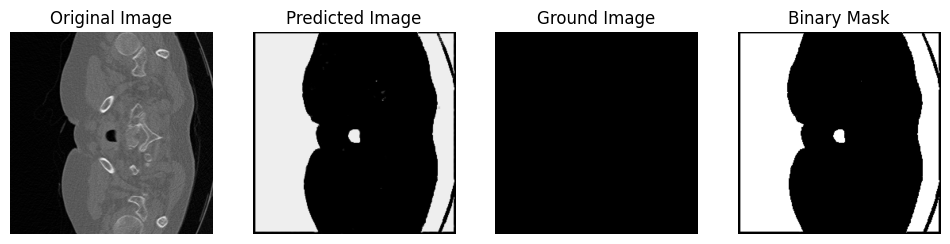

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.23402070999145508


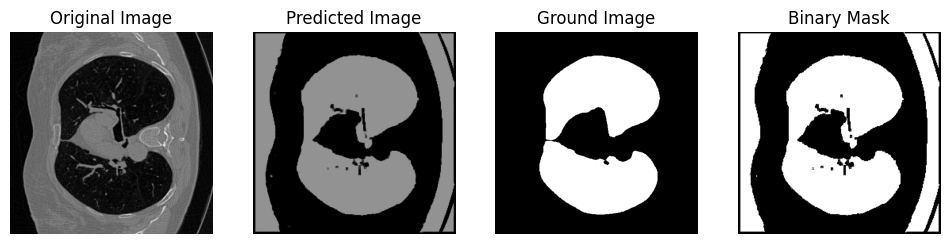

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.8528212308883667


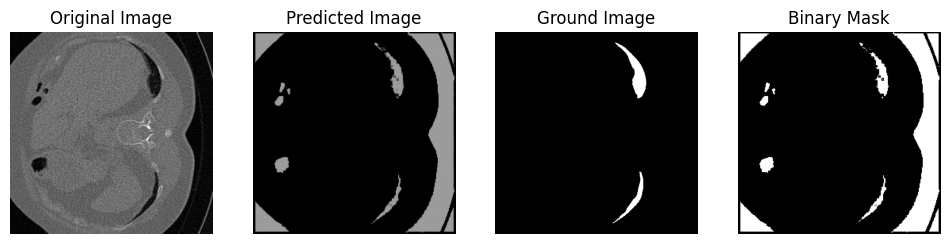

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.22567874193191528


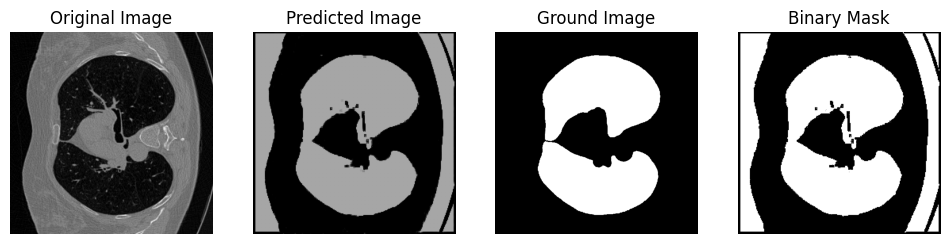

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.7302186489105225


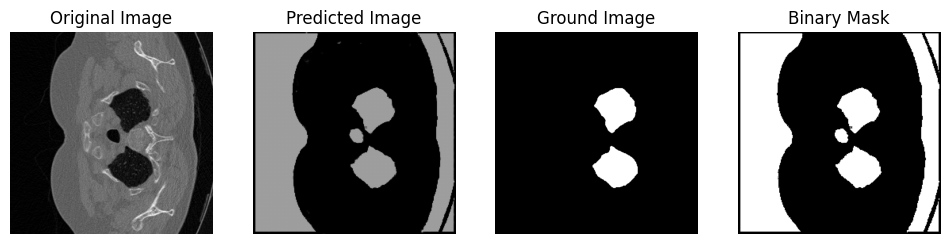

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 1.0


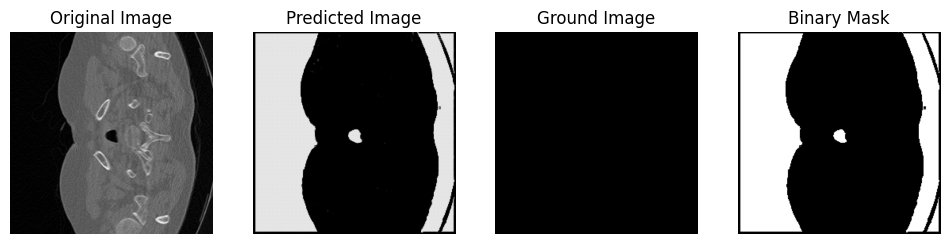

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.3237563371658325


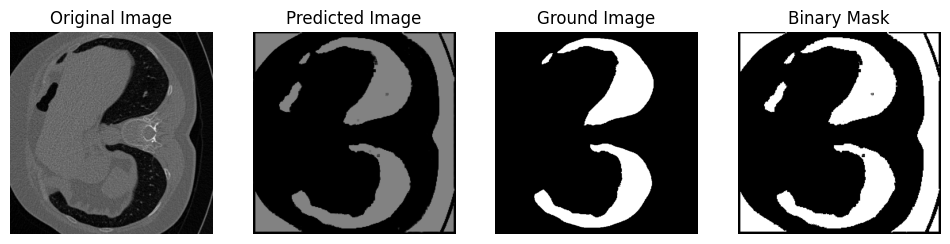

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.3148852586746216


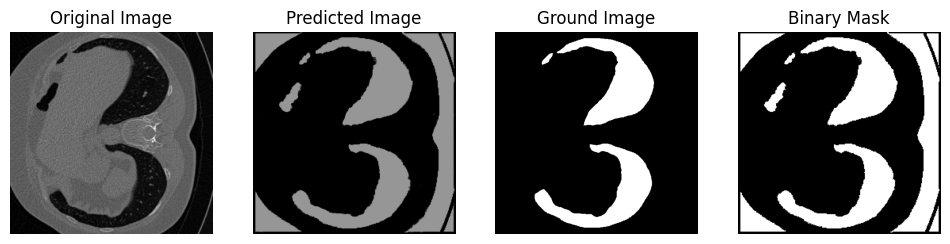

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.6237602233886719


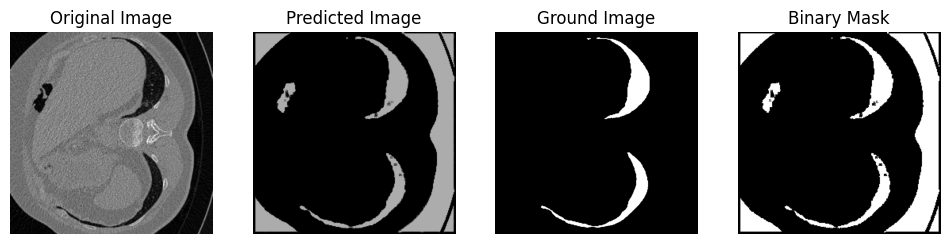

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.8559176921844482


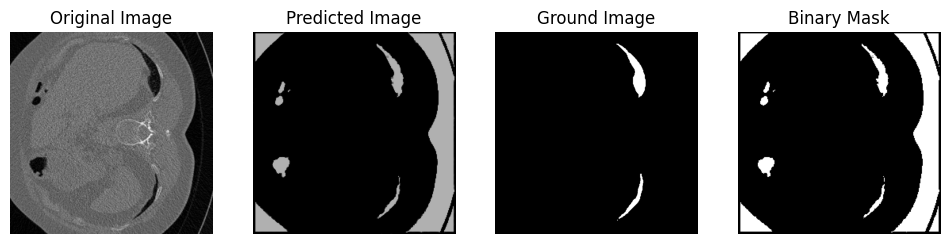

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.23599421977996826


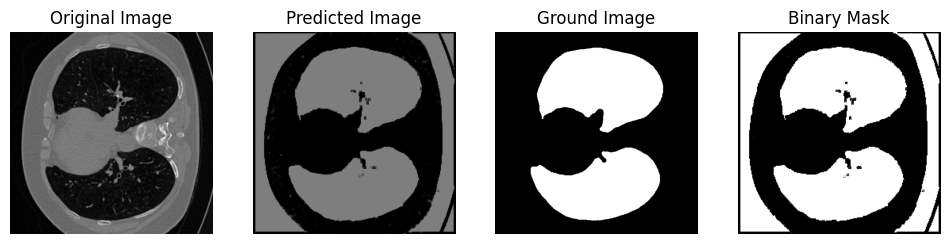

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 1.0


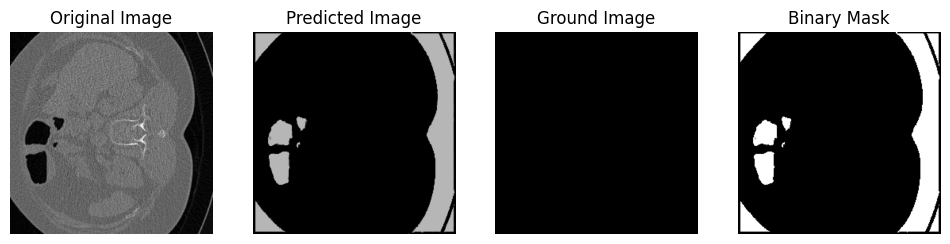

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 1.0


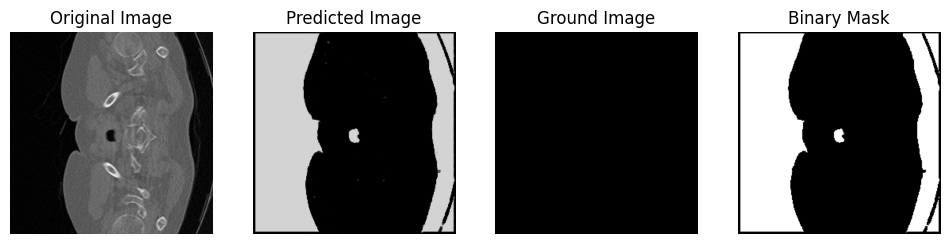

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.5798452496528625


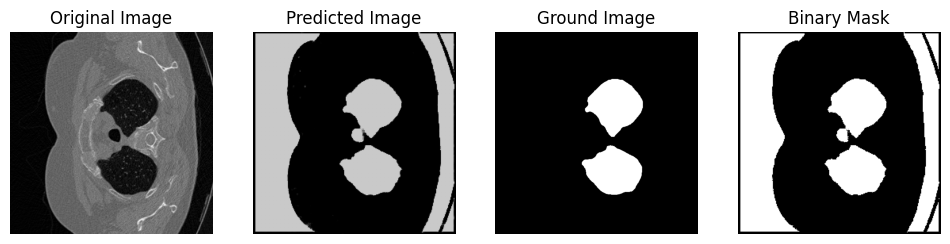

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.22308558225631714


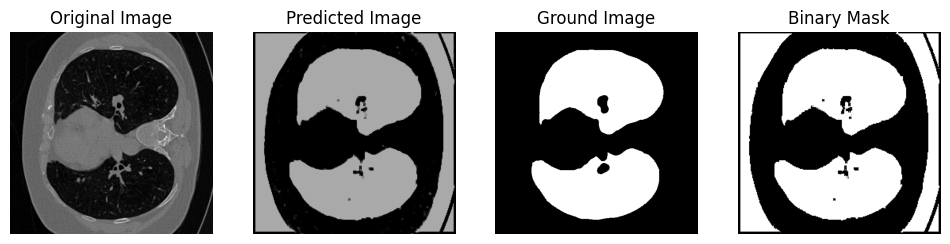

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 1.0


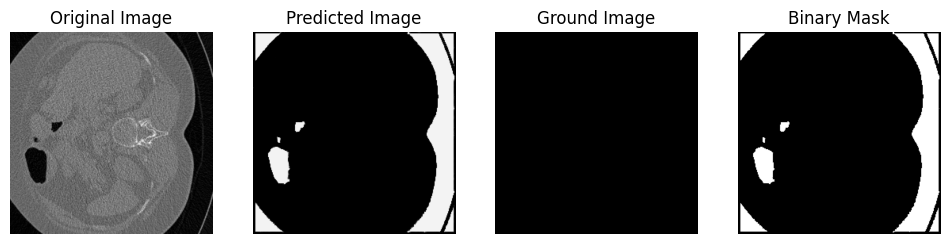

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.20248085260391235


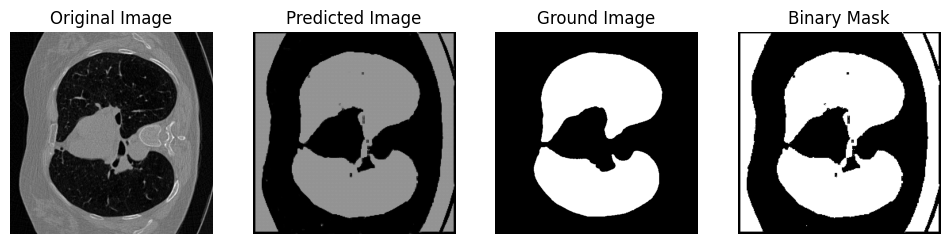

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.43204760551452637


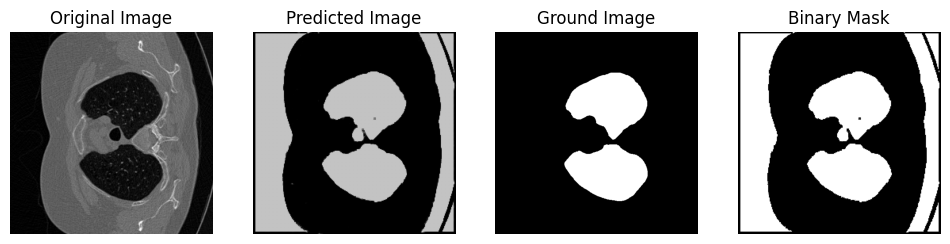

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.24452930688858032


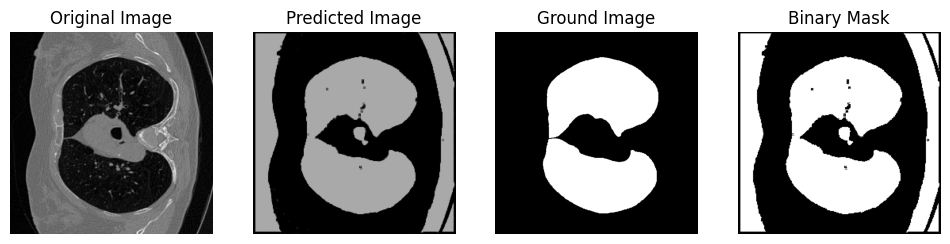

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.8976702690124512


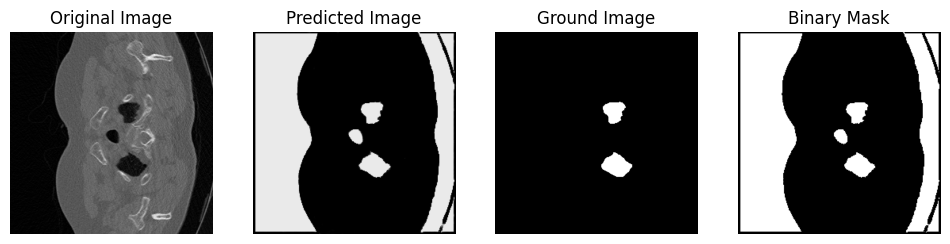

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.46882718801498413


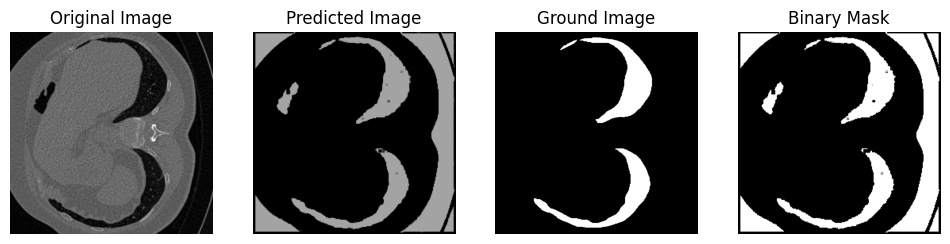

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.9734418988227844


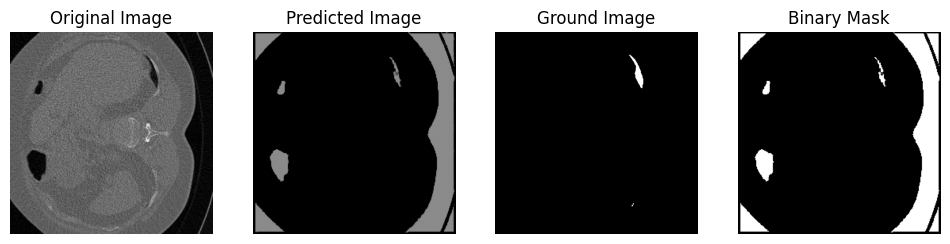

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.2261757254600525


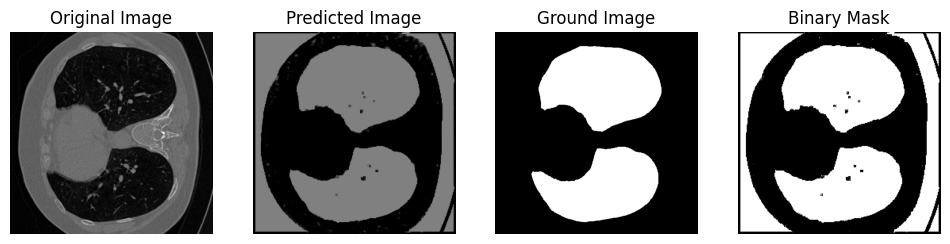

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.6759814023971558


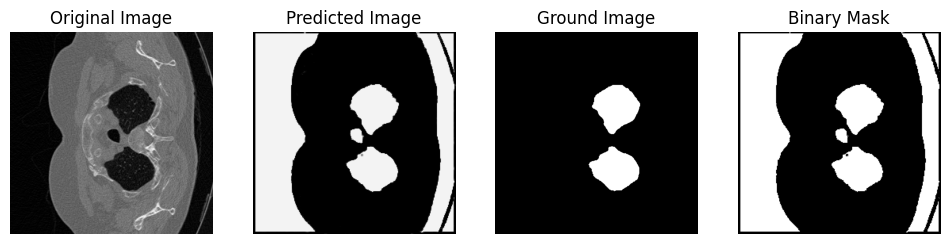

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.20693331956863403


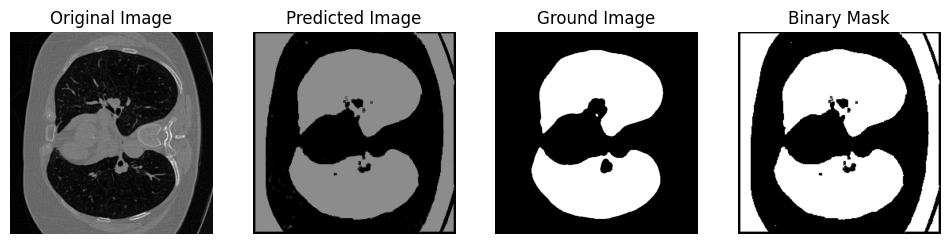

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.8487995266914368


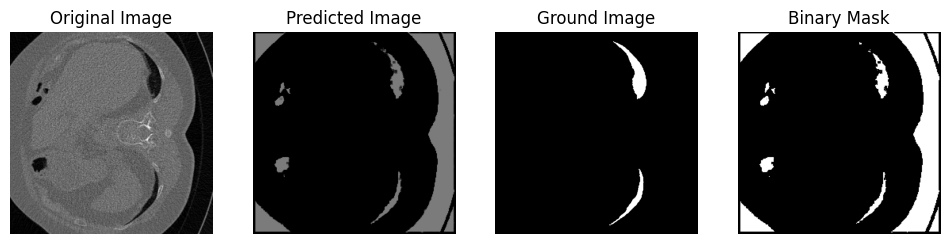

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.5208653211593628


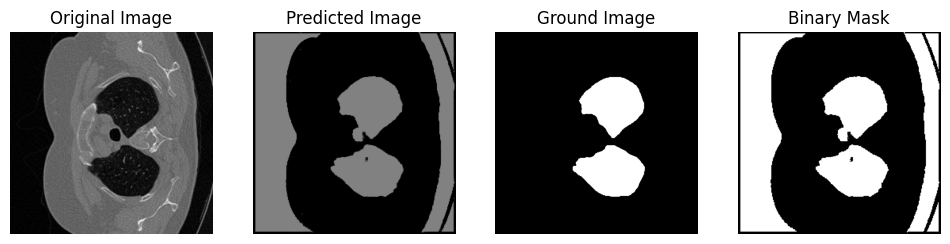

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.8432841300964355


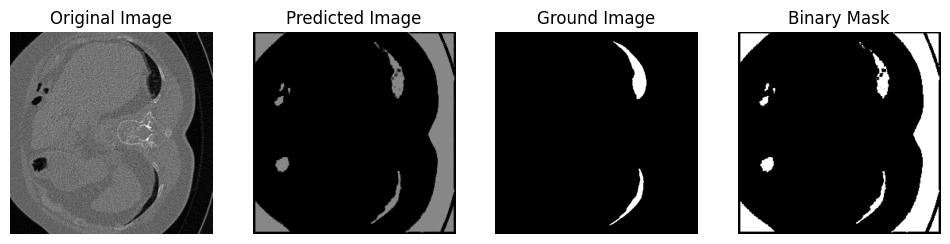

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 1.0


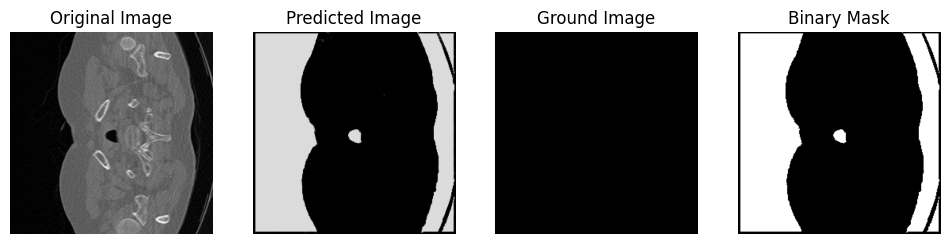

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.4262371063232422


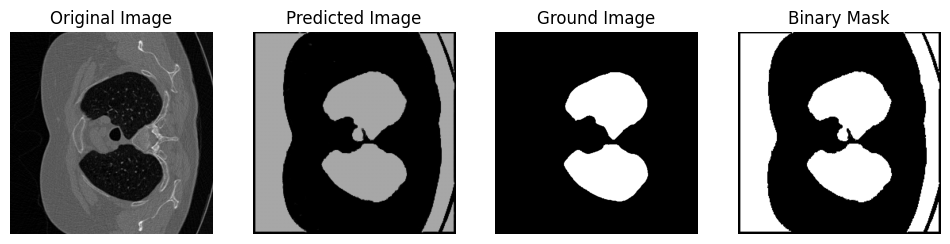

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.21482491493225098


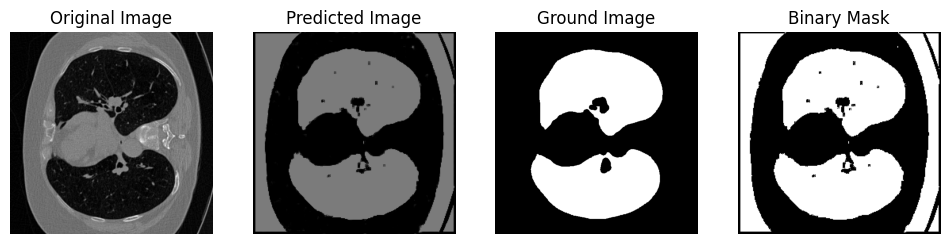

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.20481926202774048


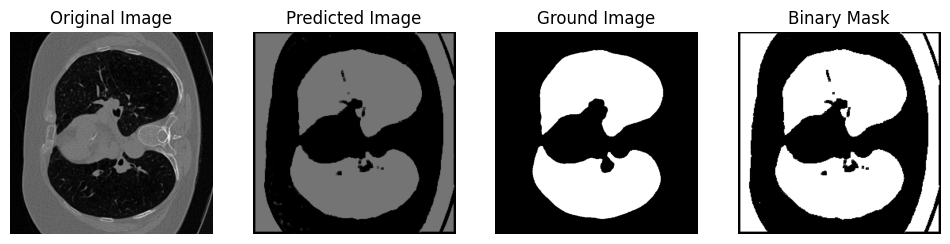

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.16696852445602417


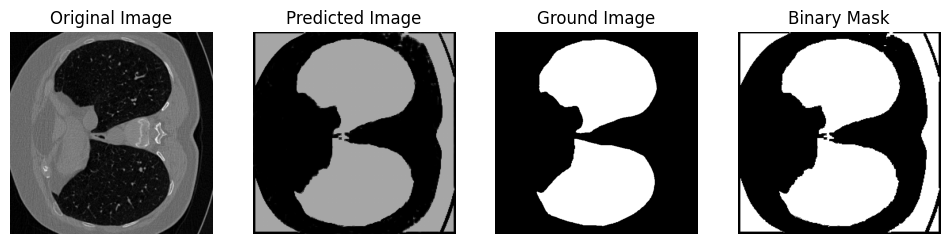

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.17923539876937866


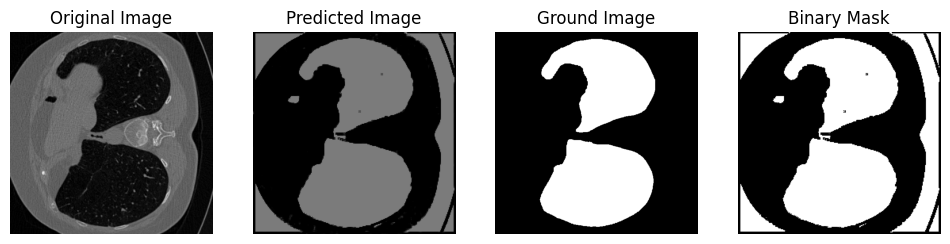

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.45465266704559326


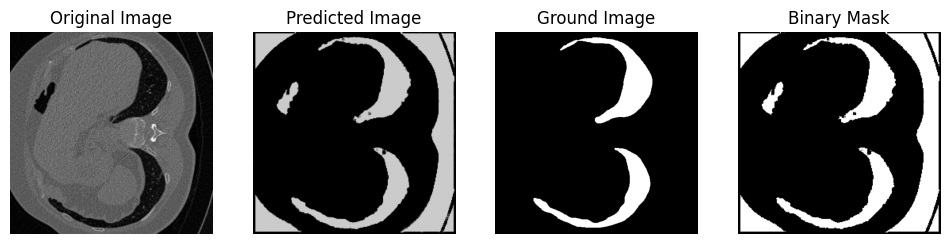

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 1.0


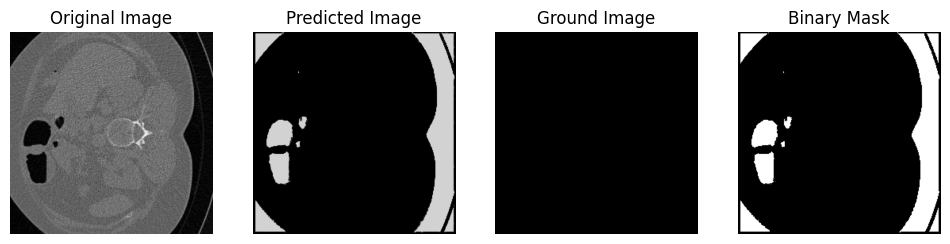

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.17801165580749512


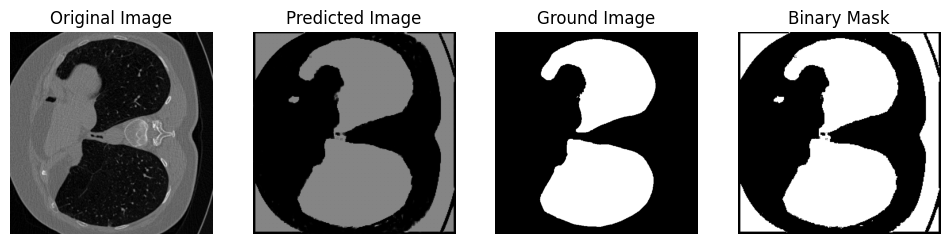

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.2512933611869812


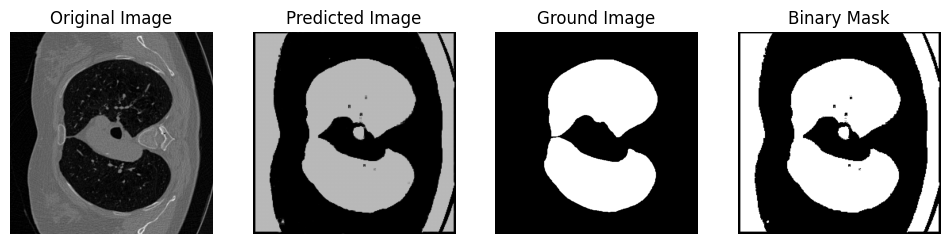

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 1.0


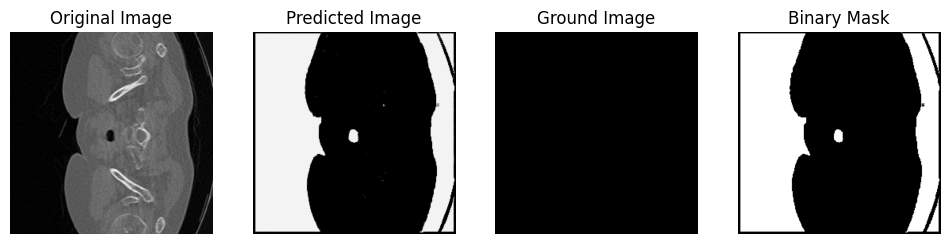

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.9265003204345703


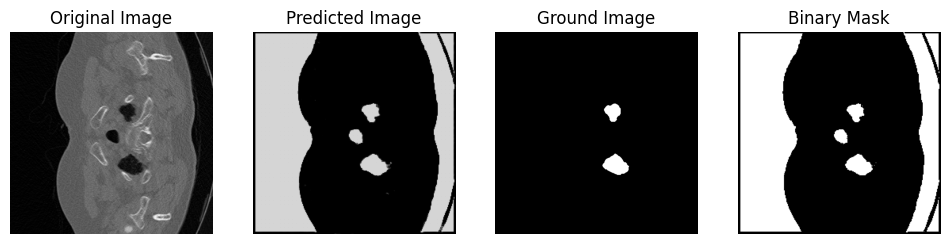

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.23478668928146362


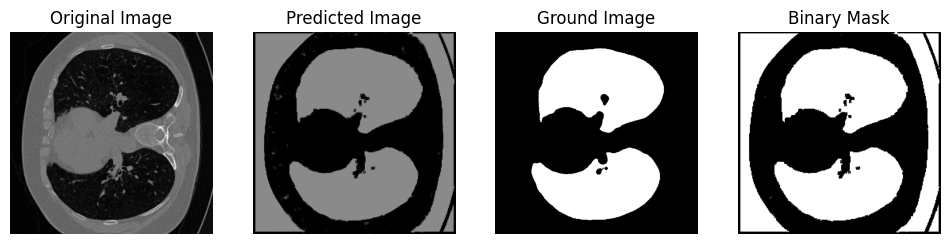

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.9536807537078857


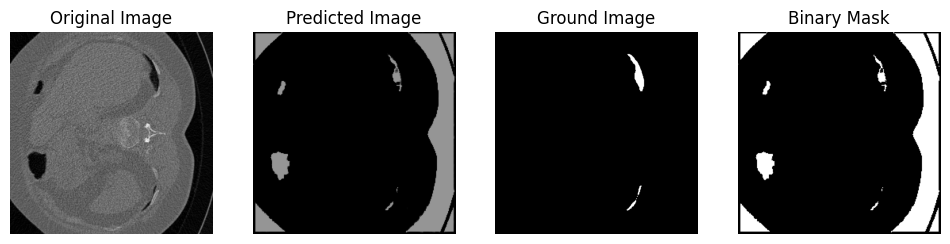

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.33654671907424927


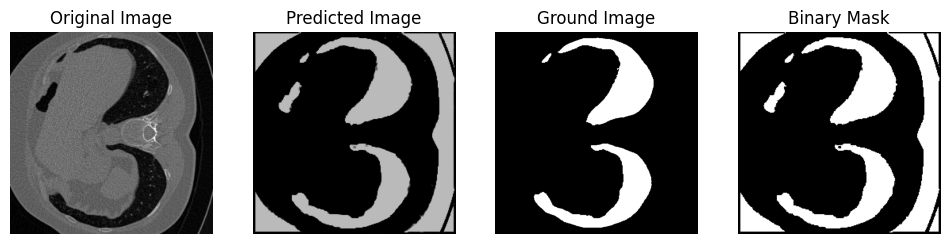

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 1.0


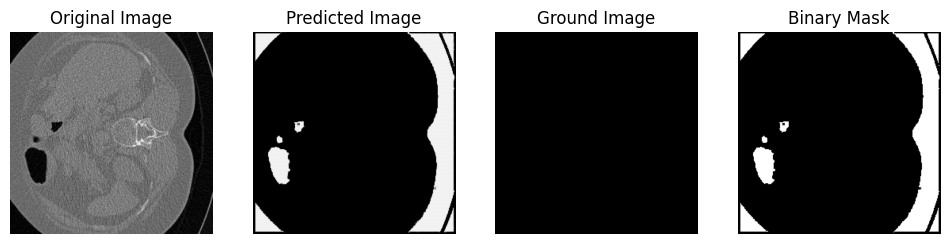

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.8923860788345337


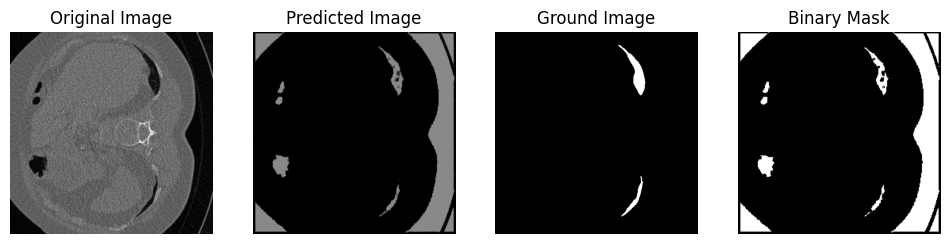

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.2341616153717041


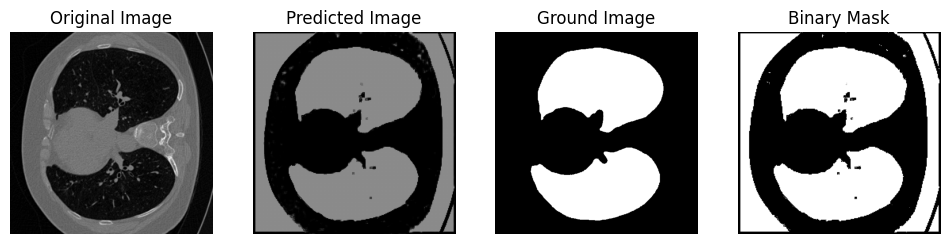

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.20199114084243774


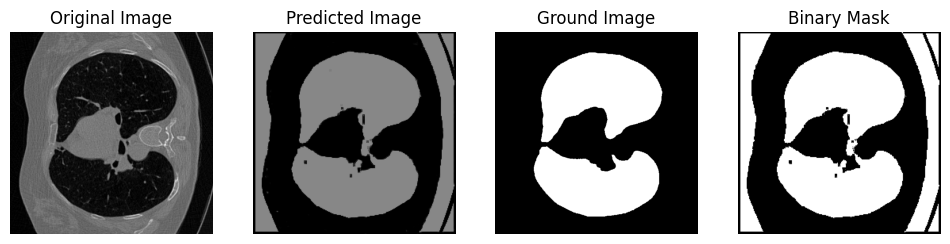

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.9951797723770142


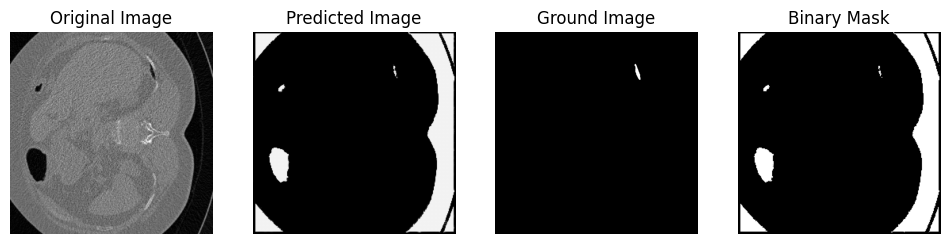

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.8727515339851379


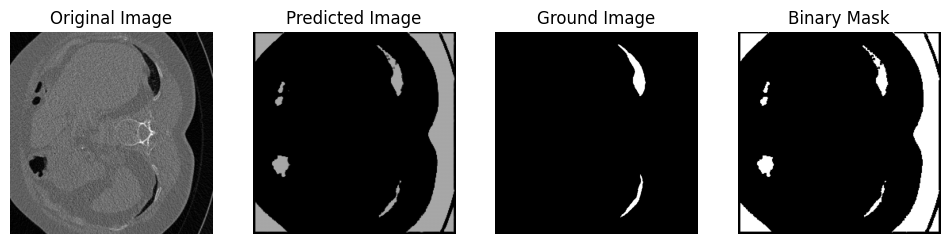

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.21300512552261353


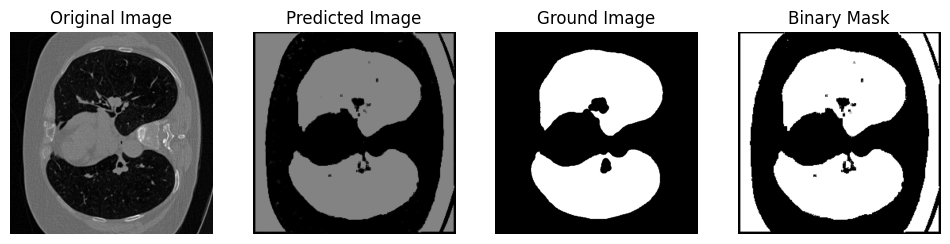

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.16620314121246338


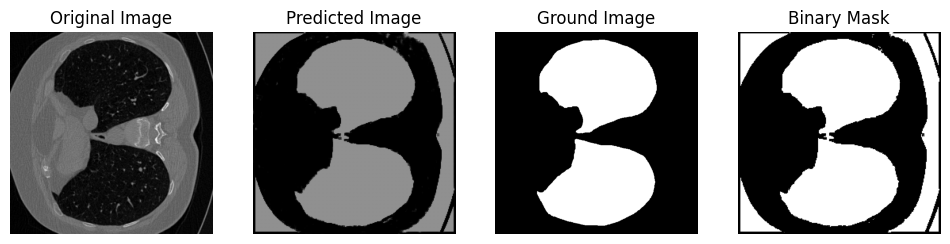

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.2704709768295288


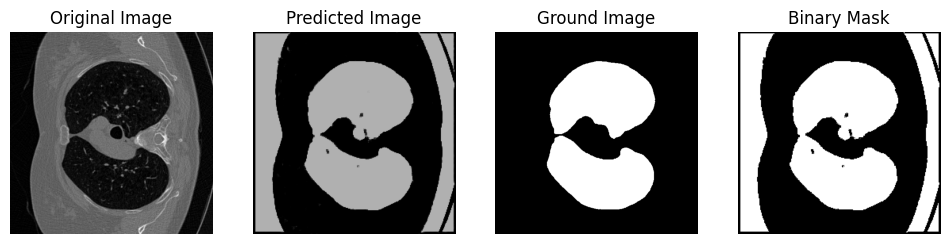

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 1.0


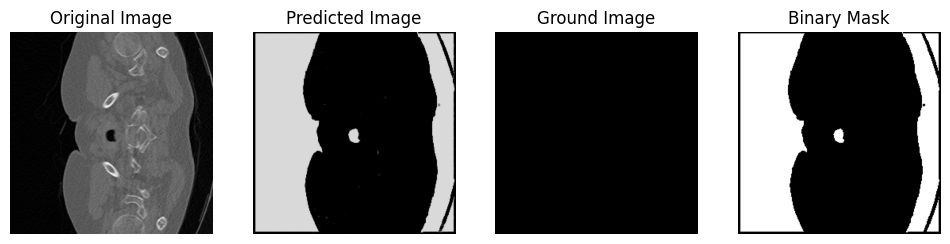

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.23335468769073486


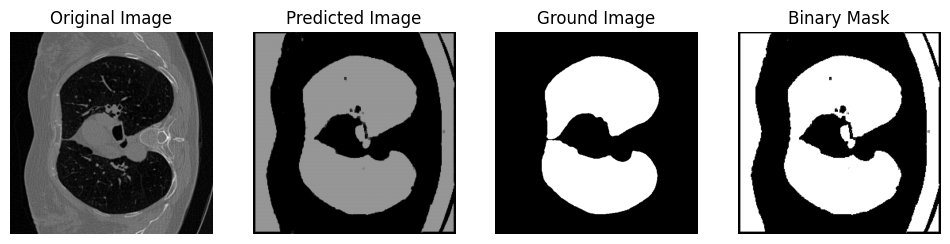

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.16547775268554688


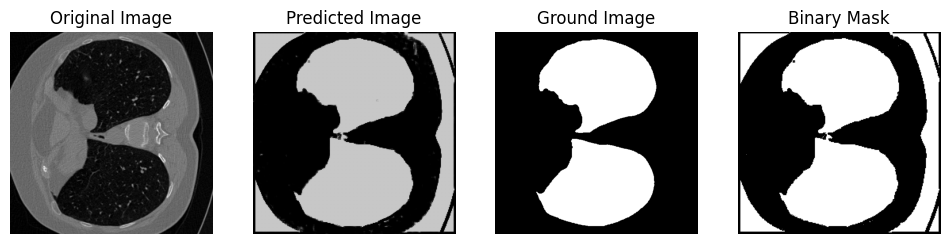

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.3496333956718445


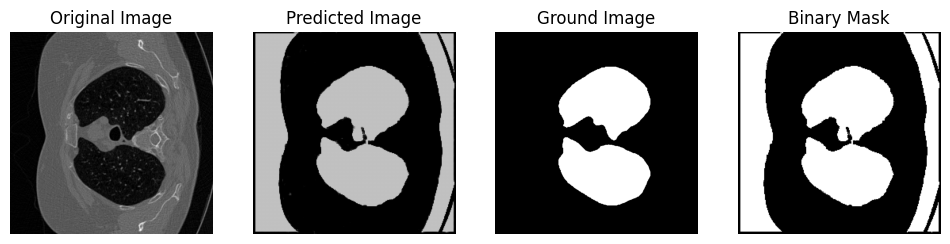

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.9132407307624817


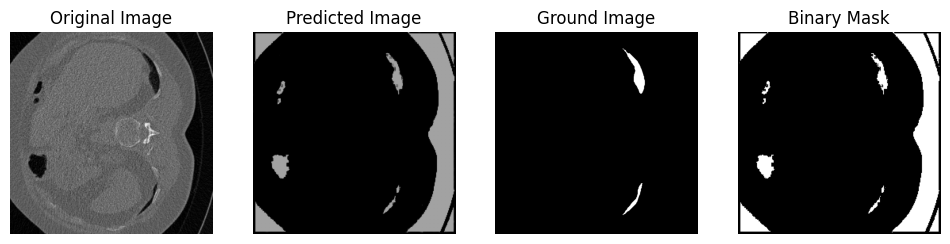

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.8446574807167053


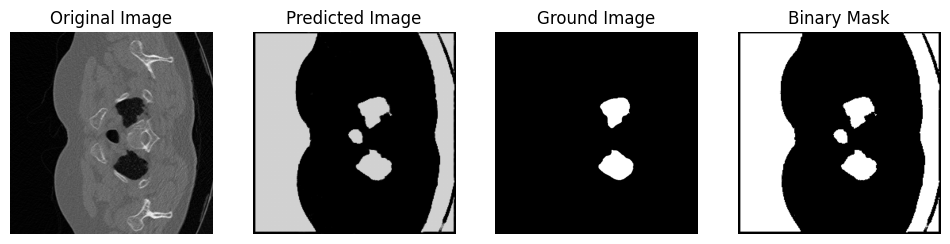

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.9857170581817627


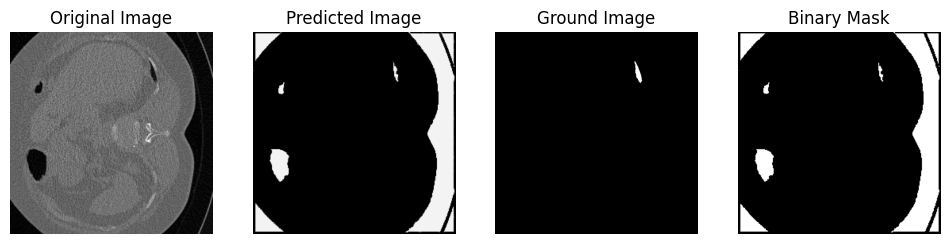

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.24080544710159302


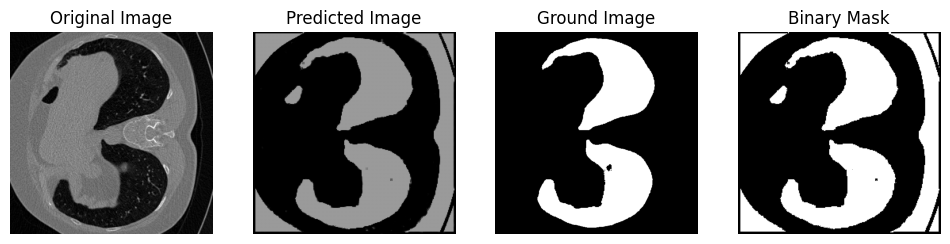

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.20005327463150024


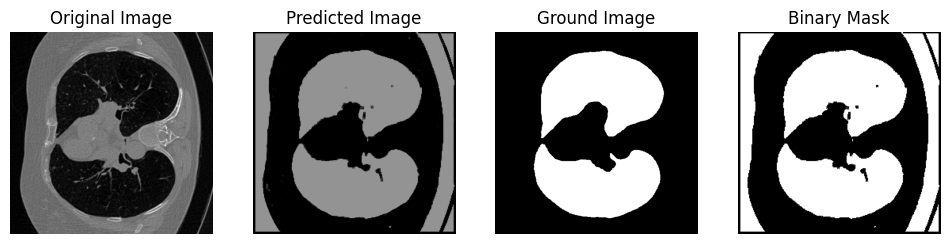

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 1.0


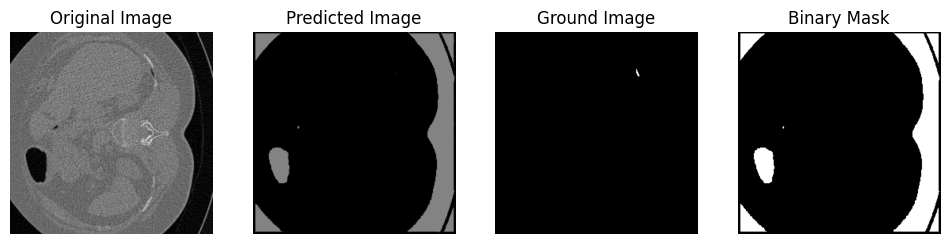

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.2895957827568054


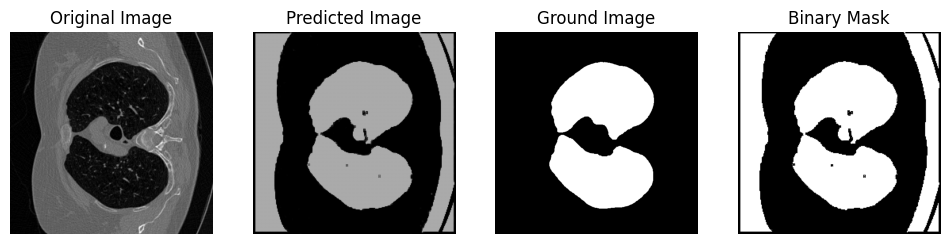

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.233037531375885


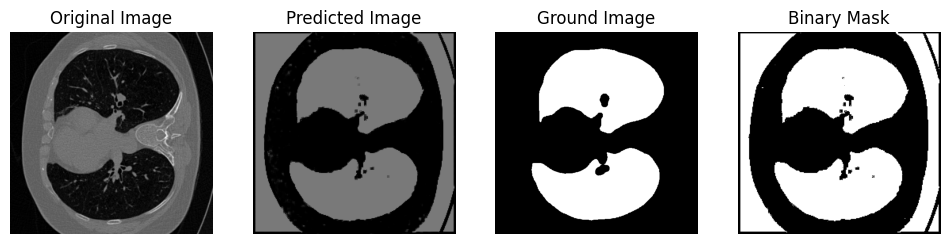

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 1.0


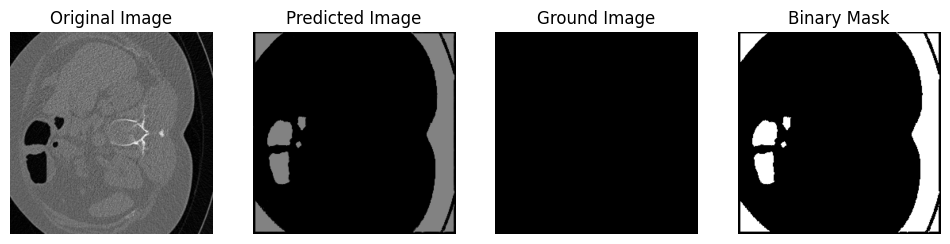

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.8842447996139526


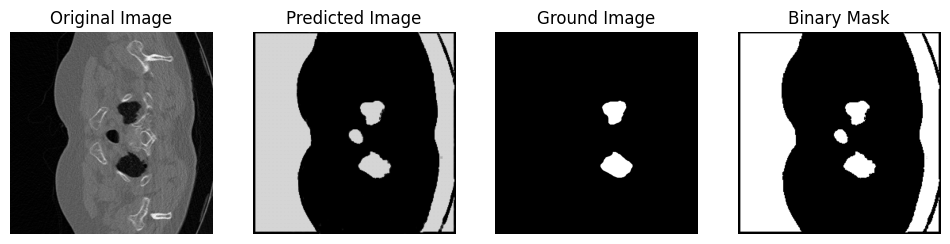

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 1.0


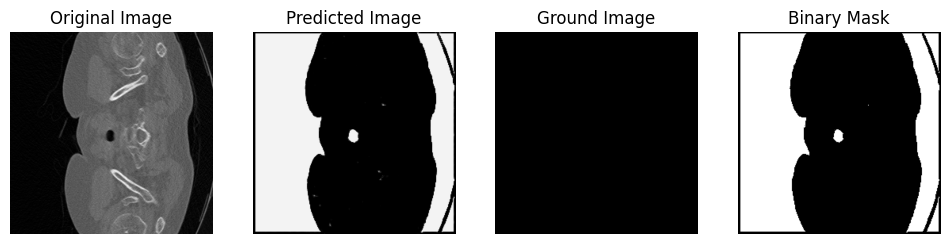

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.17410212755203247


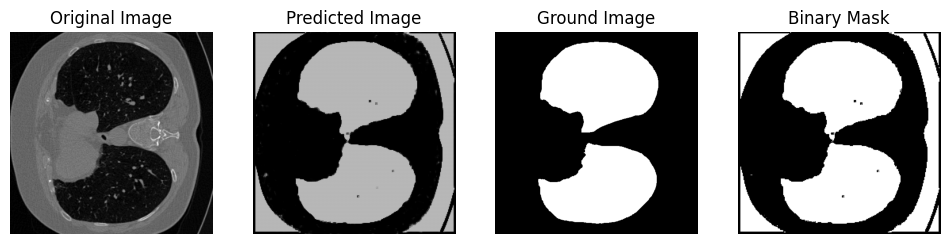

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.2278701663017273


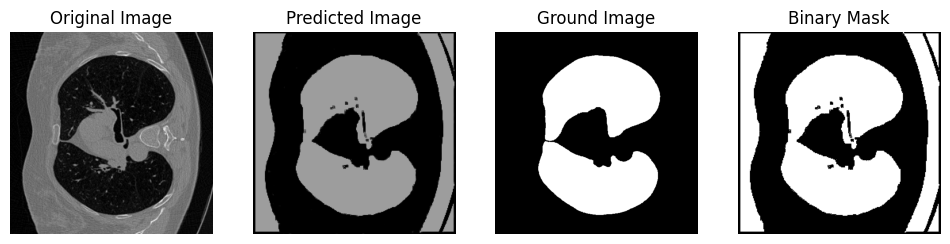

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.35344845056533813


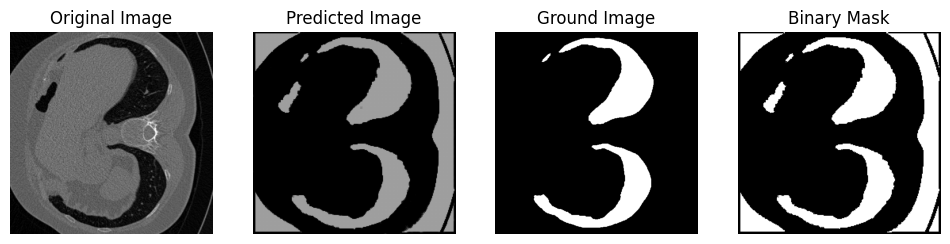

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.21673017740249634


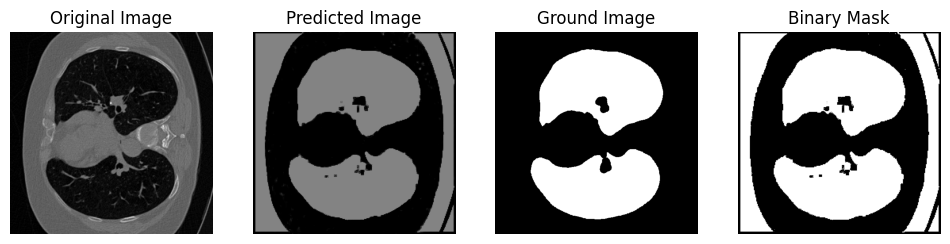

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.22349321842193604


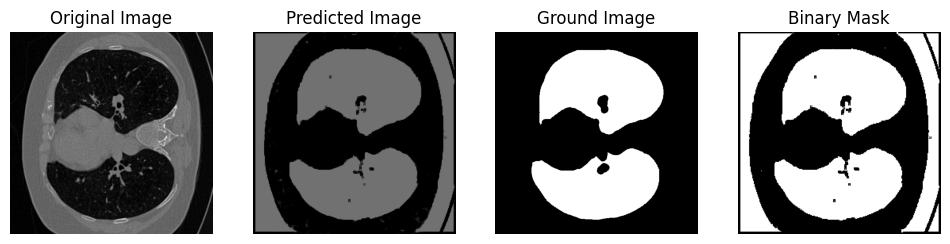

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.9337601065635681


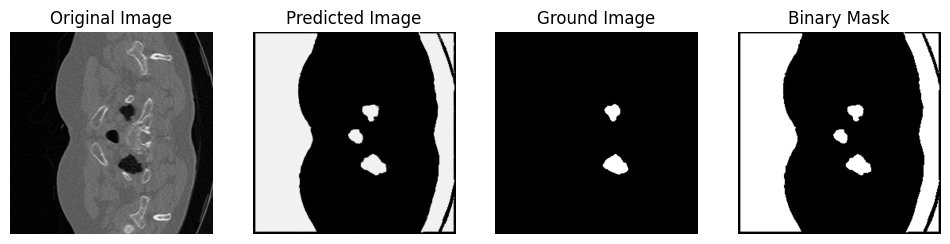

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.7782572507858276


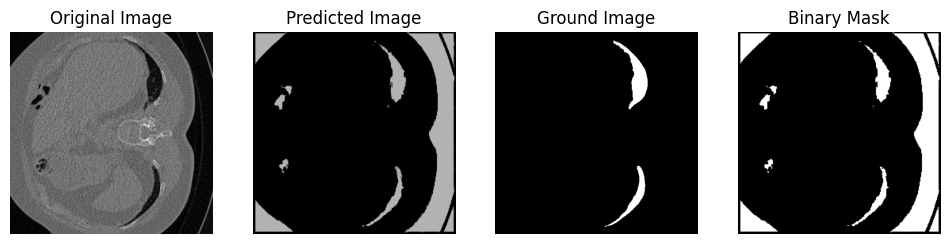

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.24341881275177002


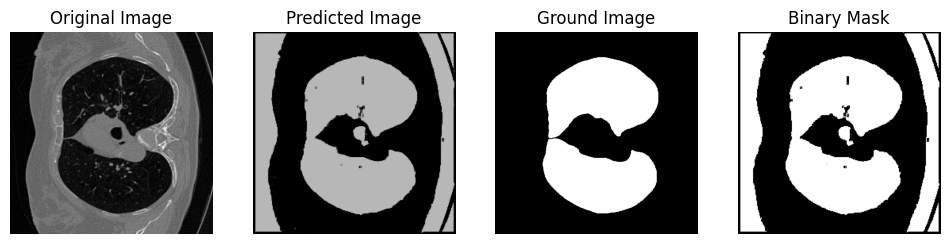

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.23668789863586426


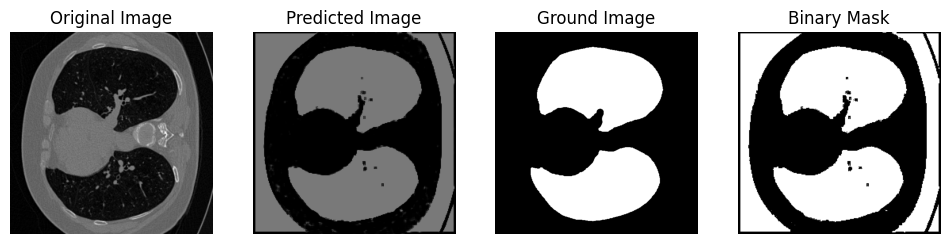

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.24175649881362915


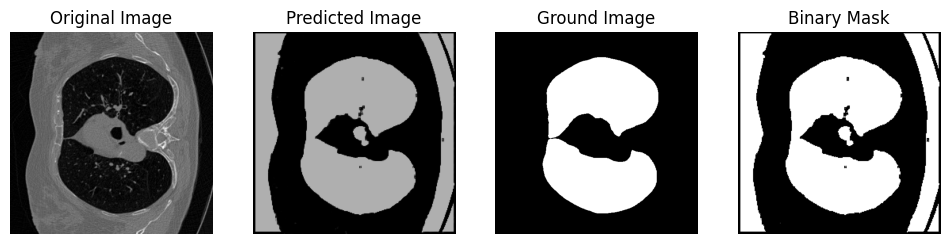

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.8919079899787903


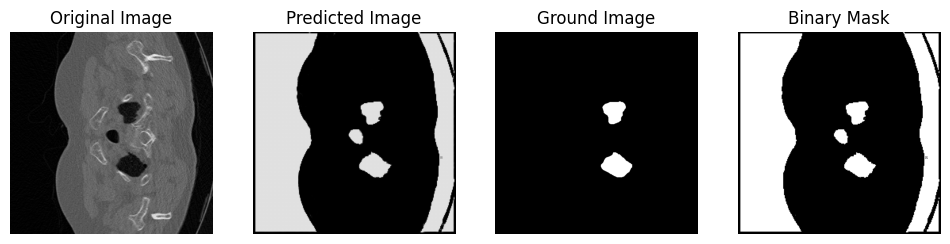

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.24851542711257935


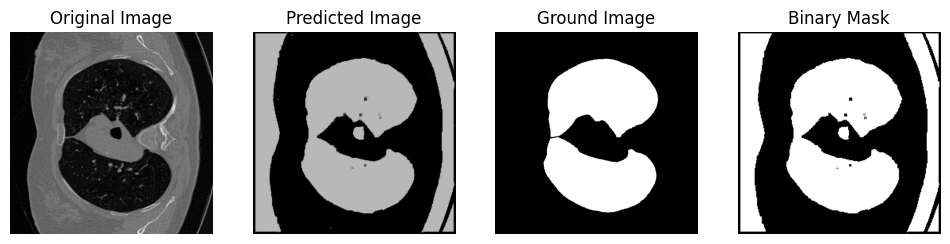

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.24683046340942383


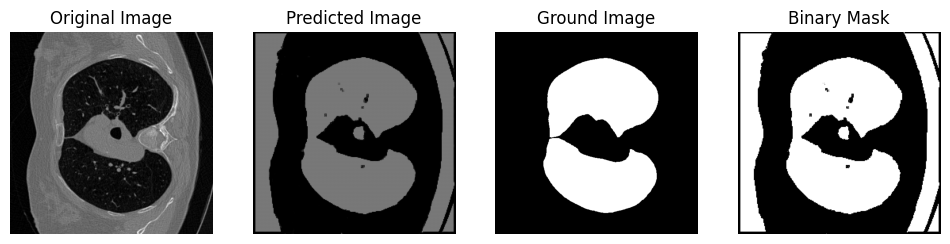

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.9975279569625854


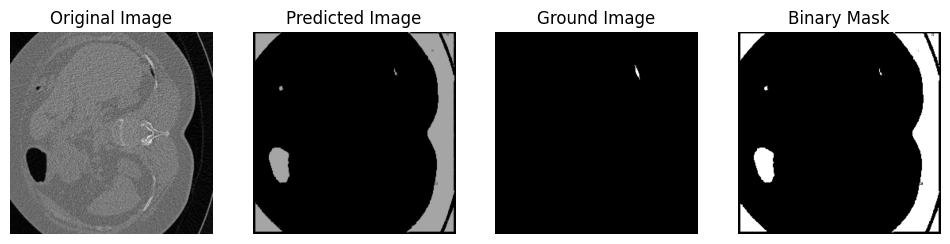

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.1671658754348755


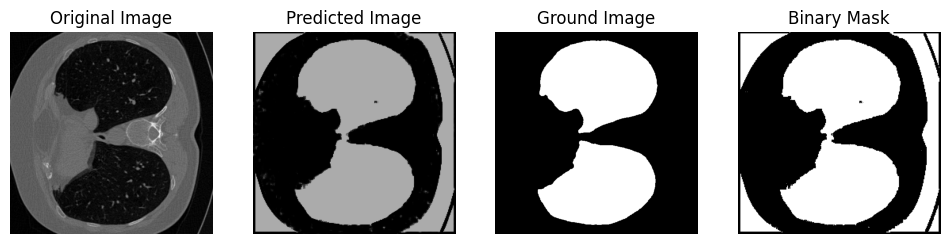

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.563844621181488


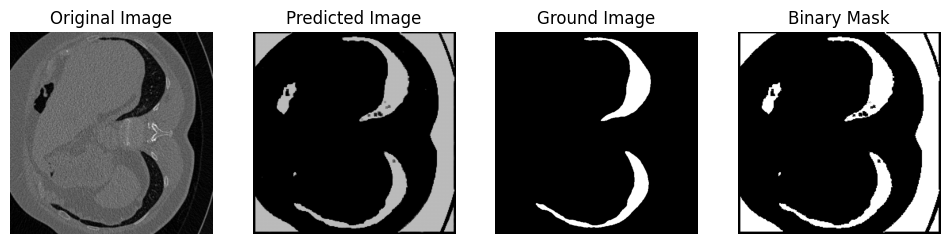

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.23597502708435059


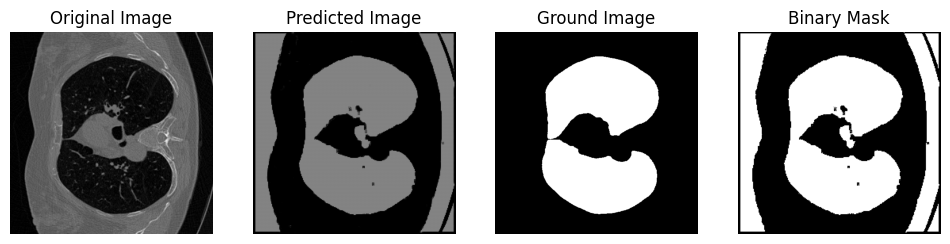

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.9665553569793701


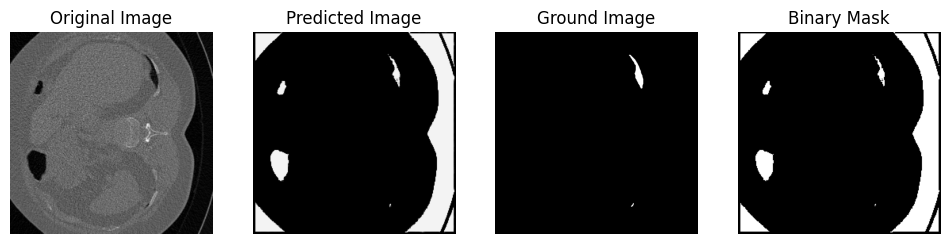

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.2308465838432312


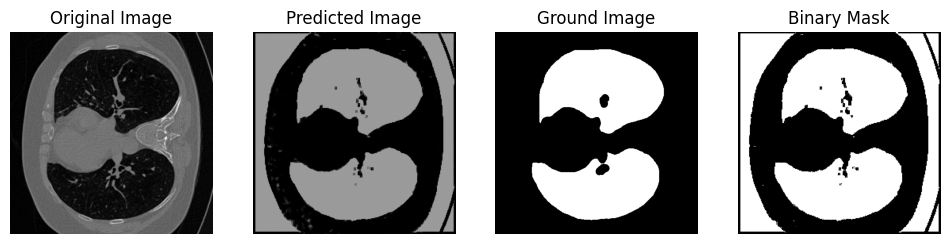

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.26685911417007446


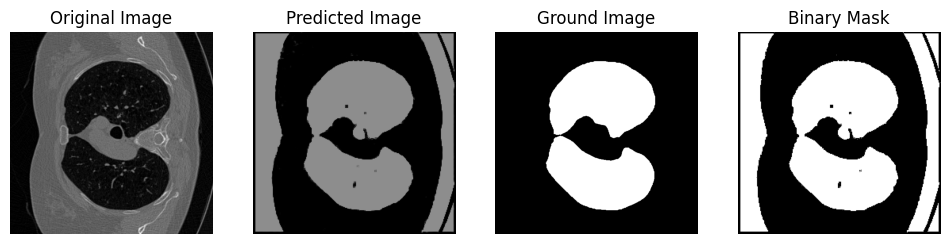

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.2373153567314148


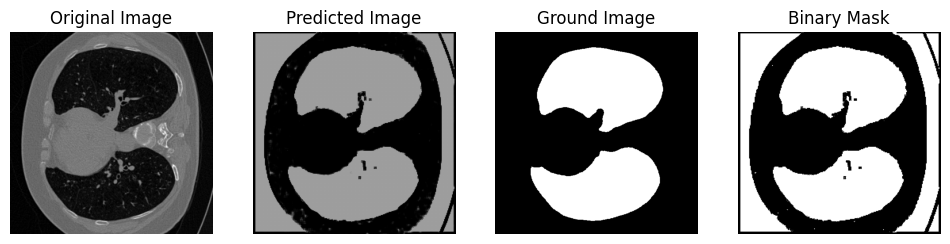

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.3469993472099304


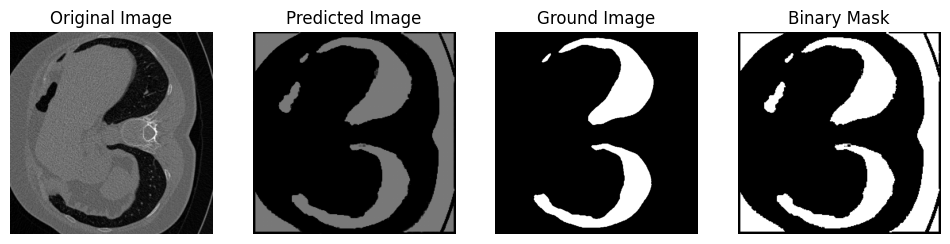

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.17937815189361572


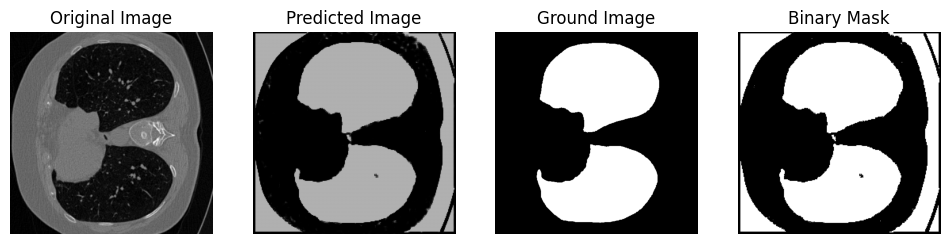

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.22009342908859253


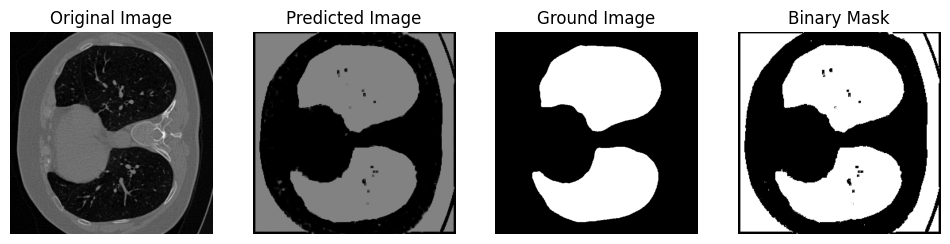

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 1.0


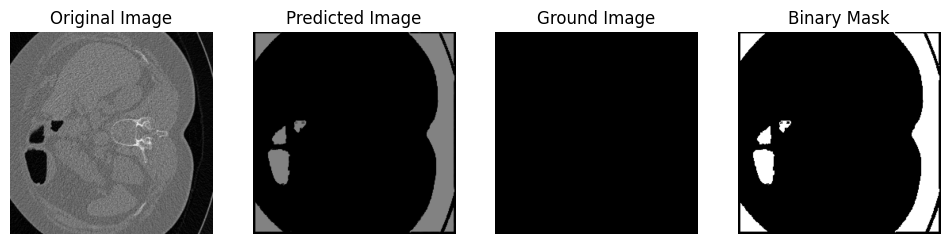

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.1737518310546875


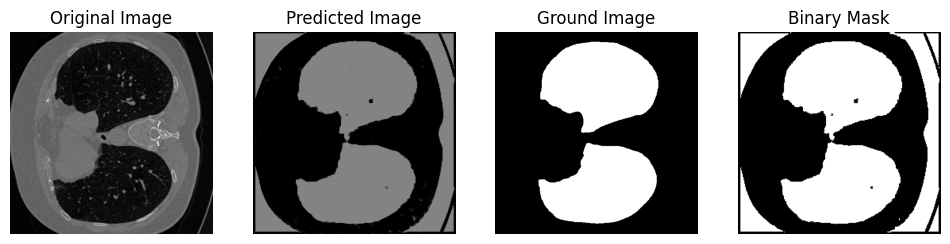

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.23364144563674927


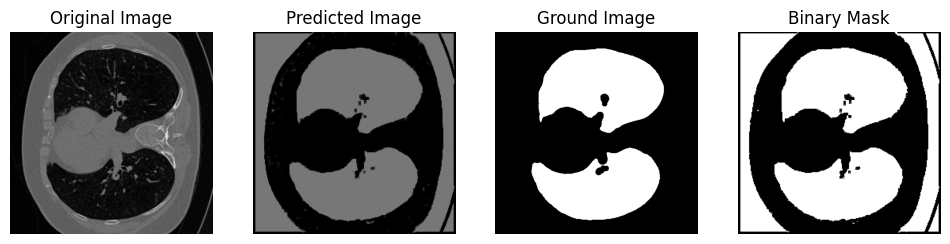

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.17041760683059692


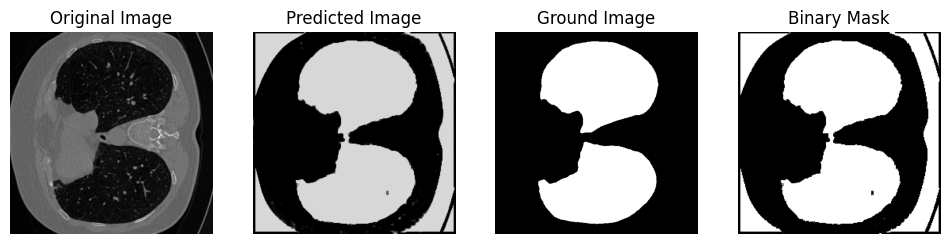

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.8165926933288574


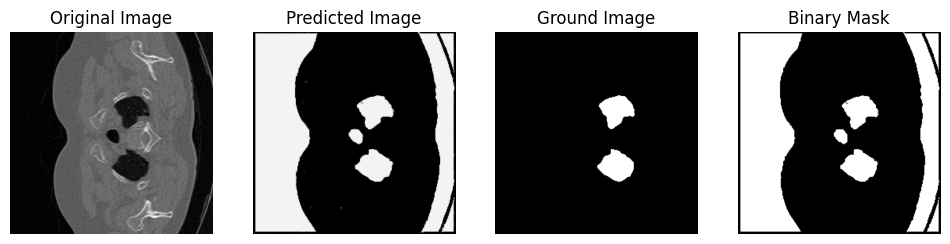

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.25269967317581177


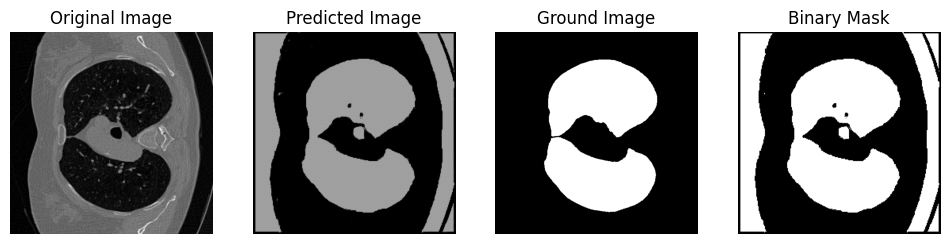

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.5361526012420654


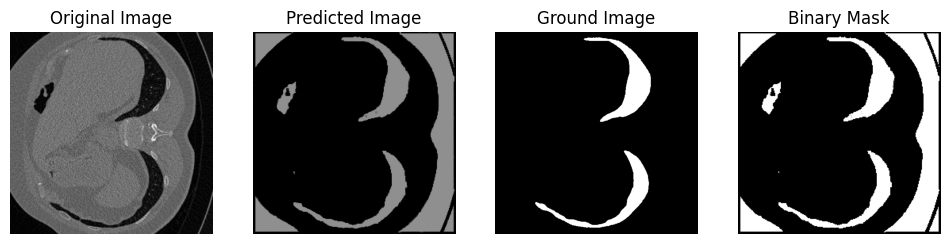

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.23554807901382446


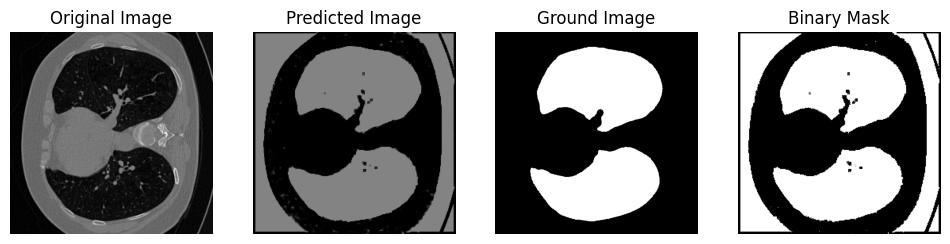

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.8159807324409485


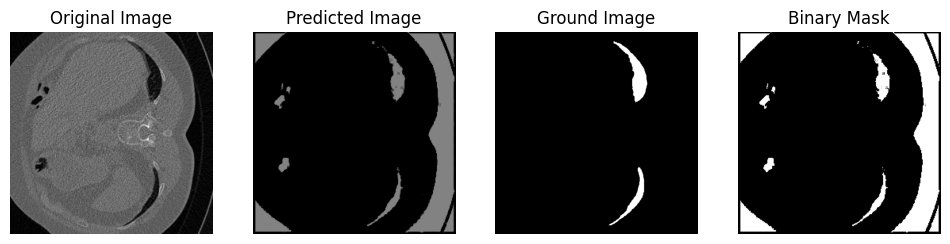

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.9844152927398682


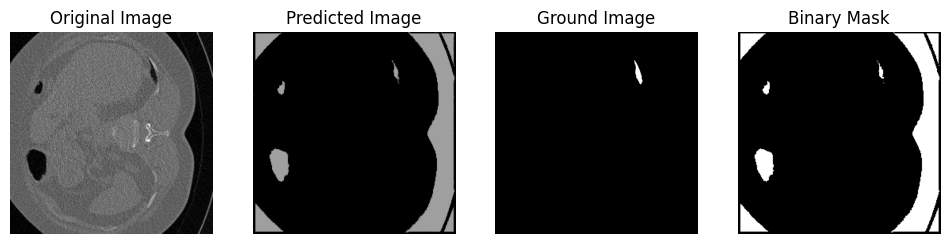

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.8335201144218445


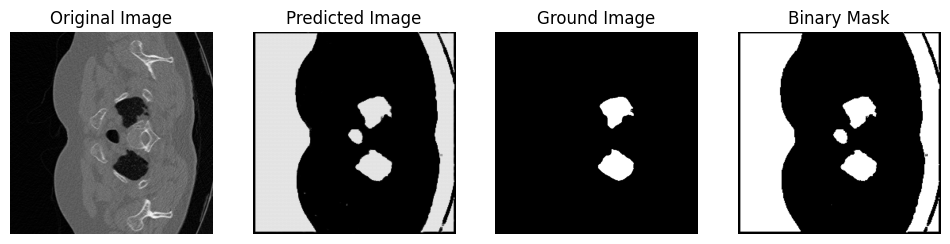

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.460848867893219


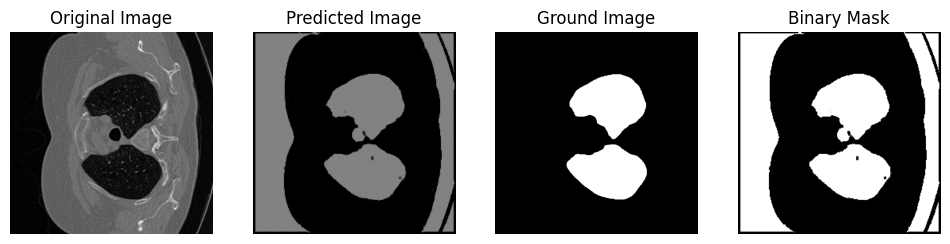

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.21070778369903564


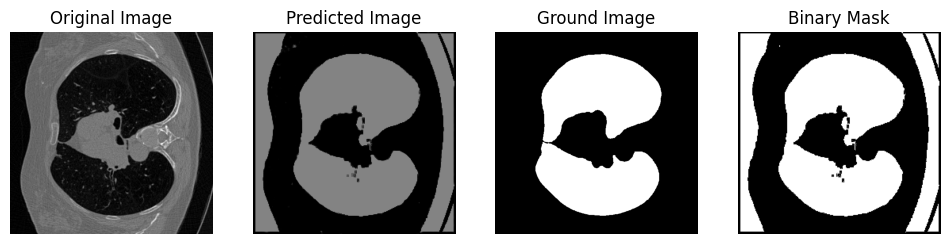

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.4037211537361145


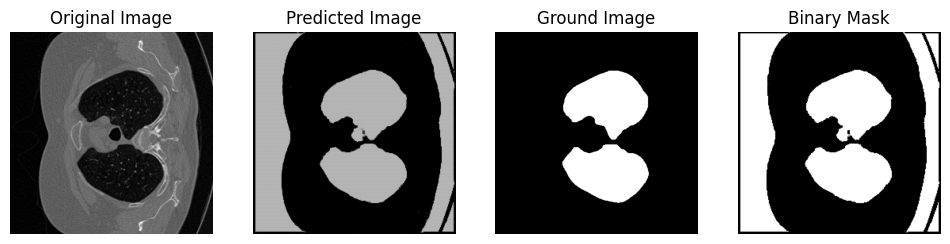

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.1758987307548523


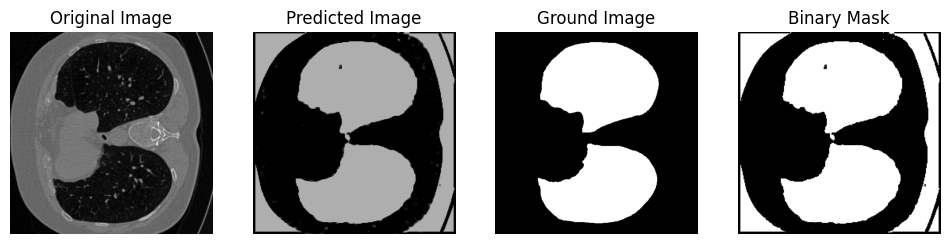

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 1.0


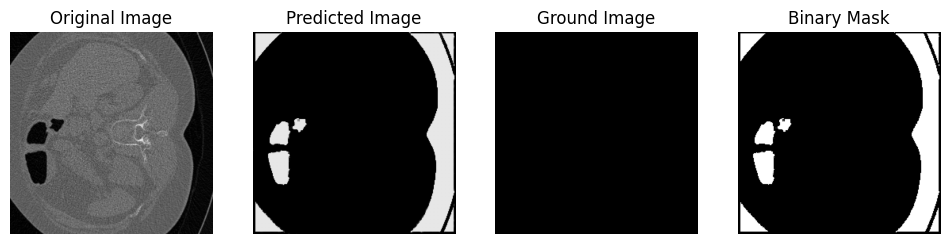

Prediction shape: (1, 512, 512)
input_array shape: torch.Size([1, 512, 512])
Dice : 0.197404682636261


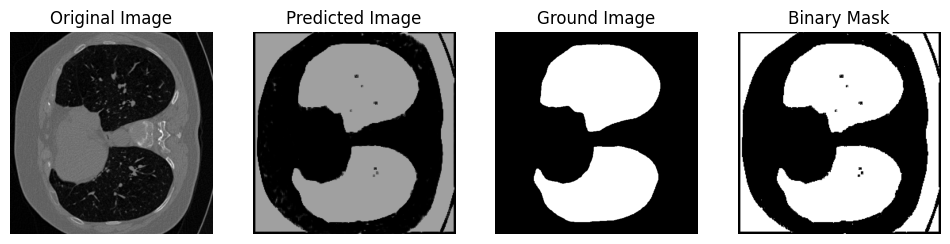

In [ ]:
# inference on validation dataset created above

dice_loss = 0
for i in range(1, len(lung_image_val)):
    # Example usage with a NumPy array
    input_array = lung_image_val[i]  # Replace with your actual input array
    ground_array = lung_label_val[i]  # Replace with your actual input array
    prediction = predict(model_small, input_array)

    # Convert NumPy arrays to PyTorch tensors
    # input_array = torch.from_numpy(input_array).float()
    # ground_array = torch.from_numpy(ground_array).float()

    # prediction = np.expand_dims(prediction, axis=0)
    input_array = input_array.unsqueeze(0)
    print("Prediction shape:", prediction.shape)
    print("input_array shape:", input_array.shape)

    input_array = transform(input_array)
    # Convert to binary mask (assuming a threshold of 0.5)
    binary_mask = (prediction > 0.3).astype(np.uint8)
    dice = loss_dice(torch.from_numpy(binary_mask).float(), ground_array).item()
    print("Dice :", dice)
    dice_loss += dice
    plt.figure(figsize=(12, 4))

    # Original image
    plt.subplot(1, 4, 1)
    plt.imshow(input_array.squeeze(), cmap='gray')  # Use cmap='gray' for grayscale images
    plt.title('Original Image')
    plt.axis('off')

    # Predicted image
    plt.subplot(1, 4, 2)
    plt.imshow(prediction.squeeze(), cmap='gray')  # Use cmap='gray' for grayscale images
    plt.title('Predicted Image')
    plt.axis('off')

    # Ground image
    plt.subplot(1, 4, 3)
    plt.imshow(ground_array.squeeze(), cmap='gray')  # Use cmap='gray' for grayscale images
    plt.title('Ground Image')
    plt.axis('off')

    # Binary image
    plt.subplot(1, 4, 4)
    plt.imshow(binary_mask.squeeze(), cmap='gray')
    plt.title('Binary Mask')
    plt.axis('off')

    plt.show()


In [ ]:
print("Average Dice Loss :", dice_loss/len(lung_image_val))

Average Dice Loss : 0.5010708261419226


This simple models prediction is not that good

#**UNET MODEL**

In [ ]:
import torch
from torch.utils.data import Dataset
from torch.utils.data import DataLoader

# creating dataset
class LungDataset(Dataset):
    def __init__(self, X, y):
        self.X = X
        self.y = y

    def __len__(self):
        return len(self.X)

    def __getitem__(self, idx):
        input_data = self.X[idx].unsqueeze(0)
        target = self.y[idx].unsqueeze(0)
        return input_data, target



lung_dataset = LungDataset(X_train, y_train)

# Assuming you want to use batch_size = 32
batch_size = 4

# train_loader = DataLoader(dataset=lung_dataset, batch_size=batch_size, shuffle=True)


###
The U-Net architecture is widely used for image segmentation tasks, and it has become a popular choice due to its effectiveness in various medical image analysis applications

U-Shape Architecture:

U-Net gets its name from its U-shaped architecture, which consists of a contracting path (encoder) followed by an expansive path (decoder).
The contracting path captures context and reduces spatial dimensions, while the expansive path enables precise localization.
Skip Connections:

U-Net introduces skip connections that connect the encoder's feature maps to the corresponding decoder's feature maps.
Skip connections help in preserving spatial information during the downsampling process and aid in better segmentation accuracy.
Effective for Limited Data:

U-Net is known for its ability to perform well even when trained on a relatively small dataset, making it suitable for medical imaging where acquiring large annotated datasets can be challenging.
Semantic Segmentation:

U-Net is designed for semantic segmentation tasks, where the goal is to classify each pixel in an image into different classes.
It is widely used in medical image segmentation tasks, such as segmenting organs, tumors, or other structures in medical scans.
Adaptability:

U-Net can be adapted to handle different input modalities, such as multi-channel images, 3D data, or variations in network architecture based on specific requirements.
Proven Success in Competitions:

The U-Net architecture has demonstrated success in various challenges and competitions related to medical image analysis, attracting attention and adoption in the research community.
Versatility:

U-Net can be modified and extended to address specific segmentation challenges. Researchers have proposed variations, including 3D U-Net, attention mechanisms, and more, to enhance performance in different scenarios.

In [22]:
""" Full assembly of the parts to form the complete network """
""" Parts of the U-Net model """

import torch
import torch.nn as nn
import torch.nn.functional as F


class DoubleConv(nn.Module):
    """Double convolution block: (convolution => [BN] => ReLU) * 2"""

    def __init__(self, in_channels, out_channels, mid_channels=None):
        super().__init__()

        # If mid_channels is not specified, set it to out_channels
        if not mid_channels:
            mid_channels = out_channels

        # Define the double convolution block
        self.double_conv = nn.Sequential(
            nn.Conv2d(in_channels, mid_channels, kernel_size=3, padding=1, bias=False),
            nn.BatchNorm2d(mid_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(mid_channels, out_channels, kernel_size=3, padding=1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        # Forward pass through the double convolution block
        return self.double_conv(x)




class Down(nn.Module):
    """Downscaling with maxpool then double conv"""

    def __init__(self, in_channels, out_channels):
        super().__init__()

        # Define the downscaling block using maxpooling followed by double convolution
        self.maxpool_conv = nn.Sequential(
            nn.MaxPool2d(2),
            DoubleConv(in_channels, out_channels)
        )

    def forward(self, x):
        # Forward pass through the downscaling block
        return self.maxpool_conv(x)


class Up(nn.Module):
    """Upscaling then double conv"""

    def __init__(self, in_channels, out_channels, bilinear=True):
        super().__init__()

        # if bilinear, use the normal convolutions to reduce the number of channels
        if bilinear:
            self.up = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
            self.conv = DoubleConv(in_channels, out_channels, in_channels // 2)
        else:
            self.up = nn.ConvTranspose2d(in_channels, in_channels // 2, kernel_size=2, stride=2)
            self.conv = DoubleConv(in_channels, out_channels)

    def forward(self, x1, x2):
        x1 = self.up(x1)
        # input is CHW
        diffY = x2.size()[2] - x1.size()[2]
        diffX = x2.size()[3] - x1.size()[3]

        x1 = F.pad(x1, [diffX // 2, diffX - diffX // 2,
                        diffY // 2, diffY - diffY // 2])
        x = torch.cat([x2, x1], dim=1)
        return self.conv(x)


class OutConv(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(OutConv, self).__init__()
        self.conv = nn.Conv2d(in_channels, out_channels, kernel_size=1)

    def forward(self, x):
        return self.conv(x)


class UNet(nn.Module):
    def __init__(self, n_channels, n_classes, bilinear=False):
        super(UNet, self).__init__()
        self.n_channels = n_channels
        self.n_classes = n_classes
        self.bilinear = bilinear

        self.inc = (DoubleConv(n_channels, 64))
        self.down1 = (Down(64, 128))
        self.down2 = (Down(128, 256))
        self.down3 = (Down(256, 512))
        factor = 2 if bilinear else 1
        self.down4 = (Down(512, 1024 // factor))
        self.up1 = (Up(1024, 512 // factor, bilinear))
        self.up2 = (Up(512, 256 // factor, bilinear))
        self.up3 = (Up(256, 128 // factor, bilinear))
        self.up4 = (Up(128, 64, bilinear))
        self.outc = (OutConv(64, n_classes))


    def forward(self, x):
        x1 = self.inc(x)
        x2 = self.down1(x1)
        x3 = self.down2(x2)
        x4 = self.down3(x3)
        x5 = self.down4(x4)
        x = self.up1(x5, x4)
        x = self.up2(x, x3)
        x = self.up3(x, x2)
        x = self.up4(x, x1)
        logits = self.outc(x)
        return logits

    def use_checkpointing(self):
        # Apply checkpointing to each layer
        self.inc = torch.utils.checkpoint(self.inc)
        self.down1 = torch.utils.checkpoint(self.down1)
        self.down2 = torch.utils.checkpoint(self.down2)
        self.down3 = torch.utils.checkpoint(self.down3)
        self.down4 = torch.utils.checkpoint(self.down4)
        self.up1 = torch.utils.checkpoint(self.up1)
        self.up2 = torch.utils.checkpoint(self.up2)
        self.up3 = torch.utils.checkpoint(self.up3)
        self.up4 = torch.utils.checkpoint(self.up4)
        self.outc = torch.utils.checkpoint(self.outc)


in_channels = 1
out_channels = 1
model = UNet(in_channels, out_channels)

In [ ]:
from sklearn.model_selection import train_test_split

learning_rate = 0.001
model = model.to(device)
criterion = nn.BCEWithLogitsLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)
num_epochs = 2
files = [f for f in os.listdir(folder_path_labelsTr) if f.endswith('.nii.gz')]
prev_loss = 100
no_of_sets = 1

# data_augmentation = transforms.Compose([
#     transforms.RandomHorizontalFlip(),
#     transforms.RandomRotation(degrees=(-1, 1)),
#     transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0, hue=0)
# ])

loss_lst = []
loss_lst_val = []
for i in range(0, len(files), no_of_sets):
    temp_file = files[i]
    label_path = os.path.join(folder_path_labelsTr, temp_file)
    a = temp_file.split('.nii.gz')
    image_path = folder_path_imagesTr + a[0] + "_0000.nii.gz"
    lung_image = nib.load(image_path).get_fdata()
    img_label = nib.load(label_path).get_fdata()

    for temp_file in files[i+1: i+no_of_sets]:
        label_path = os.path.join(folder_path_labelsTr, temp_file)
        a = temp_file.split('.nii.gz')
        image_path = folder_path_imagesTr + a[0] + "_0000.nii.gz"
        img_label = np.concatenate((img_label, nib.load(label_path).get_fdata()), axis=2)
        lung_image = np.concatenate((lung_image, nib.load(image_path).get_fdata()), axis=2)

    img_label[img_label == 5] = 0
    lung_mask = np.logical_or(img_label == 3, img_label == 4)

    lung_image_train_temp = torch.from_numpy(lung_image).float()  # Input: Original MRI images
    lung_label_train_temp = torch.from_numpy(lung_mask).float()

    lung_image_train_temp = lung_image_train_temp.permute(2, 0, 1)
    lung_label_train_temp = lung_label_train_temp.permute(2, 0, 1)

    lung_image_train, lung_image_val, lung_label_train, lung_label_val = train_test_split(
        lung_image_train_temp, lung_label_train_temp, test_size=0.2, random_state=42)

    lung_dataset_train = LungDataset(lung_image_train, lung_label_train)
    lung_dataset_val = LungDataset(lung_image_val, lung_label_val)

    batch_size = 4
    train_loader = DataLoader(dataset=lung_dataset_train, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(dataset=lung_dataset_val, batch_size=batch_size, shuffle=False)



    # lung_dataset = LungDataset(lung_image_train, lung_label_train)
    # batch_size = 8
    # train_loader = DataLoader(dataset=lung_dataset, batch_size=batch_size, shuffle=True)


    for epoch in tqdm(range(num_epochs)):
        total_loss = 0.0
        num_batches = 0

        for inputs, labels in (train_loader):
            optimizer.zero_grad()
            inputs = inputs.to(device)
            labels = labels.to(device)
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            total_loss += loss.item()
            num_batches += 1

        average_loss = total_loss / num_batches

        # Validation
        model.eval()  # Set the model to evaluation mode
        total_loss_val = 0.0
        num_batches_val = 0

        with torch.no_grad():
            for inputs_val, labels_val in val_loader:
                inputs_val = inputs_val.to(device)
                labels_val = labels_val.to(device)
                outputs_val = model(inputs_val)
                loss_val = criterion(outputs_val, labels_val)
                total_loss_val += loss_val.item()
                num_batches_val += 1

        average_loss_val = total_loss_val / num_batches_val

        print(f'Epoch [{epoch + 1}/{num_epochs}], '
              f'Training Loss: {average_loss/len(val_loader):.4f}, Validation Loss: {average_loss_val/len(train_loader):.4f}')

    loss_lst_val.append(average_loss_val)
    loss_lst.append(average_loss)
    # Save the trained model
    if(prev_loss > average_loss_val):
        prev_loss = average_loss_val
        # torch.save(model.state_dict(), '/content/drive/MyDrive/lungs/lung_segmentation_model_unet_temp.pth')
        torch.save({
            'model_state_dict': model.state_dict(),
            'optimizer_state_dict': optimizer.state_dict()
        }, '/content/drive/MyDrive/lungs/lung_segmentation_model_unet_2.pth')

In [89]:
from sklearn.model_selection import train_test_split

learning_rate = 0.001
model = model.to(device)
criterion = nn.BCEWithLogitsLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)
num_epochs = 2
files = [f for f in os.listdir(folder_path_labelsTr) if f.endswith('.nii.gz')]
prev_loss = 100
no_of_sets = 1

# data_augmentation = transforms.Compose([
#     transforms.RandomHorizontalFlip(),
#     transforms.RandomRotation(degrees=(-1, 1)),
#     transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0, hue=0)
# ])

loss_lst = []
loss_lst_val = []
for i in range(0, len(files), no_of_sets):
    temp_file = files[i]
    label_path = os.path.join(folder_path_labelsTr, temp_file)
    a = temp_file.split('.nii.gz')
    image_path = folder_path_imagesTr + a[0] + "_0000.nii.gz"
    lung_image = nib.load(image_path).get_fdata()
    img_label = nib.load(label_path).get_fdata()

    for temp_file in files[i+1: i+no_of_sets]:
        label_path = os.path.join(folder_path_labelsTr, temp_file)
        a = temp_file.split('.nii.gz')
        image_path = folder_path_imagesTr + a[0] + "_0000.nii.gz"
        img_label = np.concatenate((img_label, nib.load(label_path).get_fdata()), axis=2)
        lung_image = np.concatenate((lung_image, nib.load(image_path).get_fdata()), axis=2)

    img_label[img_label == 5] = 0
    lung_mask = np.logical_or(img_label == 3, img_label == 4)

    lung_image_train_temp = torch.from_numpy(lung_image).float()  # Input: Original MRI images
    lung_label_train_temp = torch.from_numpy(lung_mask).float()

    lung_image_train_temp = lung_image_train_temp.permute(2, 0, 1)
    lung_label_train_temp = lung_label_train_temp.permute(2, 0, 1)

    lung_image_train, lung_image_val, lung_label_train, lung_label_val = train_test_split(
        lung_image_train_temp, lung_label_train_temp, test_size=0.2, random_state=42)

    lung_dataset_train = LungDataset(lung_image_train, lung_label_train)
    lung_dataset_val = LungDataset(lung_image_val, lung_label_val)

    batch_size = 4
    train_loader = DataLoader(dataset=lung_dataset_train, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(dataset=lung_dataset_val, batch_size=batch_size, shuffle=False)



    # lung_dataset = LungDataset(lung_image_train, lung_label_train)
    # batch_size = 8
    # train_loader = DataLoader(dataset=lung_dataset, batch_size=batch_size, shuffle=True)


    for epoch in tqdm(range(num_epochs)):
        total_loss = 0.0
        num_batches = 0

        for inputs, labels in (train_loader):
            optimizer.zero_grad()
            inputs = inputs.to(device)
            labels = labels.to(device)
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            total_loss += loss.item()
            num_batches += 1

        average_loss = total_loss / num_batches

        # Validation
        model.eval()  # Set the model to evaluation mode
        total_loss_val = 0.0
        num_batches_val = 0

        with torch.no_grad():
            for inputs_val, labels_val in val_loader:
                inputs_val = inputs_val.to(device)
                labels_val = labels_val.to(device)
                outputs_val = model(inputs_val)
                loss_val = criterion(outputs_val, labels_val)
                total_loss_val += loss_val.item()
                num_batches_val += 1

        average_loss_val = total_loss_val / num_batches_val

        print(f'Epoch [{epoch + 1}/{num_epochs}], '
              f'Training Loss: {average_loss/len(val_loader):.4f}, Validation Loss: {average_loss_val/len(train_loader):.4f}')

    loss_lst_val.append(average_loss_val)
    loss_lst.append(average_loss)
    # Save the trained model
    if(prev_loss > average_loss_val):
        prev_loss = average_loss_val
        # torch.save(model.state_dict(), '/content/drive/MyDrive/lungs/lung_segmentation_model_unet_temp.pth')
        torch.save({
            'model_state_dict': model.state_dict(),
            'optimizer_state_dict': optimizer.state_dict()
        }, '/content/drive/MyDrive/lungs/lung_segmentation_model_unet_2.pth')

 50%|█████     | 1/2 [00:46<00:46, 46.10s/it]

Epoch [1/2], Training Loss: 0.0023, Validation Loss: 0.0002


100%|██████████| 2/2 [01:32<00:00, 46.33s/it]

Epoch [2/2], Training Loss: 0.0006, Validation Loss: 0.0001



 50%|█████     | 1/2 [01:30<01:30, 90.70s/it]

Epoch [1/2], Training Loss: 0.0302, Validation Loss: 0.0012


100%|██████████| 2/2 [03:01<00:00, 90.73s/it]

Epoch [2/2], Training Loss: 0.0016, Validation Loss: 0.0001



 50%|█████     | 1/2 [01:41<01:41, 101.43s/it]

Epoch [1/2], Training Loss: 0.0004, Validation Loss: 0.0001


100%|██████████| 2/2 [03:22<00:00, 101.28s/it]

Epoch [2/2], Training Loss: 0.0003, Validation Loss: 0.0001



 50%|█████     | 1/2 [01:29<01:29, 89.73s/it]

Epoch [1/2], Training Loss: 0.0002, Validation Loss: 0.0001


100%|██████████| 2/2 [02:59<00:00, 89.68s/it]

Epoch [2/2], Training Loss: 0.0002, Validation Loss: 0.0000



 50%|█████     | 1/2 [00:46<00:46, 46.28s/it]

Epoch [1/2], Training Loss: 0.0007, Validation Loss: 0.0001


100%|██████████| 2/2 [01:32<00:00, 46.04s/it]

Epoch [2/2], Training Loss: 0.0004, Validation Loss: 0.0001



 50%|█████     | 1/2 [00:52<00:52, 52.88s/it]

Epoch [1/2], Training Loss: 0.0086, Validation Loss: 0.0003


100%|██████████| 2/2 [01:45<00:00, 52.71s/it]

Epoch [2/2], Training Loss: 0.0008, Validation Loss: 0.0001



 50%|█████     | 1/2 [00:55<00:55, 55.22s/it]

Epoch [1/2], Training Loss: 0.1245, Validation Loss: 0.0096


100%|██████████| 2/2 [01:49<00:00, 54.82s/it]

Epoch [2/2], Training Loss: 0.0369, Validation Loss: 0.0089



 50%|█████     | 1/2 [00:35<00:35, 35.84s/it]

Epoch [1/2], Training Loss: 0.0493, Validation Loss: 0.0121


100%|██████████| 2/2 [01:11<00:00, 35.74s/it]

Epoch [2/2], Training Loss: 0.0469, Validation Loss: 0.0115



 50%|█████     | 1/2 [00:25<00:25, 25.75s/it]

Epoch [1/2], Training Loss: 0.0633, Validation Loss: 0.0180


100%|██████████| 2/2 [00:51<00:00, 25.81s/it]

Epoch [2/2], Training Loss: 0.0624, Validation Loss: 0.0178



 50%|█████     | 1/2 [00:38<00:38, 38.29s/it]

Epoch [1/2], Training Loss: 0.0417, Validation Loss: 0.0107


100%|██████████| 2/2 [01:16<00:00, 38.08s/it]

Epoch [2/2], Training Loss: 0.0406, Validation Loss: 0.0104



 50%|█████     | 1/2 [00:29<00:29, 29.10s/it]

Epoch [1/2], Training Loss: 0.0478, Validation Loss: 0.0135


100%|██████████| 2/2 [00:58<00:00, 29.31s/it]

Epoch [2/2], Training Loss: 0.0469, Validation Loss: 0.0132



 50%|█████     | 1/2 [00:45<00:45, 45.52s/it]

Epoch [1/2], Training Loss: 0.0367, Validation Loss: 0.0095


100%|██████████| 2/2 [01:30<00:00, 45.44s/it]

Epoch [2/2], Training Loss: 0.0364, Validation Loss: 0.0094



 50%|█████     | 1/2 [01:47<01:47, 107.16s/it]

Epoch [1/2], Training Loss: 0.0181, Validation Loss: 0.0044


100%|██████████| 2/2 [03:34<00:00, 107.15s/it]

Epoch [2/2], Training Loss: 0.0180, Validation Loss: 0.0044



 50%|█████     | 1/2 [01:25<01:25, 85.85s/it]

Epoch [1/2], Training Loss: 0.0200, Validation Loss: 0.0047


100%|██████████| 2/2 [02:51<00:00, 85.86s/it]

Epoch [2/2], Training Loss: 0.0199, Validation Loss: 0.0047



 50%|█████     | 1/2 [00:35<00:35, 35.63s/it]

Epoch [1/2], Training Loss: 0.0397, Validation Loss: 0.0107


100%|██████████| 2/2 [01:11<00:00, 35.67s/it]

Epoch [2/2], Training Loss: 0.0393, Validation Loss: 0.0106



 50%|█████     | 1/2 [00:24<00:24, 24.27s/it]

Epoch [1/2], Training Loss: 0.0588, Validation Loss: 0.0140


100%|██████████| 2/2 [00:48<00:00, 24.22s/it]

Epoch [2/2], Training Loss: 0.0582, Validation Loss: 0.0140



 50%|█████     | 1/2 [01:28<01:28, 88.07s/it]

Epoch [1/2], Training Loss: 0.0212, Validation Loss: 0.0048


100%|██████████| 2/2 [02:55<00:00, 87.78s/it]

Epoch [2/2], Training Loss: 0.0213, Validation Loss: 0.0048



 50%|█████     | 1/2 [00:24<00:24, 24.35s/it]

Epoch [1/2], Training Loss: 0.0457, Validation Loss: 0.0110


100%|██████████| 2/2 [00:48<00:00, 24.21s/it]

Epoch [2/2], Training Loss: 0.0450, Validation Loss: 0.0108



 50%|█████     | 1/2 [00:46<00:46, 46.25s/it]

Epoch [1/2], Training Loss: 0.0292, Validation Loss: 0.0075


100%|██████████| 2/2 [01:32<00:00, 46.23s/it]

Epoch [2/2], Training Loss: 0.0289, Validation Loss: 0.0074



 50%|█████     | 1/2 [00:32<00:32, 32.17s/it]

Epoch [1/2], Training Loss: 0.0391, Validation Loss: 0.0093


100%|██████████| 2/2 [01:04<00:00, 32.14s/it]

Epoch [2/2], Training Loss: 0.0388, Validation Loss: 0.0092



 50%|█████     | 1/2 [00:35<00:35, 35.24s/it]

Epoch [1/2], Training Loss: 0.0428, Validation Loss: 0.0121


100%|██████████| 2/2 [01:10<00:00, 35.27s/it]

Epoch [2/2], Training Loss: 0.0427, Validation Loss: 0.0121



 50%|█████     | 1/2 [00:28<00:28, 28.33s/it]

Epoch [1/2], Training Loss: 0.0503, Validation Loss: 0.0118


100%|██████████| 2/2 [00:56<00:00, 28.40s/it]

Epoch [2/2], Training Loss: 0.0499, Validation Loss: 0.0118



  0%|          | 0/2 [00:18<?, ?it/s]


KeyboardInterrupt: ignored

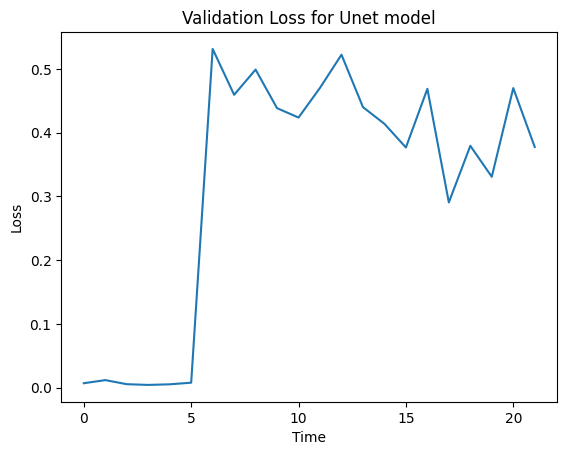

In [92]:
plot_list(loss_lst_val, "Validation Loss for Unet model")

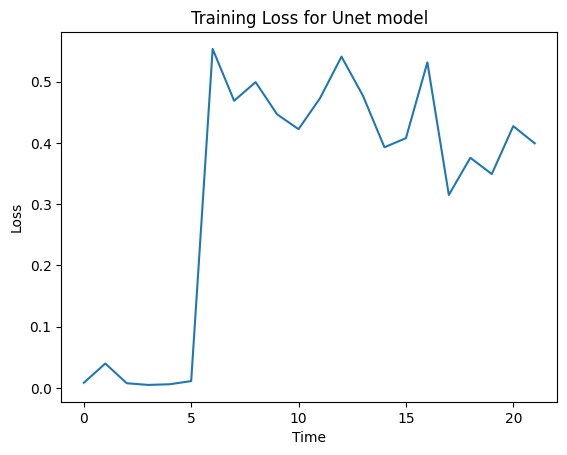

In [93]:
plot_list(loss_lst, "Training Loss for Unet model")

In [94]:
# torch.save(model.state_dict(), '/content/drive/MyDrive/lungs/lung_segmentation_model_unet_1.pth')  # to save the model

torch.save({
            'model_state_dict': model.state_dict(),
            'optimizer_state_dict': optimizer.state_dict()
        }, '/content/drive/MyDrive/lungs/lung_segmentation_model_unet_2.pth')

In [24]:
# # loading the pretrained model

# model = UNet(1,1)
# model_path = '/content/drive/MyDrive/lungs/lung_segmentation_model_unet.pth'
# model_state_dict = torch.load(model_path, map_location=torch.device('cpu'))
# model.load_state_dict(model_state_dict)
# # model.eval()

<All keys matched successfully>

In [95]:
def predict(model, input_array):
    if len(input_array.shape) == 2:
        input_array = input_array[None, None, ...]  # Add batch and channel dimensions
    elif len(input_array.shape) == 3:
        input_array = input_array[None, ...]  # Add batch dimension

    # input_tensor = torch.tensor(input_array, dtype=torch.float32).to(device)
    input_tensor = input_array.to(device)
    with torch.no_grad():
        model_output = model(input_tensor)

    predicted_probs = torch.sigmoid(model_output)
    return predicted_probs.cpu().numpy()



def loss_dice(pred, target):
    smooth = 1e-5

    pred_flat = torch.tensor(pred.flatten(), dtype=torch.float32)
    target_flat = torch.tensor(target.flatten(), dtype=torch.float32)

    intersection = torch.sum(pred_flat * target_flat)
    union = torch.sum(pred_flat) + torch.sum(target_flat)

    dice = (2.0 * intersection + smooth) / (union + smooth)
    return 1 - dice.item()


On Mask value of 0.2

<ipython-input-40-0622e93eecfb>:4: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  prediction = predict(model, torch.tensor(input_array, dtype=torch.float32))
<ipython-input-39-825bcd3c7bd3>:21: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_flat = torch.tensor(target.flatten(), dtype=torch.float32)


Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.9999999927166789


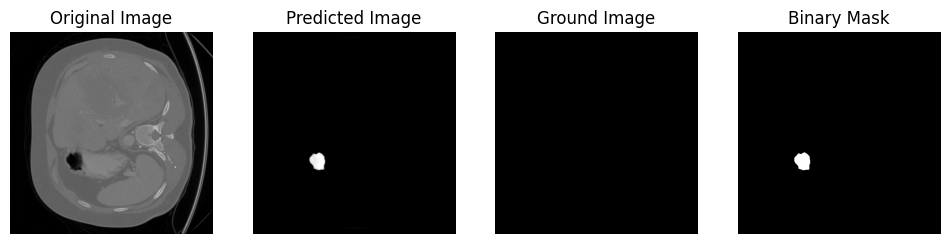

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.01982206106185913


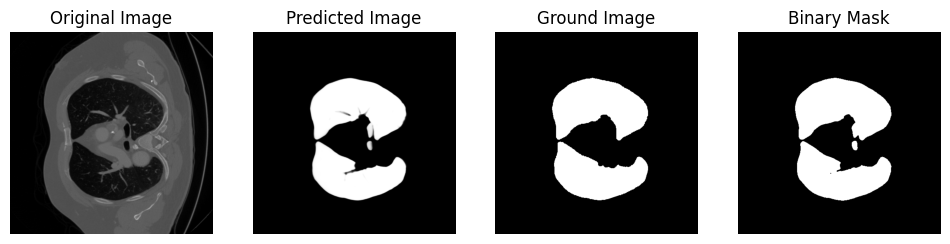

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.02087610960006714


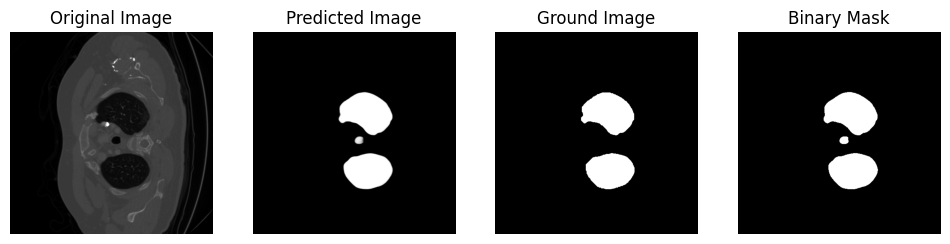

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.014016389846801758


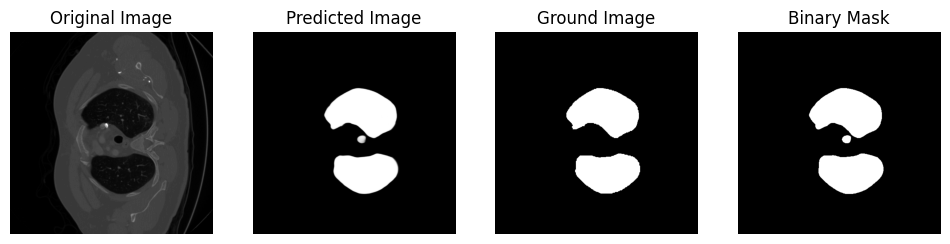

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.01156395673751831


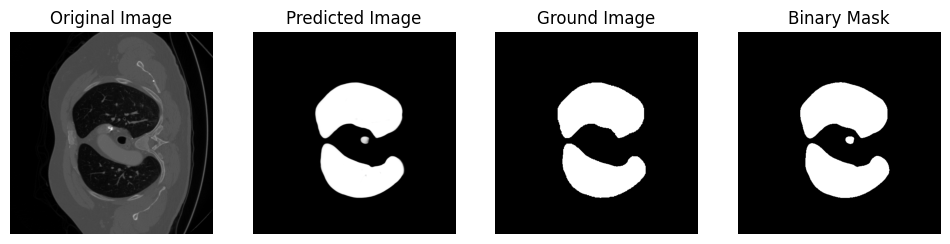

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.013243496417999268


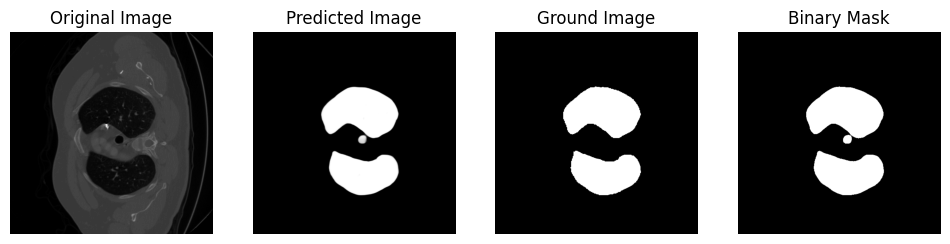

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.00934690237045288


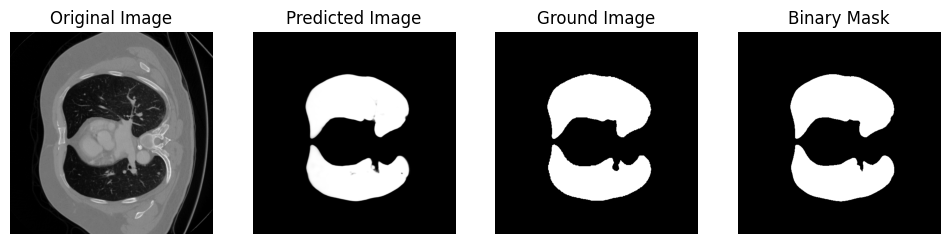

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.9999999907321593


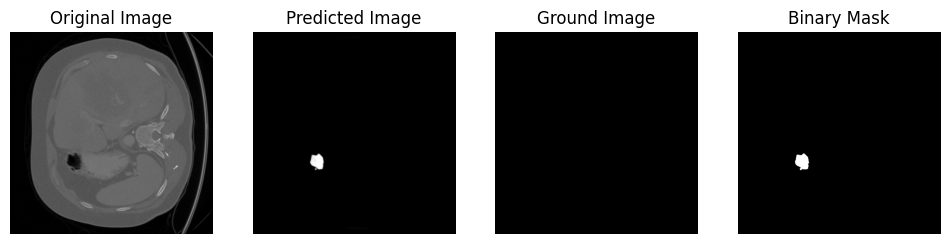

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.01305997371673584


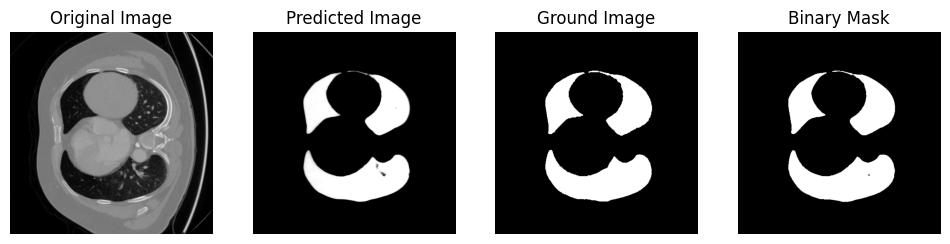

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.02426689863204956


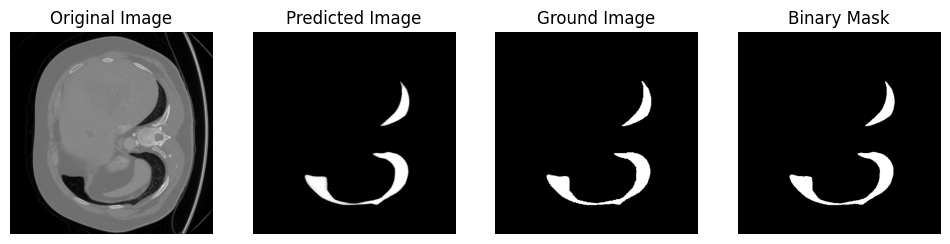

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.018337786197662354


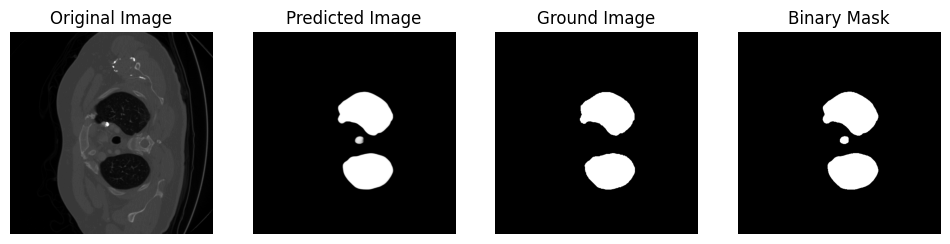

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.01022106409072876


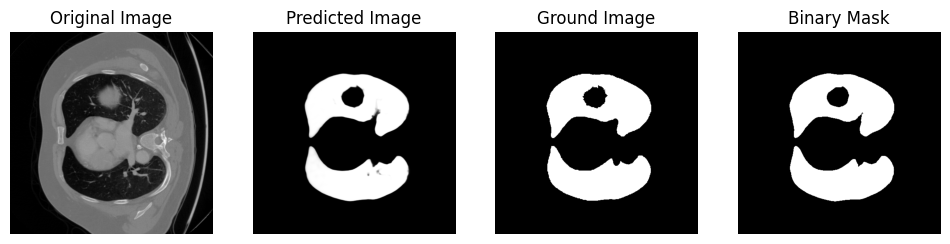

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.010915756225585938


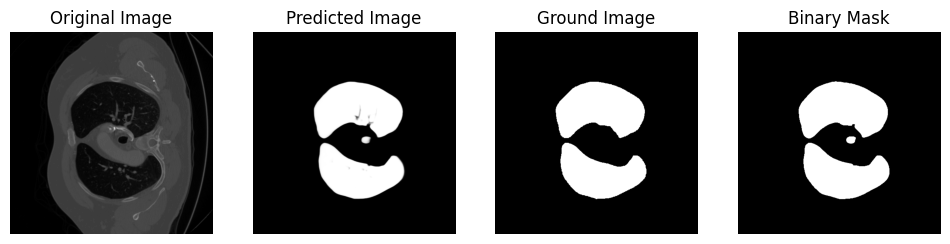

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.009689569473266602


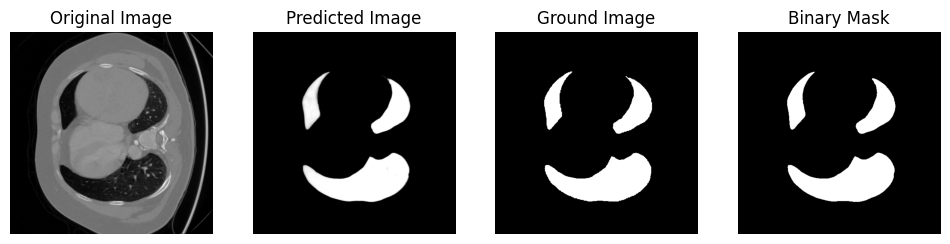

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.01515263319015503


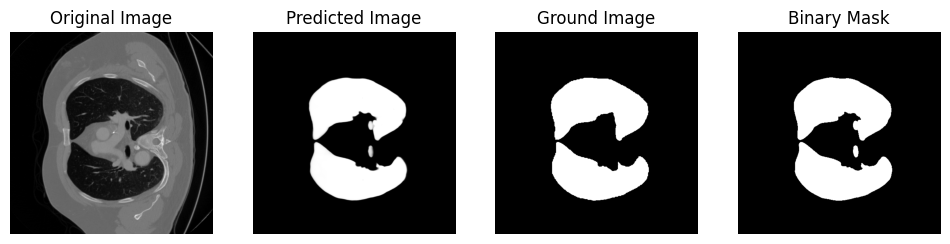

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.013808369636535645


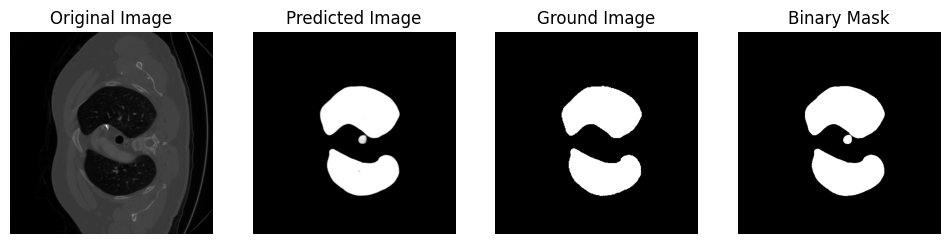

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.999999972752045


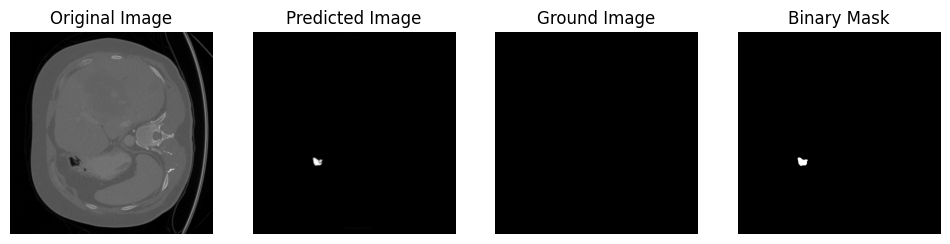

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.015637338161468506


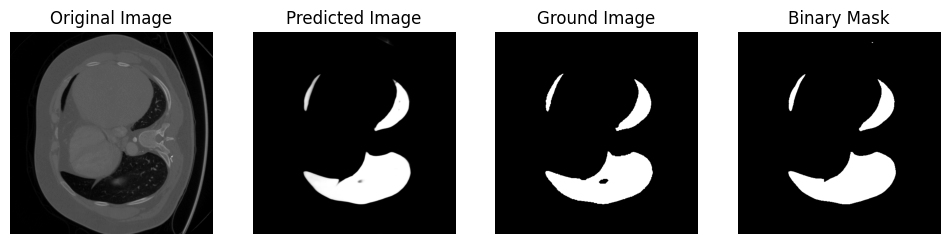

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.017340779304504395


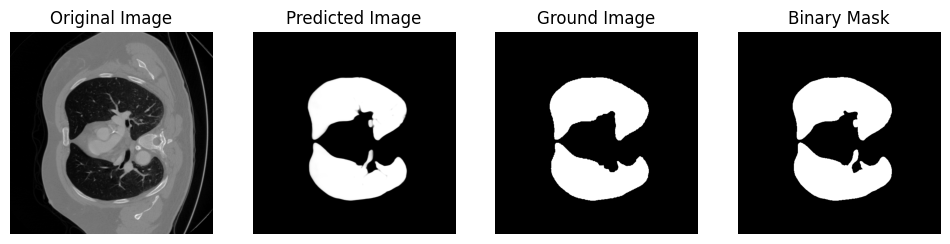

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.03283137083053589


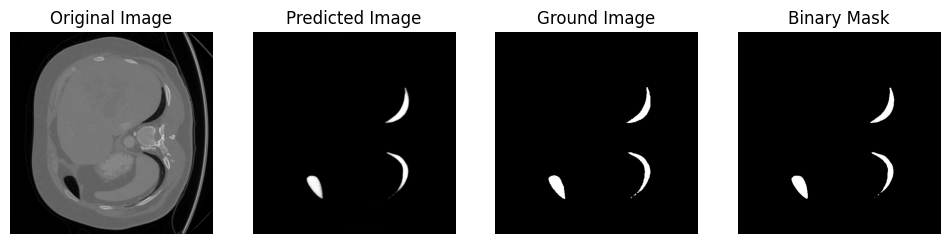

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.10823911428451538


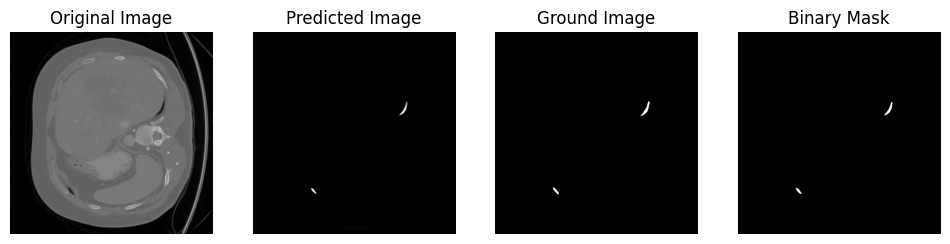

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.010278940200805664


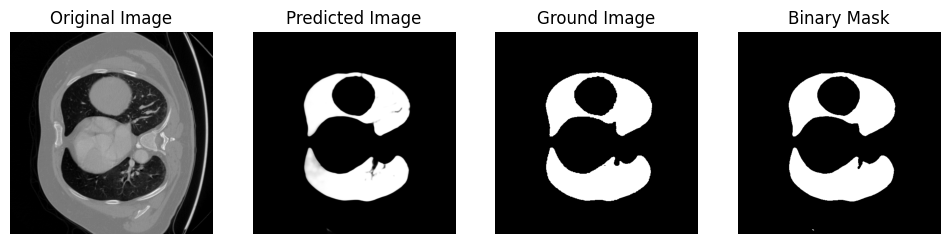

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.03637808561325073


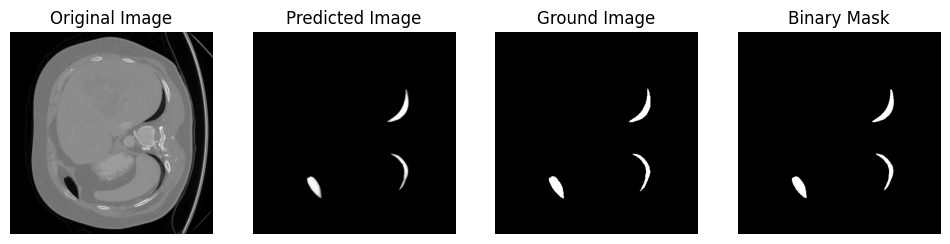

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.01513063907623291


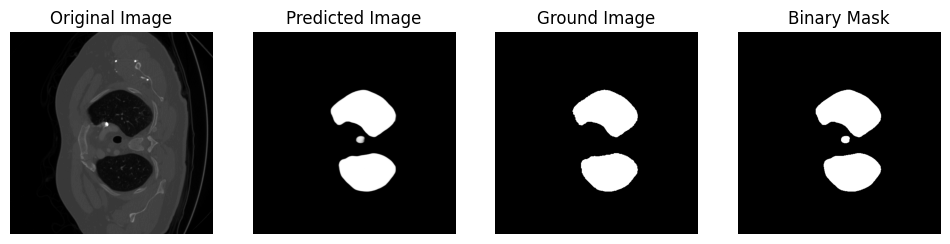

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.008602023124694824


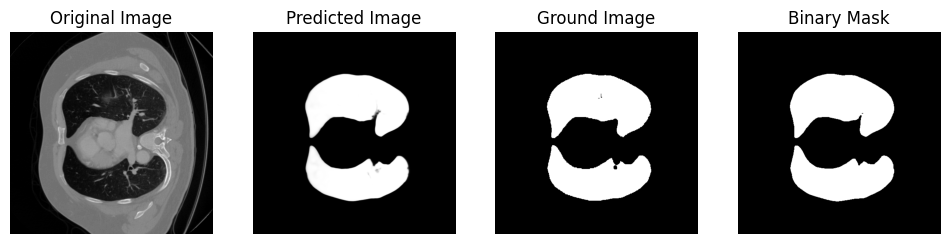

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.9999999895506795


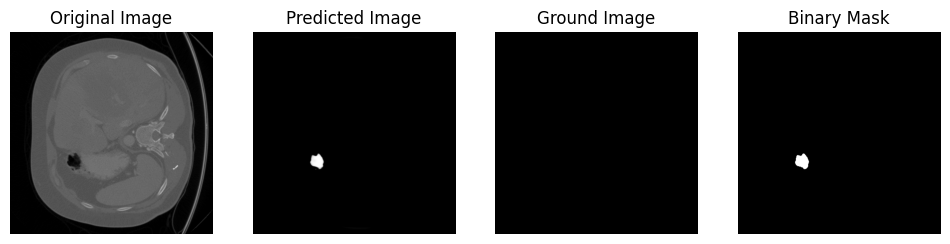

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.013058781623840332


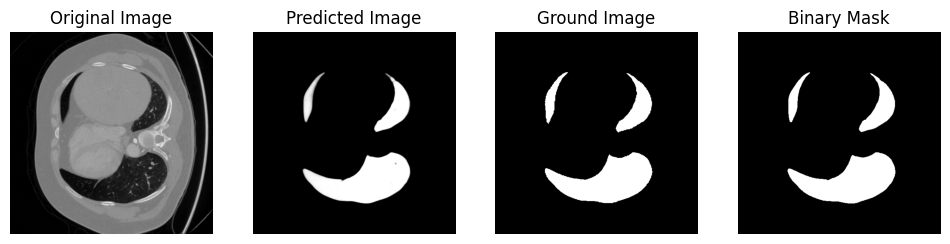

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.018036603927612305


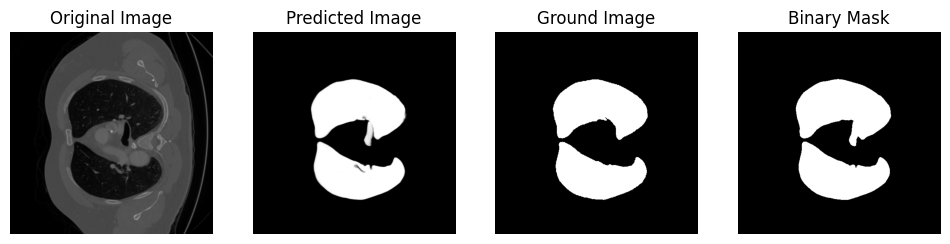

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.01997542381286621


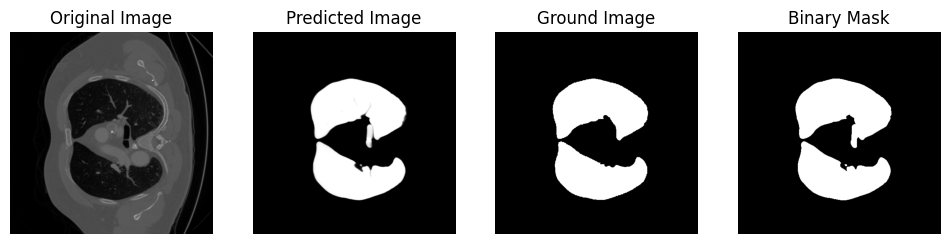

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.011836886405944824


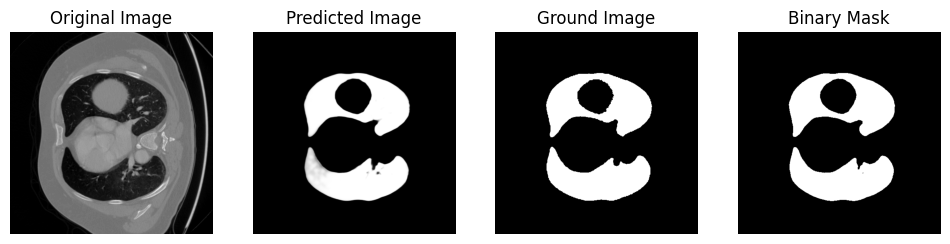

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.02957361936569214


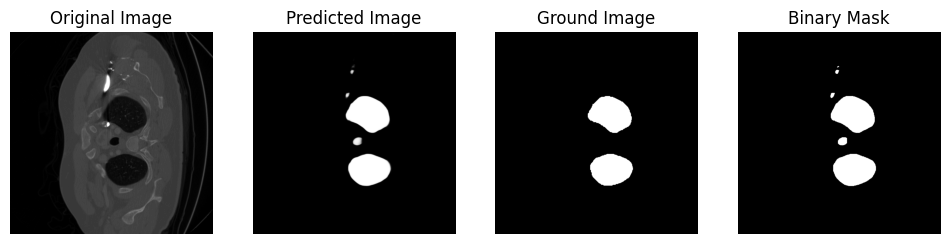

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.05940592288970947


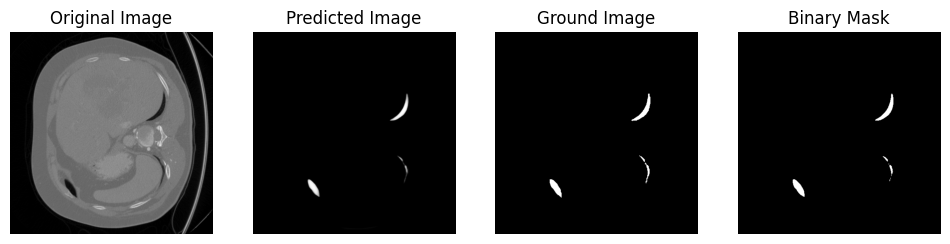

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.025983154773712158


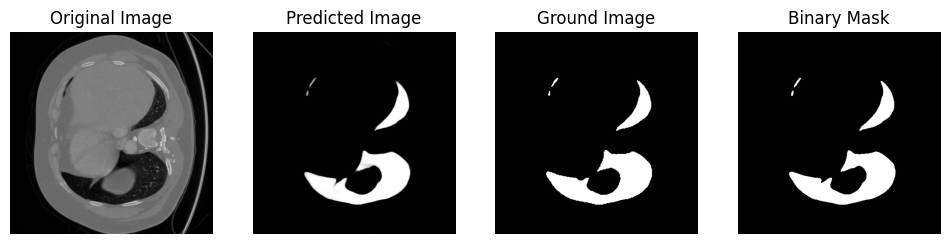

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.36868685483932495


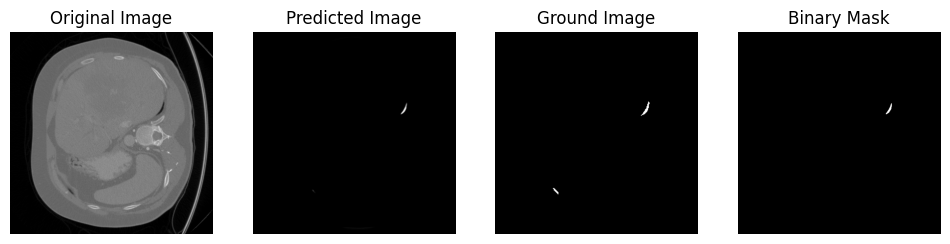

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.018005967140197754


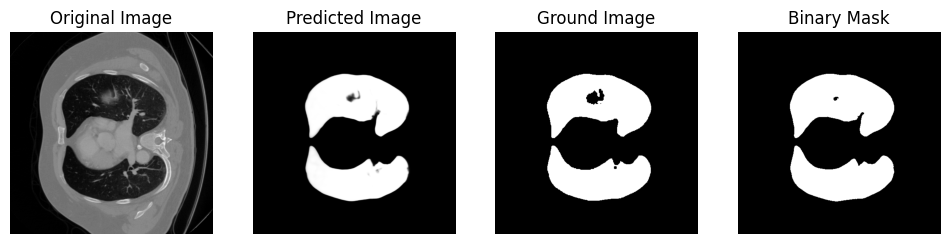

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.010214567184448242


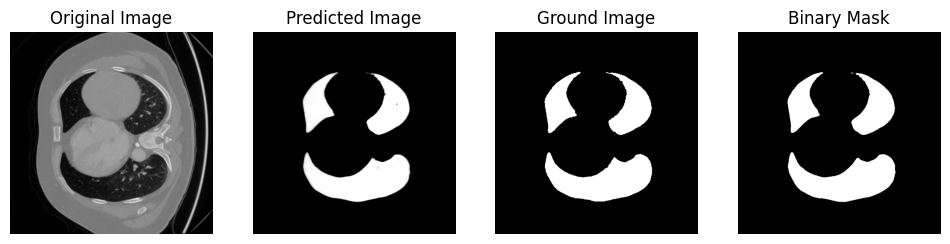

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.01641446352005005


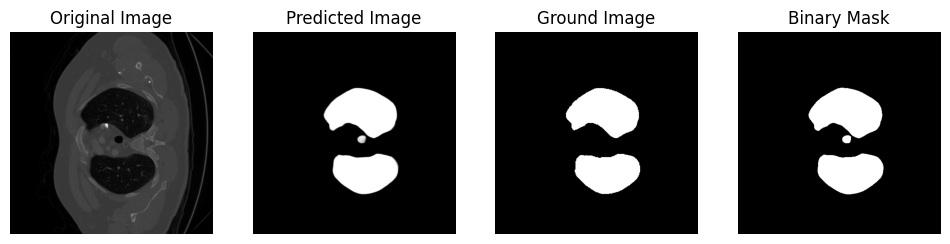

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.016161680221557617


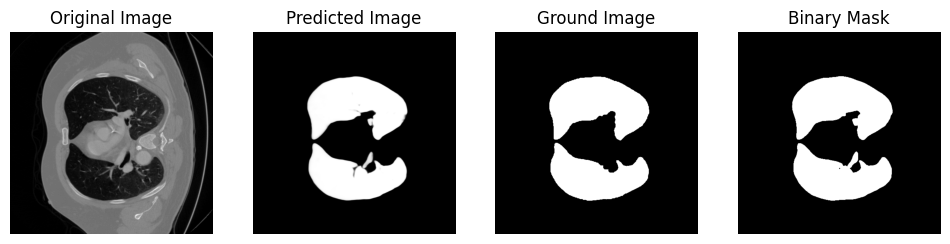

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.999999989350373


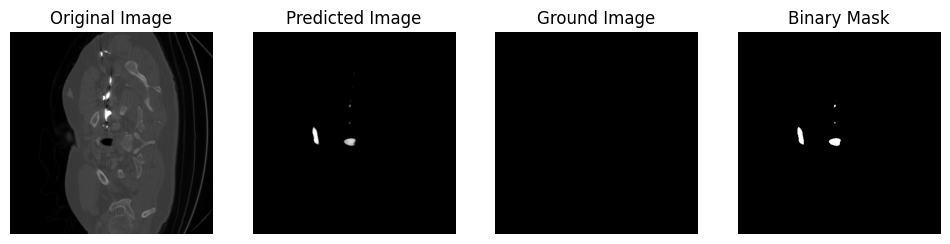

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.01042938232421875


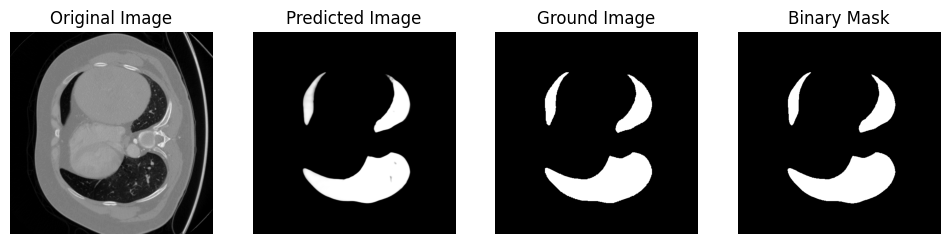

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.010042786598205566


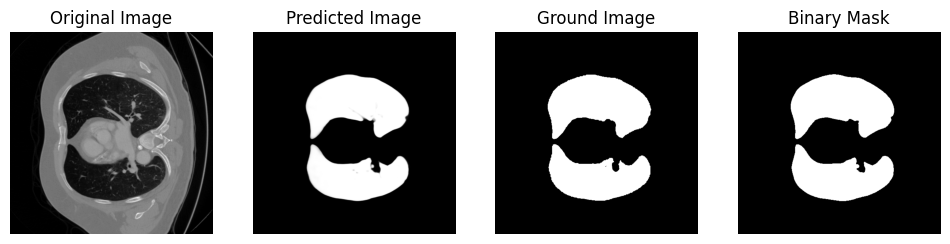

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.010643362998962402


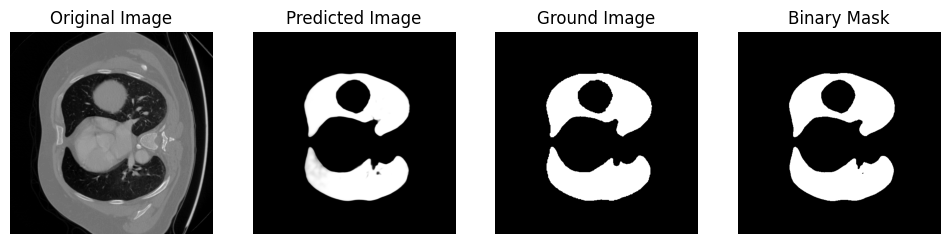

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.999999946808515


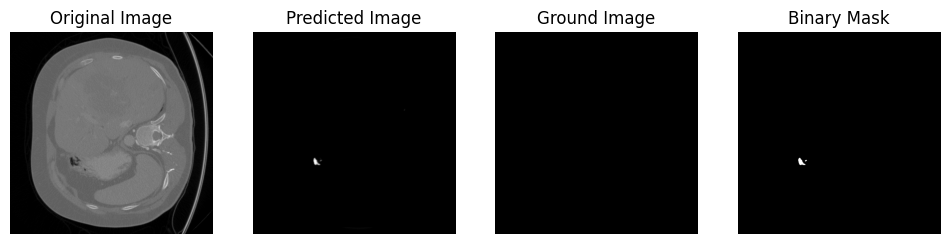

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.015077412128448486


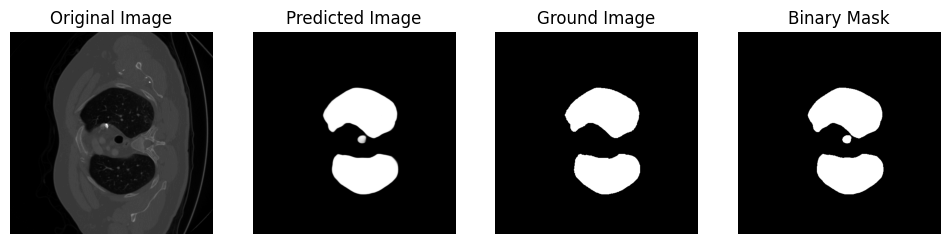

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.011266171932220459


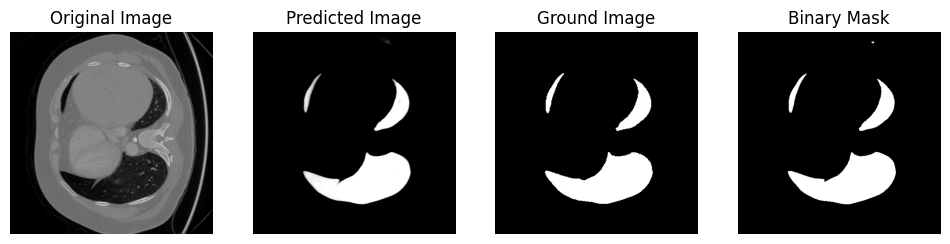

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.014607131481170654


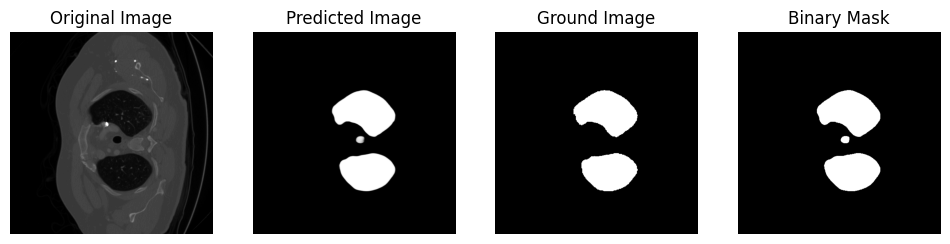

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.028888702392578125


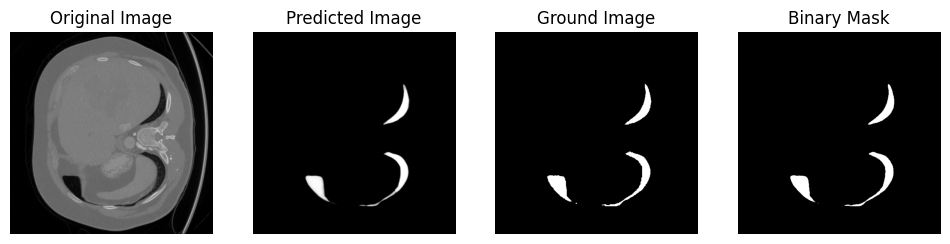

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.014064490795135498


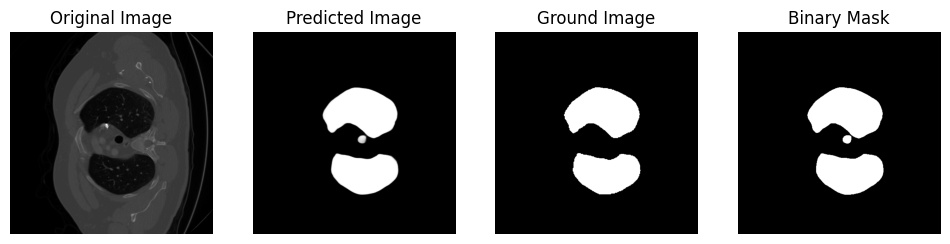

In [40]:

for i in range(1, len(lung_image_val)):
    input_array = lung_image_val[i]
    ground_array = lung_label_val[i]
    prediction = predict(model, torch.tensor(input_array, dtype=torch.float32))

    input_array = np.expand_dims(input_array, axis=0)

    print("Prediction shape:", prediction.shape)
    print("input_array shape:", input_array.shape)

    # Convert to binary mask (assuming a threshold of 0.5)
    binary_mask = (prediction > 0.2).astype(np.uint8)
    print("Dice :", loss_dice(binary_mask, ground_array))

    # Plot the original image, ground truth, and predicted image
    plt.figure(figsize=(12, 4))

    # Original image
    plt.subplot(1, 4, 1)
    plt.imshow(input_array.squeeze(), cmap='gray')  # Use cmap='gray' for grayscale images
    plt.title('Original Image')
    plt.axis('off')

    # Predicted image
    plt.subplot(1, 4, 2)
    plt.imshow(prediction.squeeze(), cmap='gray')  # Use cmap='gray' for grayscale images
    plt.title('Predicted Image')
    plt.axis('off')

    # Ground image
    plt.subplot(1, 4, 3)
    plt.imshow(ground_array.squeeze(), cmap='gray')  # Use cmap='gray' for grayscale images
    plt.title('Ground Image')
    plt.axis('off')

    # Binary image
    plt.subplot(1, 4, 4)
    plt.imshow(binary_mask.squeeze(), cmap='gray')
    plt.title('Binary Mask')
    plt.axis('off')

    plt.show()


In [41]:
total = 0
for i in range(1, len(lung_image_val)):
    # Example usage with a NumPy array
    input_array = lung_image_val[i]  # Replace with your actual input array
    ground_array = lung_label_val[i]  # Replace with your actual input array
    prediction = predict(model, input_array)
    input_array = np.expand_dims(input_array, axis=0)
    binary_mask = (prediction > 0.2).astype(np.uint8)
    losss = loss_dice(binary_mask, ground_array)
    total += losss
    print("Dice :", losss)

print("Average loss :", total/len(lung_image_val))


<ipython-input-39-825bcd3c7bd3>:21: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_flat = torch.tensor(target.flatten(), dtype=torch.float32)


Dice : 0.9999999927166789
Dice : 0.01982206106185913
Dice : 0.02087610960006714
Dice : 0.014016389846801758
Dice : 0.01156395673751831
Dice : 0.013243496417999268
Dice : 0.00934690237045288
Dice : 0.9999999907321593
Dice : 0.01305997371673584
Dice : 0.02426689863204956
Dice : 0.018337786197662354
Dice : 0.01022106409072876
Dice : 0.010915756225585938
Dice : 0.009689569473266602
Dice : 0.01515263319015503
Dice : 0.013808369636535645
Dice : 0.999999972752045
Dice : 0.015637338161468506
Dice : 0.017340779304504395
Dice : 0.03283137083053589
Dice : 0.10823911428451538
Dice : 0.010278940200805664
Dice : 0.03637808561325073
Dice : 0.01513063907623291
Dice : 0.008602023124694824
Dice : 0.9999999895506795
Dice : 0.013058781623840332
Dice : 0.018036603927612305
Dice : 0.01997542381286621
Dice : 0.011836886405944824
Dice : 0.02957361936569214
Dice : 0.05940592288970947
Dice : 0.025983154773712158
Dice : 0.36868685483932495
Dice : 0.018005967140197754
Dice : 0.010214567184448242
Dice : 0.01641446

On Mask value of 0.4

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.9999999923954377


<ipython-input-39-825bcd3c7bd3>:21: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_flat = torch.tensor(target.flatten(), dtype=torch.float32)


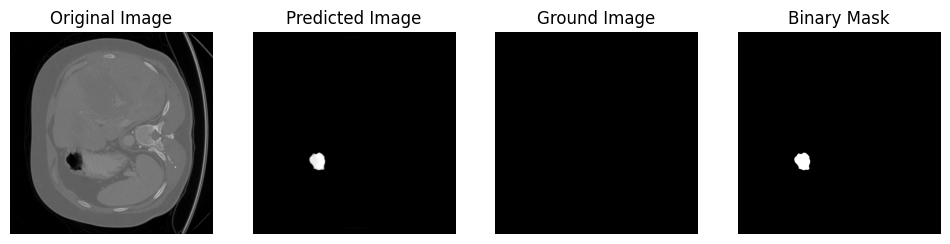

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.01781374216079712


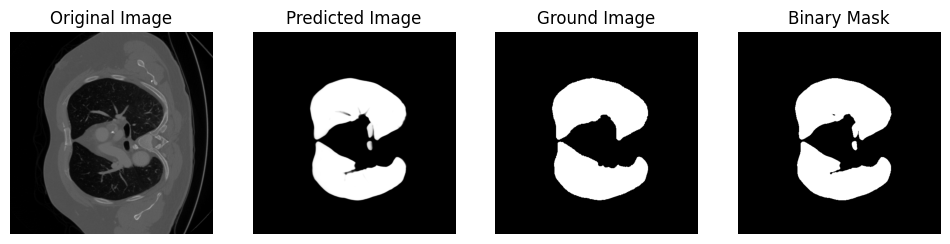

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.016263246536254883


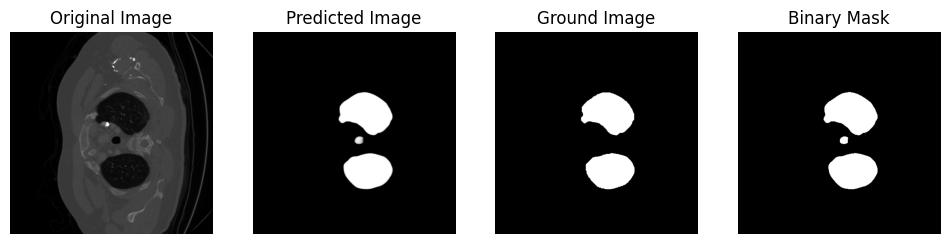

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.011561214923858643


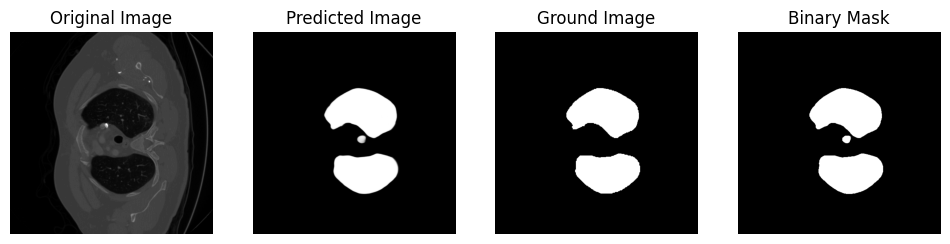

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.008844852447509766


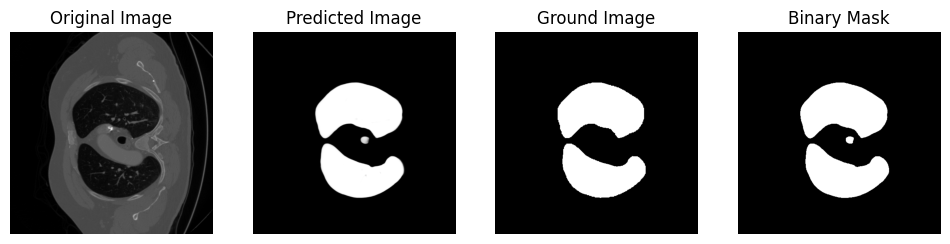

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.012594401836395264


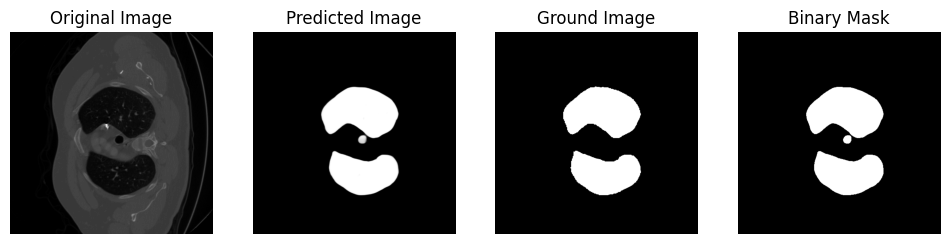

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.00844120979309082


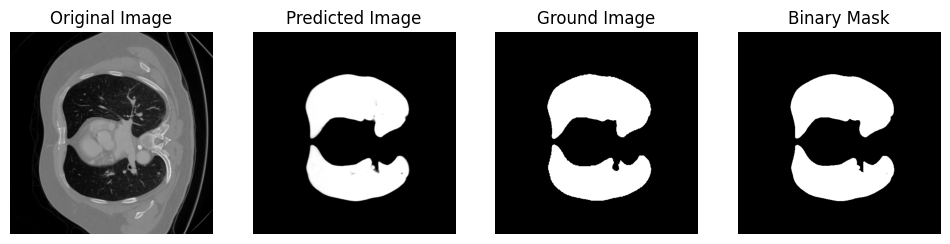

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.9999999901864571


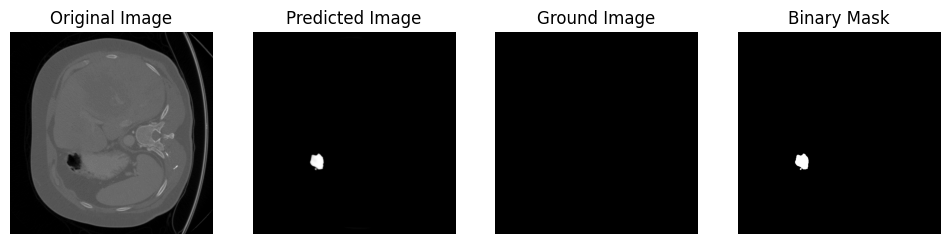

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.014799296855926514


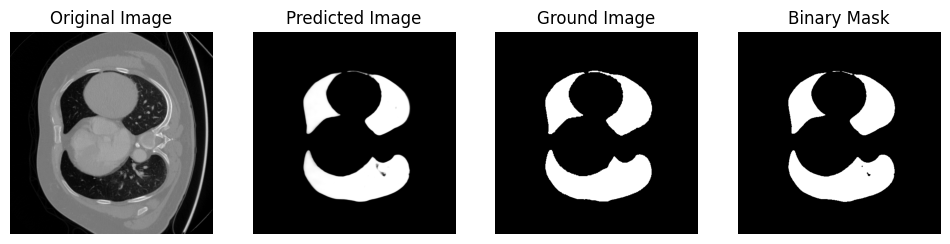

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.02823960781097412


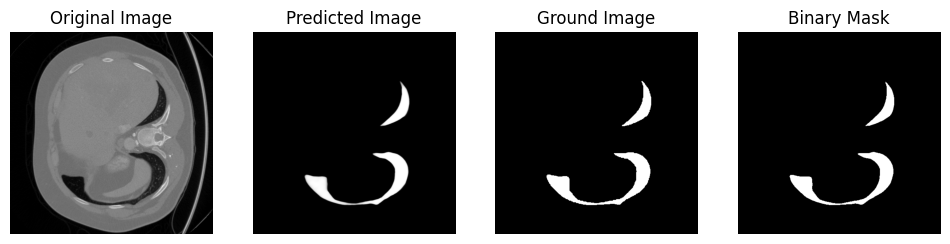

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.014198899269104004


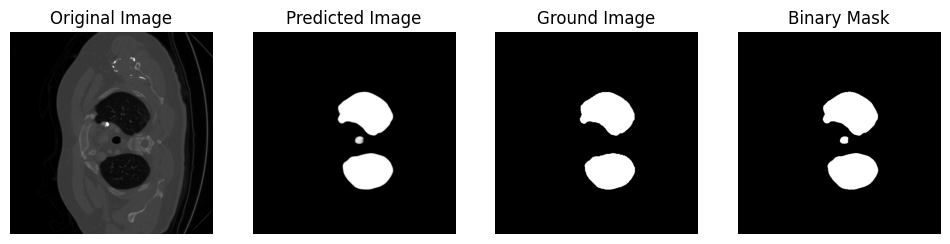

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.009372949600219727


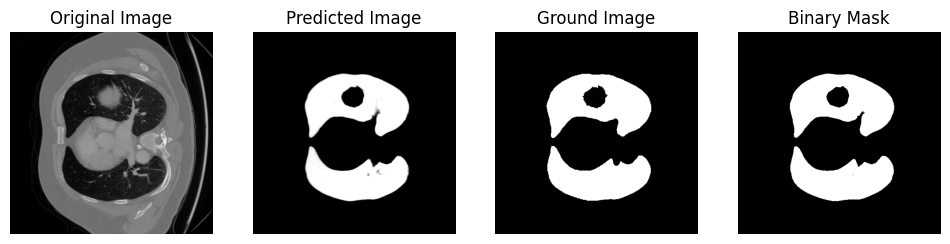

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.009693384170532227


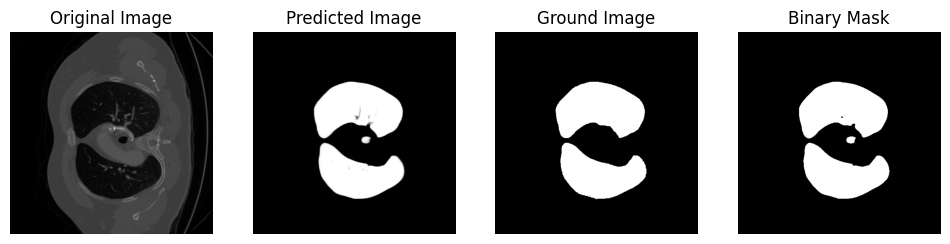

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.01021045446395874


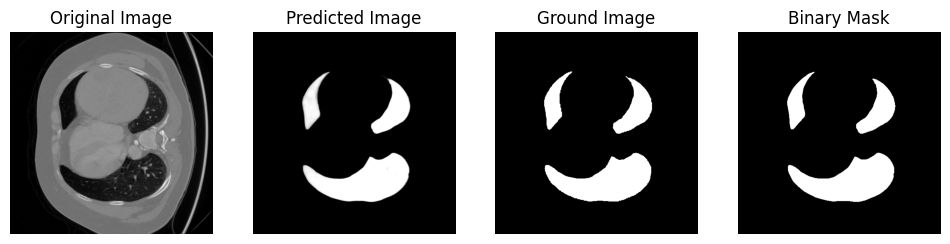

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.013796448707580566


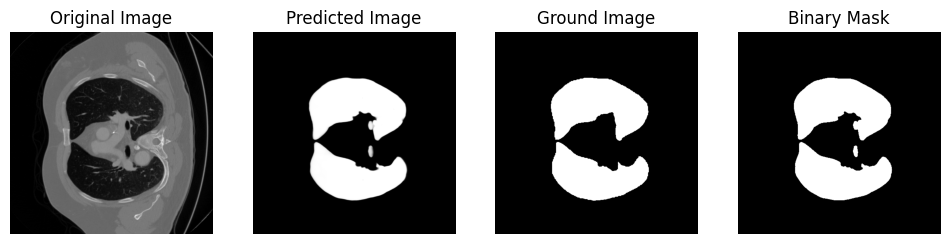

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.013164639472961426


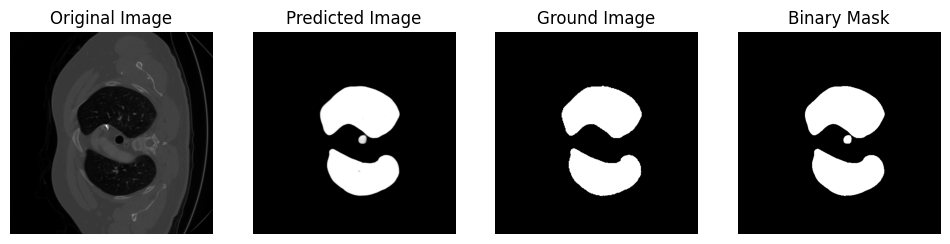

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.9999999698795179


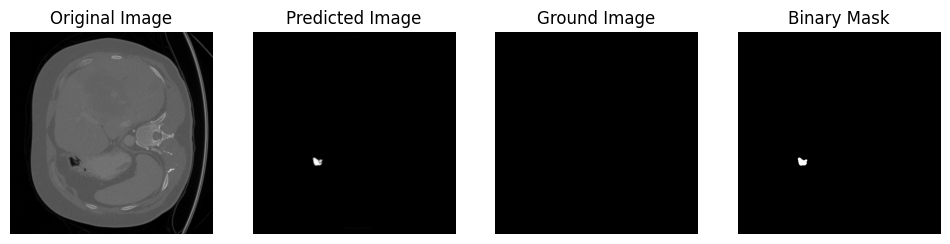

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.016266942024230957


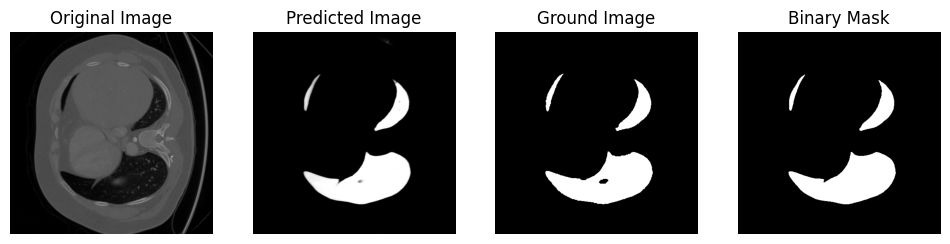

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.014776766300201416


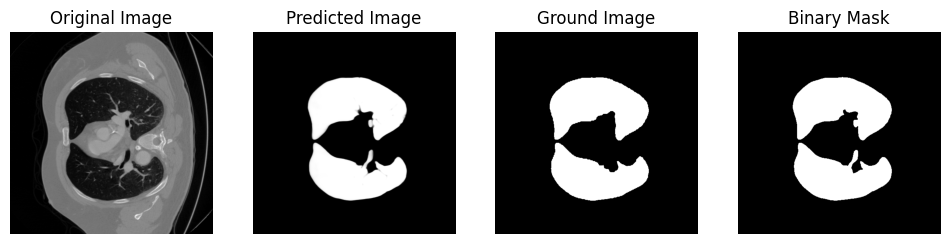

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.04642540216445923


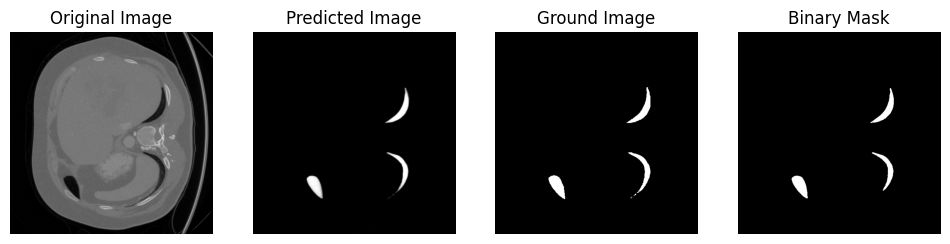

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.19349002838134766


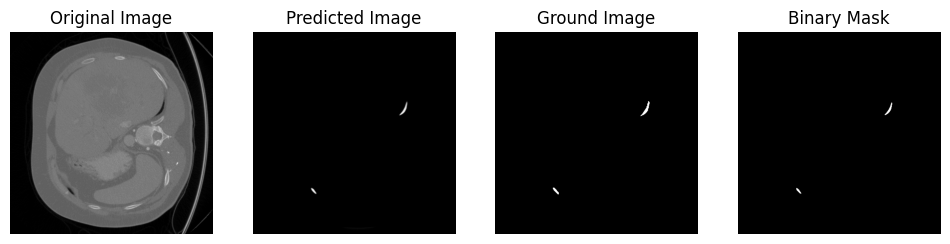

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.0113106369972229


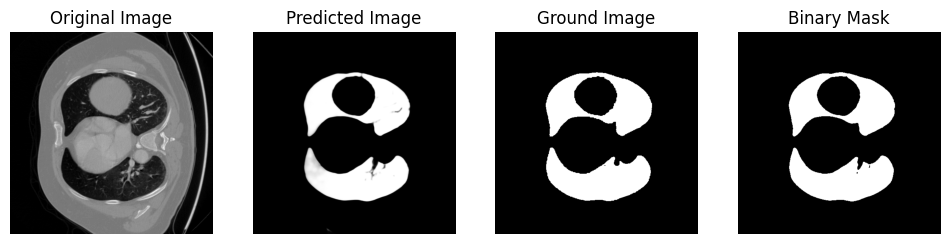

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.055259644985198975


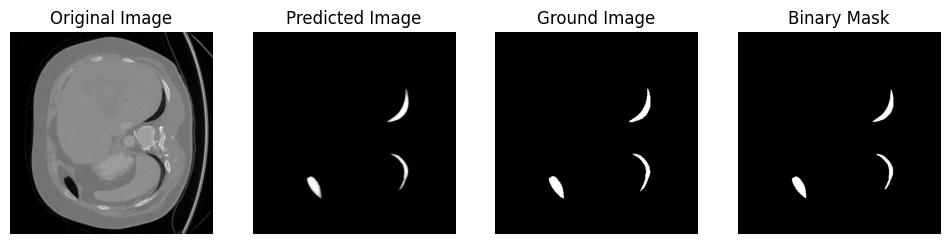

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.0122910737991333


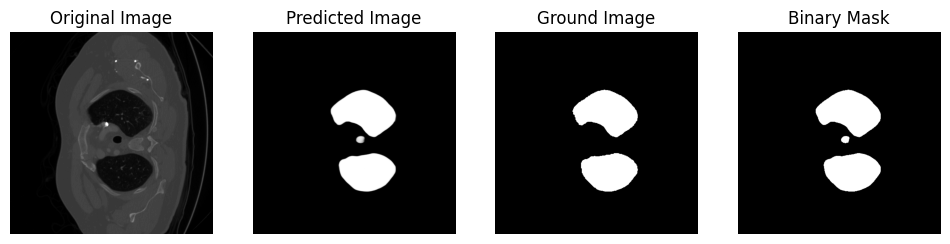

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.00782477855682373


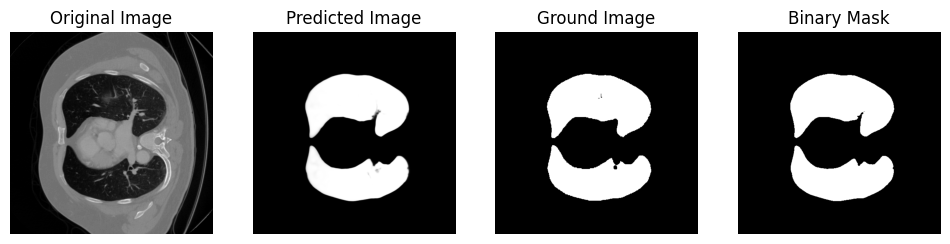

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.9999999889380531


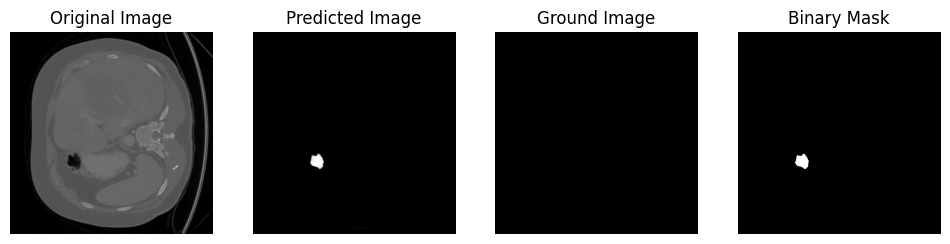

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.013931512832641602


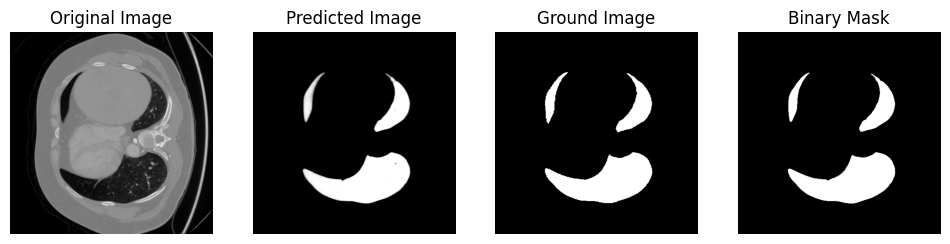

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.015798568725585938


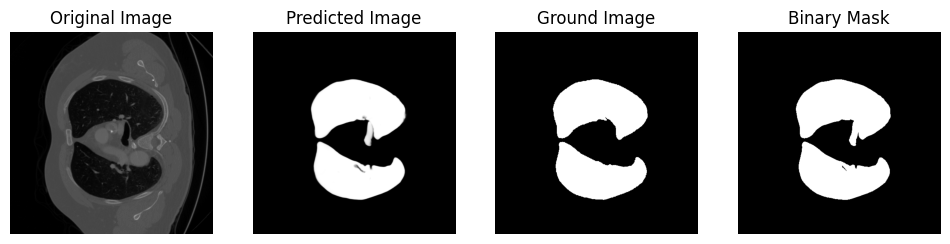

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.018495798110961914


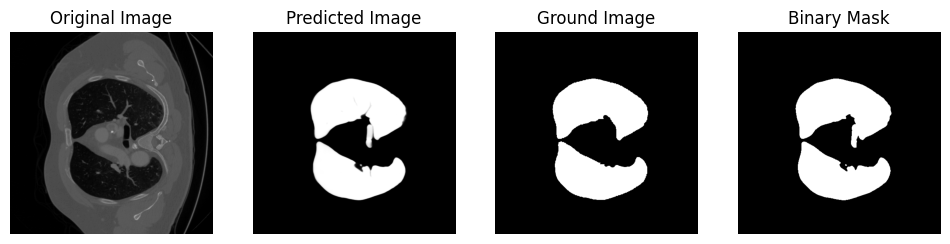

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.011908888816833496


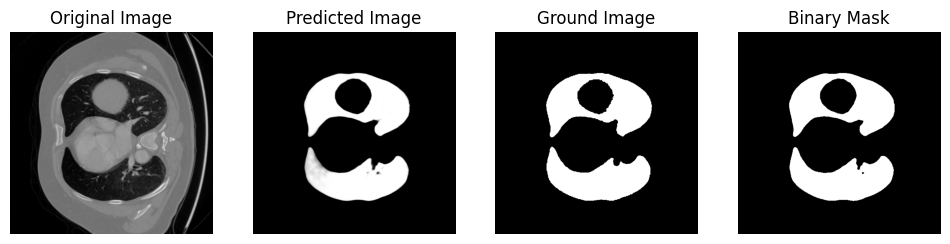

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.023794174194335938


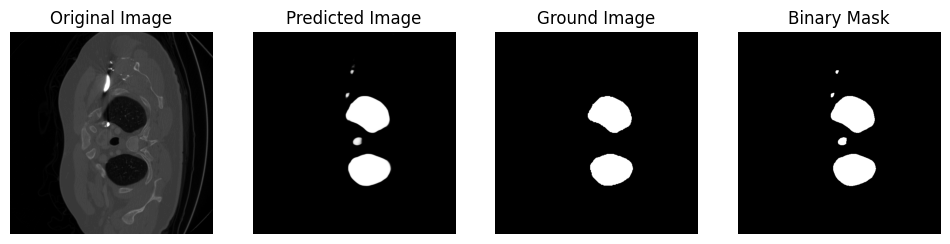

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.10876035690307617


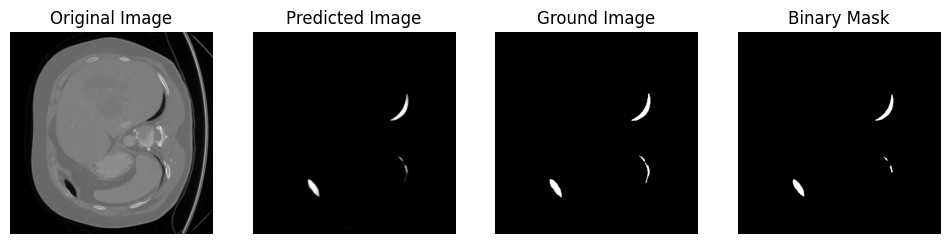

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.026736140251159668


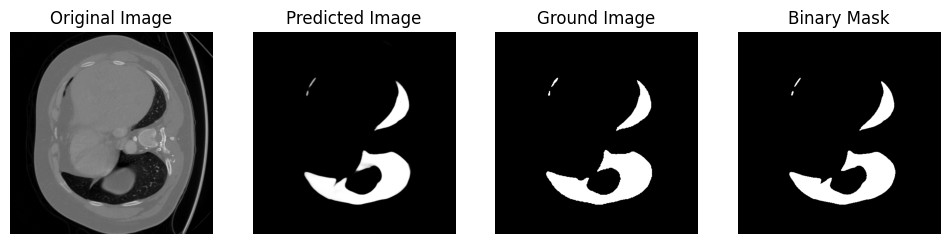

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.49584484100341797


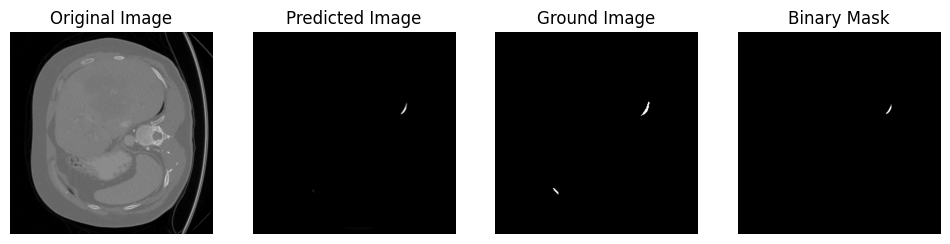

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.016465723514556885


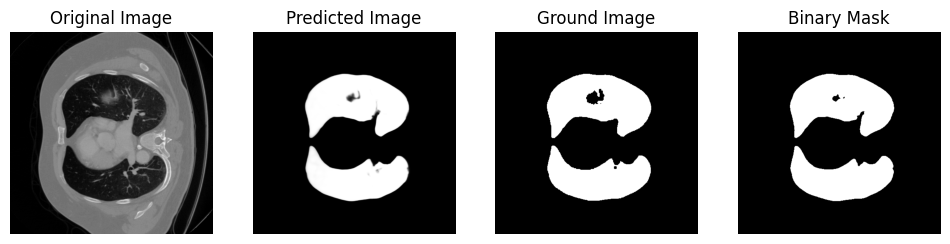

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.009579062461853027


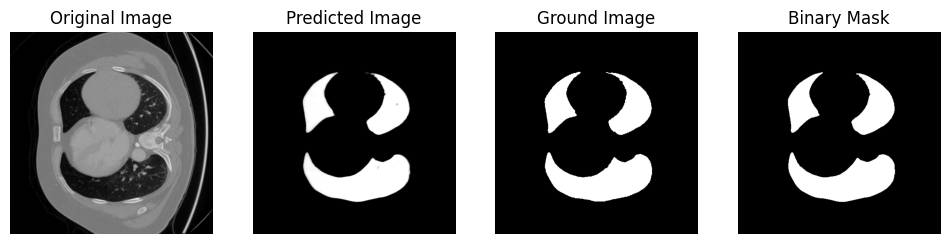

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.012417078018188477


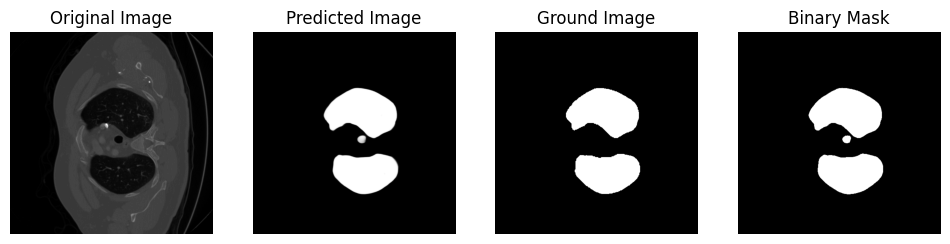

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.015040278434753418


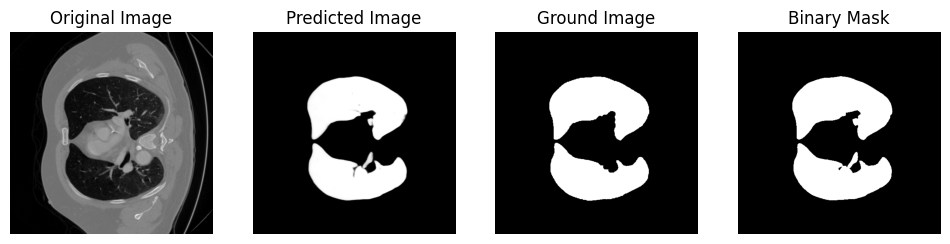

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.9999999881235153


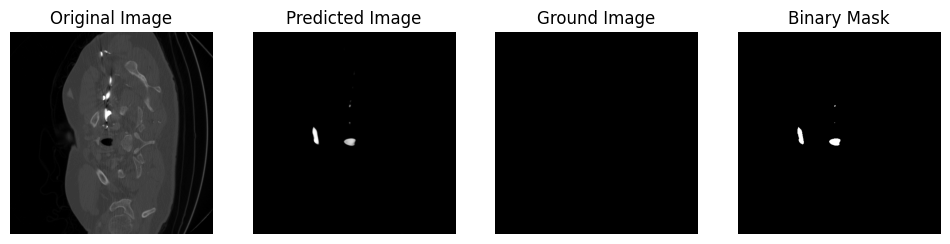

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.011743783950805664


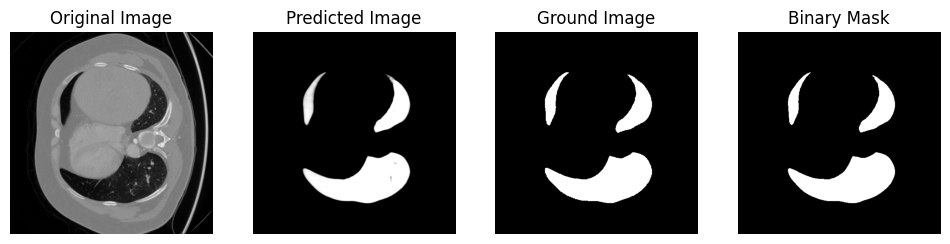

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.008867800235748291


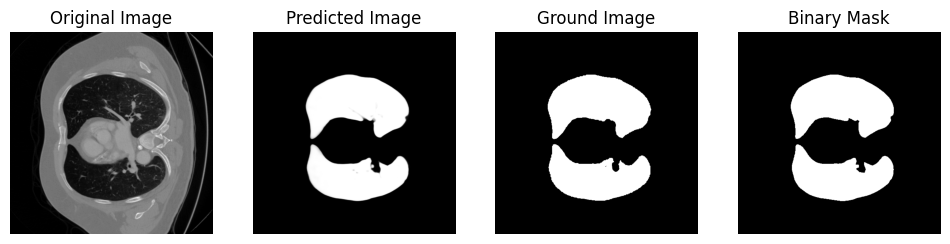

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.010899007320404053


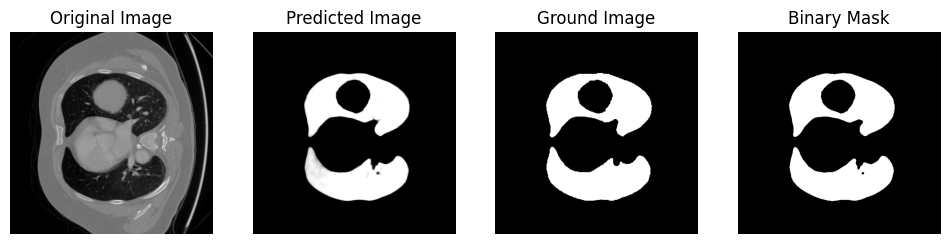

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.9999999315068564


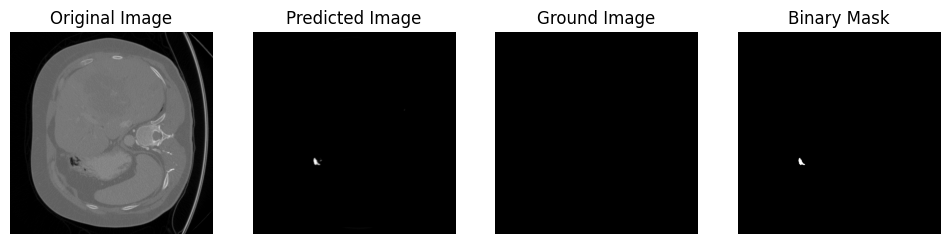

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.01108253002166748


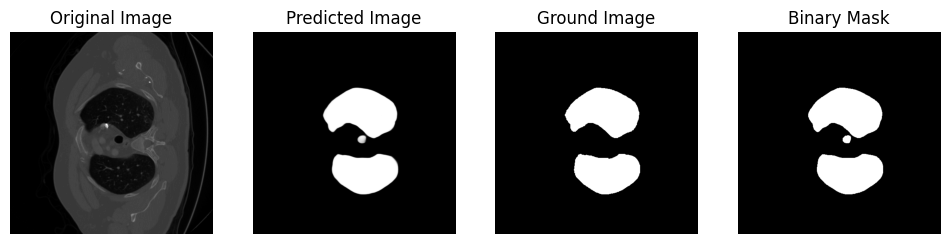

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.011225342750549316


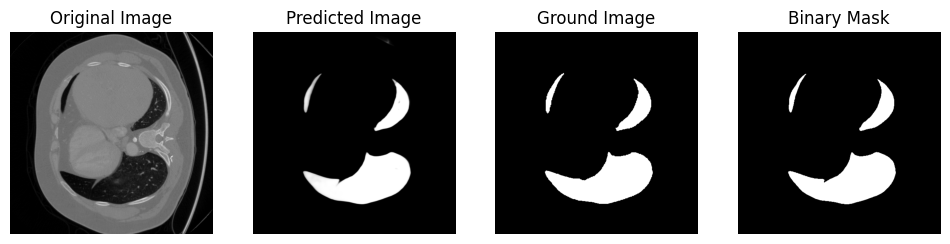

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.01458519697189331


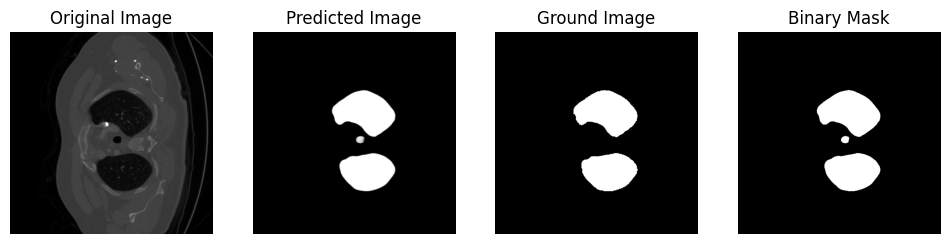

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.04300898313522339


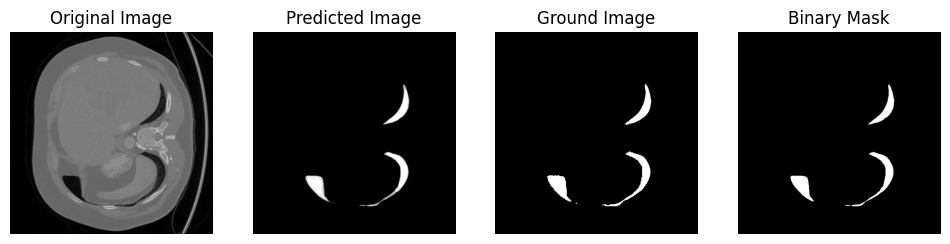

Prediction shape: (1, 1, 512, 512)
input_array shape: (1, 512, 512)
Dice : 0.013202548027038574


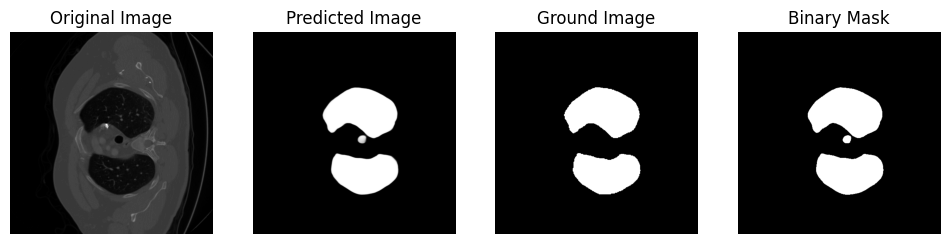

In [42]:

for i in range(1, len(lung_image_val)):
    # Example usage with a NumPy array
    input_array = lung_image_val[i]  # Replace with your actual input array
    ground_array = lung_label_val[i]  # Replace with your actual input array
    prediction = predict(model, input_array)

    # prediction = np.expand_dims(prediction, axis=0)
    input_array = np.expand_dims(input_array, axis=0)

    print("Prediction shape:", prediction.shape)
    print("input_array shape:", input_array.shape)

    # Convert to binary mask (assuming a threshold of 0.5)
    binary_mask = (prediction > 0.4).astype(np.uint8)
    print("Dice :", loss_dice(binary_mask, ground_array))

    # Plot the original image, ground truth, and predicted image
    plt.figure(figsize=(12, 4))

    # Original image
    plt.subplot(1, 4, 1)
    plt.imshow(input_array.squeeze(), cmap='gray')  # Use cmap='gray' for grayscale images
    plt.title('Original Image')
    plt.axis('off')

    # Predicted image
    plt.subplot(1, 4, 2)
    plt.imshow(prediction.squeeze(), cmap='gray')  # Use cmap='gray' for grayscale images
    plt.title('Predicted Image')
    plt.axis('off')

    # Ground image
    plt.subplot(1, 4, 3)
    plt.imshow(ground_array.squeeze(), cmap='gray')  # Use cmap='gray' for grayscale images
    plt.title('Ground Image')
    plt.axis('off')

    # Binary image
    plt.subplot(1, 4, 4)
    plt.imshow(binary_mask.squeeze(), cmap='gray')
    plt.title('Binary Mask')
    plt.axis('off')

    plt.show()


In [43]:
total = 0
for i in range(1, len(lung_image_val)):
    # Example usage with a NumPy array
    input_array = lung_image_val[i]  # Replace with your actual input array
    ground_array = lung_label_val[i]  # Replace with your actual input array
    prediction = predict(model, input_array)
    input_array = np.expand_dims(input_array, axis=0)
    binary_mask = (prediction > 0.4).astype(np.uint8)
    losss = loss_dice(binary_mask, ground_array)
    total += losss
    print("Dice :", losss)

print("Average Dice loss :", total/len(lung_image_val))


<ipython-input-39-825bcd3c7bd3>:21: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_flat = torch.tensor(target.flatten(), dtype=torch.float32)


Dice : 0.9999999923954377
Dice : 0.01781374216079712
Dice : 0.016263246536254883
Dice : 0.011561214923858643
Dice : 0.008844852447509766
Dice : 0.012594401836395264
Dice : 0.00844120979309082
Dice : 0.9999999901864571
Dice : 0.014799296855926514
Dice : 0.02823960781097412
Dice : 0.014198899269104004
Dice : 0.009372949600219727
Dice : 0.009693384170532227
Dice : 0.01021045446395874
Dice : 0.013796448707580566
Dice : 0.013164639472961426
Dice : 0.9999999698795179
Dice : 0.016266942024230957
Dice : 0.014776766300201416
Dice : 0.04642540216445923
Dice : 0.19349002838134766
Dice : 0.0113106369972229
Dice : 0.055259644985198975
Dice : 0.0122910737991333
Dice : 0.00782477855682373
Dice : 0.9999999889380531
Dice : 0.013931512832641602
Dice : 0.015798568725585938
Dice : 0.018495798110961914
Dice : 0.011908888816833496
Dice : 0.023794174194335938
Dice : 0.10876035690307617
Dice : 0.026736140251159668
Dice : 0.49584484100341797
Dice : 0.016465723514556885
Dice : 0.009579062461853027
Dice : 0.0124

INFERENCE FOR FINAL EVALUATION BY BIOCLIQ

LOAD MODEL

In [44]:
# def predict(model, input_array):
#     # Add batch dimension if needed
#     if len(input_array.shape) == 2:
#         input_array = input_array.unsqueeze(0)
#     # input_array = transform(input_array)
#     # mask = self.transform(target)
#     # Move the input tensor to the appropriate device
#     # input_tensor = input_array.to(device)

#     # Perform inference
#     with torch.no_grad():
#         model_output = model(input_array)

#     # Converingt the model output to probabilities (BCEWithLogitsLoss was used)
#     predicted_probs = torch.sigmoid(model_output)

#     return predicted_probs.cpu().numpy()

In [98]:
# model_temp = UNet(1,1)
# checkpoint = torch.load('/content/drive/MyDrive/lungs/lung_segmentation_model_unet_2.pth')
# model_temp.load_state_dict(checkpoint['model_state_dict'])

# opti = optim.Adam(model_temp.parameters(),learning_rate)
# opti.load_state_dict(checkpoint['optimizer_state_dict'])
# model_temp = model_temp.to(device)
# model.eval()

UNet(
  (inc): DoubleConv(
    (double_conv): Sequential(
      (0): Conv2d(1, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): ReLU(inplace=True)
    )
  )
  (down1): Down(
    (maxpool_conv): Sequential(
      (0): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (1): DoubleConv(
        (double_conv): Sequential(
          (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (2): ReLU(inplace=True)
          (3): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
 

In [65]:
# loading the pretrained model_temp

model_temp = UNet(1,1)
model_temp_path = '/content/drive/MyDrive/lungs/lung_segmentation_model_unet_temp.pth'
model_temp = model_temp.to(device)
model_temp_state_dict = torch.load(model_temp_path, map_location=torch.device('cuda'))
model_temp.load_state_dict(model_temp_state_dict)
model_temp.eval()

<All keys matched successfully>

In [102]:
import torch

def predict(model_temp, input_array):
    # Convert NumPy array to PyTorch tensor
    input_tensor = torch.from_numpy(input_array).float()

    # Add batch dimension if it's missing
    if len(input_tensor.shape) == 2:
        input_tensor = input_tensor.unsqueeze(0)

    # Move tensor to the appropriate device (CPU or GPU)
    input_tensor = input_tensor.to(device)

    # Perform inference
    with torch.no_grad():
        model_temp_output = model_temp(input_tensor)

    # Converting the model_temp output to probabilities (BCEWithLogitsLoss was used)
    probabilities = torch.sigmoid(model_temp_output)

    # Convert probabilities to a binary mask (assuming a threshold of 0.5)
    binary_mask = (probabilities > 0.4).float()

    # Convert the result back to a NumPy array
    binary_mask = binary_mask.cpu().numpy()

    return binary_mask


In [103]:
def inference(input_array, model_temp):
    # input_array = lung_image_val[i]
    # ground_array = lung_label_val[i]
    # model_temp = model_temp.to('cpu')
    input_array = np.expand_dims(input_array, axis=0)
    input_array = np.expand_dims(input_array, axis=1)


    prediction = predict(model_temp, input_array)
    binary_mask = (prediction > 0.4).astype(np.uint8)
    # print("Dice :", loss_dice(binary_mask, ground_array))

    # Plot the original image, ground truth, and predicted image
    plt.figure(figsize=(12, 4))

    # Original image
    plt.subplot(1, 2, 1)
    plt.imshow(input_array.squeeze(), cmap='gray')  # Use cmap='gray' for grayscale images
    plt.title('Original Image')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(binary_mask.squeeze(), cmap='gray')
    plt.title('Binary Mask')
    plt.axis('off')

    plt.show()

Generating validation dataset

In [ ]:
for i in range(0, len(files), 2):
    temp_file = files[i]
    label_path = os.path.join(folder_path_labelsTr, temp_file)
    a = temp_file.split('.nii.gz')
    image_path = folder_path_imagesTr + a[0] + "_0000.nii.gz"
    lung_image = nib.load(image_path).get_fdata()
    img_label = nib.load(label_path).get_fdata()

    for temp_file in files[i+1: i+2]:
        label_path = os.path.join(folder_path_labelsTr, temp_file)
        a = temp_file.split('.nii.gz')
        image_path = folder_path_imagesTr + a[0] + "_0000.nii.gz"
        img_label = np.concatenate((img_label, nib.load(label_path).get_fdata()), axis=2)
        lung_image = np.concatenate((lung_image, nib.load(image_path).get_fdata()), axis=2)

    img_label[img_label == 5] = 0
    lung_mask = np.logical_or(img_label == 3, img_label == 4)

    lung_image_train_temp = torch.from_numpy(lung_image).float()  # Input: Original MRI images
    lung_label_train_temp = torch.from_numpy(lung_mask).float()

    lung_image_train_temp = lung_image_train_temp.permute(2, 0, 1)
    lung_label_train_temp = lung_label_train_temp.permute(2, 0, 1)

    lung_image_train, lung_image_val, lung_label_train, lung_label_val = train_test_split(
        lung_image_train_temp, lung_label_train_temp, test_size=0.2, random_state=42)
    break

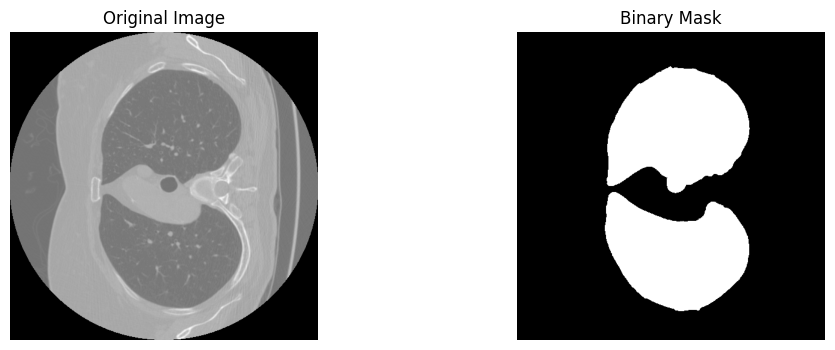

In [69]:
inference(lung_image_val[78], model)

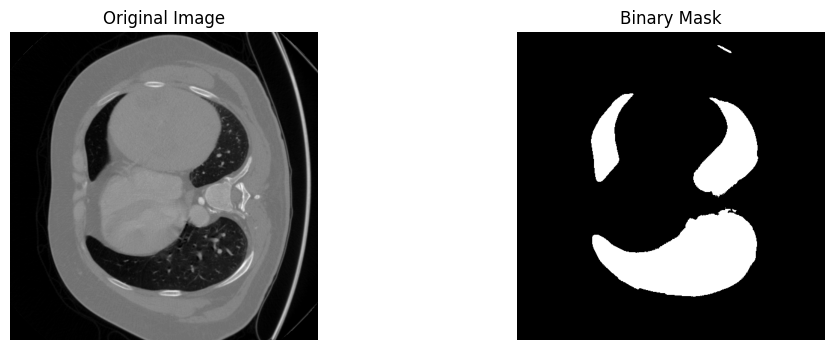

In [87]:
inference(lung_image_val[23], model)

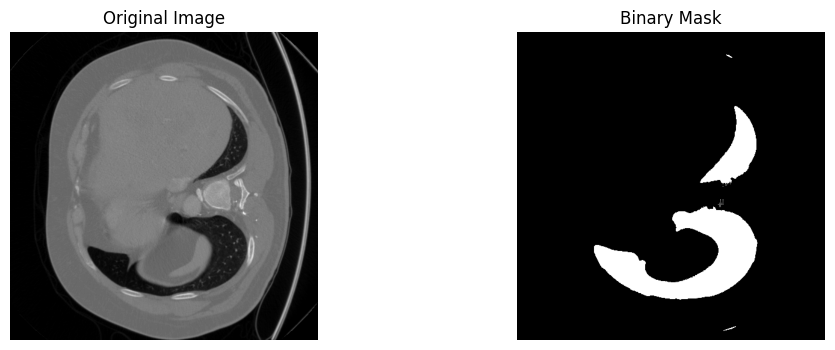

In [86]:
inference(lung_image_val[30], model)

Unet model's result are much much better as compared to previous small_model as it have more parameters, better structure and more capability to learn comple structures.